###Mount Google Drive
Mount Google Drive - where all nuScenes data and resulting run data will be strored

In [ ]:
#Need to mount my Google Drive
from google.colab import drive
drive.mount("/content/gdrive/")

Drive already mounted at /content/gdrive/; to attempt to forcibly remount, call drive.mount("/content/gdrive/", force_remount=True).


Set environment variable for path to nuScenes dataset

In [ ]:
%cd /content/gdrive/MyDrive/MScDissertation
import os
cwd = os.getcwd()
print("cwd:",cwd)
dataroot=os.path.join(cwd,'data/sets/nuscenes') #needed to remove / before data to make it work
print("dataroot (after joining)",dataroot)



# Add a new environment variable for the nuScenes path
os.environ['NUSCENES'] = dataroot

print("NUSCENES:", os.environ['NUSCENES'])

/content/gdrive/MyDrive/MScDissertation
cwd: /content/gdrive/MyDrive/MScDissertation
dataroot (after joining) /content/gdrive/MyDrive/MScDissertation/data/sets/nuscenes
NUSCENES: /content/gdrive/MyDrive/MScDissertation/data/sets/nuscenes


###Clone and pull code from Github repository

All code for this project is strored at [the following Github link](https://github.com/aokane001/Dissertation-repo). Clone this repository, pull in recent changes and change to the "src" directory which is the main sub-folder for code

In [ ]:
!git clone https://github.com/aokane001/Dissertation-repo

fatal: destination path 'Dissertation-repo' already exists and is not an empty directory.


In [ ]:
#NB Need to actuall change directory forst before pulling
%cd Dissertation-repo/
!git pull
#then switch to src - this is where most of the files we will want to run are
%cd src/

/content/gdrive/MyDrive/MScDissertation/Dissertation-repo
Already up to date.
/content/gdrive/MyDrive/MScDissertation/Dissertation-repo/src


###Import necessary packages

Import all python packages needed for this project, in particular nuScenes-devkit and efficientnet. Warnings can be ignored. Some minor errors related to matplotlib versions can be resolved by restarting the runtime and running all cells again.

In [ ]:
#pip installing all the other stuff we will need - that will be called by other files
!python3 -m pip install --upgrade pip
!pip install efficientnet_pytorch==0.7.0
!pip install torchvision torch tensorboardX
!pip install pyquaternion
import functools
!python3 -m pip install --upgrade Pillow
!pip install nuscenes-devkit &> /dev/null  # Install nuScenes.
#NB mpl_toolkits is not on PyPi so not installable by pip
#Since I have matplotlib already installed simply use the following command
import matplotlib
import mpl_toolkits
#NB Was getting several ShapelyDeprecation warnings - this is to help ignore them for now
import shapely
import warnings
from shapely.errors import ShapelyDeprecationWarning
warnings.filterwarnings("ignore", category=ShapelyDeprecationWarning)

###Set parameters that will be common accross several function calls

Rather than having to pass the same parameter values to several function calls, set them once here, then pass them to function calls below e.g. as decoder_mode = decoder_mode, once it is set here once (as it is a parameter that will change frequently between run setups).

In [ ]:
#NB - Seen as this is a parameter that will be changing frequently - better to set this here then pass it into function definitions and calls
decoder_mode = 5

#With TF Grid this is set as part of the config file - then when running the actual train file it is
#run by firing the main.py file which runs the train.py file and we specify the arguments to pass and point to the config file where the train label is set
#so it never actually gets explicitly passed in the train.py (on which we based train() below) - so I think that's why we need to set it explicitly here
train_label = 'drivable_area'

#Want to set the logdir here - this is what will actually be passed when we call the function below and pass logdir-logdir
#but in the function definition set the default to just be "./runs"
logdir='./runs'

version = "mini"
dataroot = os.environ["NUSCENES"]
#Use 60 epochs for full runs - as per TF Grid
nepochs = 60
#since only one GPU is available in Colab and we start counting from 0
gpuid = 0

#params related to data_aug_conf - i.e. related to data augmentation of camera images
H=900
W=1600
resize_lim=(0.193, 0.225)
final_dim=(128, 352)
bot_pct_lim=(0.0, 0.22)
rot_lim=(-5.4, 5.4)
rand_flip=True
ncams=5
max_grad_norm=5.0
pos_weight=2.13

#params related to grid_conf - i.e. grid configuration of final semantic grid - want this to be 200 x 200 cells i.e. -50m to 50m range in 0.5m intervals
xbound=[-50.0, 50.0, 0.5]
ybound=[-50.0, 50.0, 0.5]
zbound=[-10.0, 10.0, 20.0]
dbound=[4.0, 45.0,1.0] #this is D in literature of Lift Splat Shoot - range of distances

#params related to training function
bsz=2 #batch size
nworkers=2

lr = 1e-5 #learning rate
weight_decay = 1e-5 #weight_decay for L2 regularisation
num_classes = 1 #ultimately only training for 1 class at a time

#params related to PointPillars backbone
num_points = 100000
#NB - AS WE ARE training BASED ON MINI - PASS 34718 WHEN CALLING TRAIN
# trainval avg 34720  , mini avg 34718
n_points=34718

#As per TFGrid config files this was left as is - defined based on xbound, ybound so that grid sizes match up and allow for concatenation
#Comment and let this be passed wheb defining grid_conf
#pc_range= [xbound[0],ybound[0],-4,xbound[1],ybound[1],4]
#voxel_size = [xbound[2],ybound[2],8]

max_points_voxel = 100 #this is N in TF Grid literature
max_voxels = 10000 #this is P in TF Grid literature
input_features= 4 #four initial inputs - supplemented to get up to 9-dimensional within PointPillars block
use_norm = True #we do want to use BatchNorm
vfe_filters = [64] #this is effectively C=64 for PointPillars - controls number of channels
with_distance = False

#Will need to pass this as the place to store data for visualisations
img_save_dir = './runs/viz_model_preds/' #need '/' here so that file path is saved correctly when passing to savefig in viz_model_preds() below

#for lidar_check() below
show_lidar=True #want to see lidar scans
viz_train=False #set this to True to see data augmentation and visualise train data rather than val data

#for viz_model_preds below - or visualisation
map_folder = os.environ["NUSCENES"]

###Define train() function

In [ ]:
#import necessary packages and code from other scripts in Github repo
#the following command effectively mirrors the train.py script from TF Grid repo
import torch
import torch.nn.functional as F
from time import time
from tensorboardX import SummaryWriter
import numpy as np
import os

from models_Dropout_resnet_pretrained import compile_model #this will be model runs where Dropout and pretrained resnet blocks were added to combat overfitting
#from models_2T import compile_model #swapping out to see the model with 2 transformers - just to try understand how sizes work - how many channels I will need when concatenating
from data import compile_data
from tools import SimpleLoss, get_batch_iou, get_val_info,points_to_voxel_loop

#Define train() function
def train(
  train_label = train_label, #In TFGrid this isn't in the definition of train but really it is needed for compile_data that is called as part of it
                             #so it should be passed - in reality it seems the Fire part of main.py that calls the config file gets it from there - but it should be here
  version = version,
  dataroot = dataroot,
  nepochs = nepochs, #60 for full runs
  gpuid = gpuid,

  H = H,
  W = W,
  resize_lim = resize_lim,
  final_dim = final_dim,
  bot_pct_lim = bot_pct_lim,
  rot_lim = rot_lim,
  rand_flip = rand_flip,
  ncams = ncams,
  max_grad_norm = max_grad_norm,
  pos_weight = pos_weight,
  logdir = logdir,
  xbound = xbound,
  ybound = ybound,
  zbound = zbound,
  dbound = dbound,
  decoder_mode = decoder_mode,

  bsz = bsz,
  nworkers = nworkers,
  lr = lr,
  weight_decay = weight_decay,
  num_classes = num_classes,
  num_points = num_points,
  n_points = n_points,

  max_points_voxel = max_points_voxel,
  max_voxels = max_voxels,
  input_features= input_features,
  use_norm = use_norm,
  vfe_filters = vfe_filters,
  with_distance = with_distance
  ):

  #The following dicts are then defined based on passed params
  grid_conf = {
    'xbound': xbound,
    'ybound': ybound,
    'zbound': zbound,
    'dbound': dbound,
    'decoder_mode':decoder_mode #new parameter for decoder_mode to be passed as part of grid_conf
  }

  data_aug_conf = {
    'resize_lim': resize_lim,
    'final_dim': final_dim,
    'rot_lim': rot_lim,
    'H': H, 'W': W,
    'rand_flip': rand_flip,
    'bot_pct_lim': bot_pct_lim,
    'cams': ['CAM_FRONT_LEFT', 'CAM_FRONT', 'CAM_FRONT_RIGHT','CAM_BACK_LEFT', 'CAM_BACK', 'CAM_BACK_RIGHT'],
    'Ncams': ncams,
  }

  cfg_pp = {
    'num_classes':num_classes,
    'num_points': num_points,
    'pc_range': [xbound[0],ybound[0],-4,xbound[1],ybound[1],4], #NB-define this based on xbound, ybound so grid sizes will match
    'voxel_size' : [xbound[2],ybound[2],8], #NB-define this based on xbound, ybound so grid sizes will match
    'max_points_voxel' : max_points_voxel,
    'max_voxels': max_voxels,
    'input_features': input_features,
    'batch_size': bsz,
    'use_norm': use_norm,
    'vfe_filters': vfe_filters,
    'with_distance': with_distance,
    'n_points': n_points,
  }

  print('Loading data ...')
  #Had to change the way this is called slightly - it is strange, in train.py in TFGrid - it passes n_points and pc_range explicitly but this isn't how it is defined in models.py
  trainloader, valloader = compile_data(version, dataroot, data_aug_conf=data_aug_conf,
                                          grid_conf=grid_conf, bsz=bsz, nworkers=nworkers,
                                          parser_name='segmentationdata',cfg_pp=cfg_pp, train_label=train_label) #other paraemeter - cond, dist, rank, sw can be left as default

  device = torch.device('cpu') if gpuid < 0 else torch.device(f'cuda:{gpuid}')
  print('Compiling model ...')
  model = compile_model(grid_conf, data_aug_conf, outC=1, cfg_pp=cfg_pp) ### outC number of output channels
  model.to(device)
  opt = torch.optim.Adam(model.parameters(), lr=lr, weight_decay=weight_decay)
  loss_fn = SimpleLoss(pos_weight).cuda(gpuid)
  writer = SummaryWriter(logdir=logdir)
  val_step = 500 if version == 'mini' else 5000
  model.train()
  counter = 0
  print('Starting training ...')
  for epoch in range(nepochs):
      print(f"Epoch: {epoch+1}/{nepochs}") #NOTE - ACTUAL VALUE OF epoch WILL START COUNTING FROM 0 - THIS IS JUST FOR CONVENIENCE OF READING OUTPUT TO START FROM 1
      np.random.seed()
      for batchi, (imgs, rots, trans, intrins, post_rots, post_trans, binimgs, points) in enumerate(trainloader):
          t0 = time()
          opt.zero_grad()
          voxels, coors, num_points = points_to_voxel_loop(points, cfg_pp)
          preds = model(imgs.to(device),
                  rots.to(device),
                  trans.to(device),
                  intrins.to(device),
                  post_rots.to(device),
                  post_trans.to(device),
                  voxels.to(device),
                  coors.to(device),
                  num_points.to(device),
                  )

          binimgs = binimgs.to(device)
          loss = loss_fn(preds, binimgs)
          loss.backward()
          torch.nn.utils.clip_grad_norm_(model.parameters(), max_grad_norm)
          opt.step()
          counter += 1
          t1 = time()
          if counter % 10 == 0:
              print(counter, loss.item())
              writer.add_scalar('train/loss', loss, counter)
          if counter % 50 == 0:
              intersection, union, iou = get_batch_iou(preds, binimgs)
              writer.add_scalar('train/iou', iou, counter)
              writer.add_scalar('train/epoch', epoch, counter)
              writer.add_scalar('train/step_time', t1 - t0, counter)
          if counter % val_step == 0:
              val_info = get_val_info(model, valloader, loss_fn, device, cfg_pp=cfg_pp,grid_conf=grid_conf, use_tqdm= True)
              print('VAL', val_info)
              writer.add_scalar('val/loss', val_info['loss'], counter)
              writer.add_scalar('val/iou', val_info['iou'], counter)
          if counter % val_step == 0:
              model.eval()
              mname = os.path.join(logdir, "model{}.pt".format(counter)) #NB This is the location-same runs/ directory where summary will be saved
                                                                         #where the model will also be saved every val_step=500 number of training steps
              print('saving ... ', mname)
              torch.save({
              'epoch': epoch,
              'model_state_dict': model.state_dict(),
              'optimizer_state_dict': opt.state_dict(),
              'loss': loss,
              'counter':counter
              }, mname)
              model.train()


###Now we want to actually call train() to commence training

Loading data ...
Getting all samples
Getting all samples
Compiling model ...
xs shape:  torch.Size([41, 8, 22])
ys shape:  torch.Size([41, 8, 22])


Downloading: "https://github.com/lukemelas/EfficientNet-PyTorch/releases/download/1.0/efficientnet-b0-355c32eb.pth" to /root/.cache/torch/hub/checkpoints/efficientnet-b0-355c32eb.pth
100%|██████████| 20.4M/20.4M [00:00<00:00, 79.7MB/s]
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loaded pretrained weights for efficientnet-b0


Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 89.3MB/s]
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet34-b627a593.pth" to /root/.cache/torch/hub/checkpoints/resnet34-b627a593.pth
100%|██████████| 83.3M/83.3M [00:00<00:00, 167MB/s]
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior

Starting training ...
Epoch: 1/60
10 1.08672297000885
20 0.8513626456260681
30 0.8938484191894531
40 0.7203354239463806
50 0.9225944876670837
60 0.844225287437439
70 0.6981591582298279
80 0.6604194045066833
90 0.6149697303771973
100 0.9717370867729187
110 0.6128913164138794
120 0.6500351428985596
130 0.6661794781684875
140 1.2120743989944458
150 0.6949009299278259
160 0.8924059271812439
Epoch: 2/60
170 0.5586838722229004
180 0.6726978421211243
190 0.712646484375
200 0.6575592756271362
210 0.9197600483894348
220 0.614490270614624
230 0.5739380717277527
240 0.566175103187561
250 0.46298572421073914
260 0.4390734136104584
270 0.47870102524757385
280 0.6206010580062866
290 0.8403159976005554
300 0.6741719841957092
310 0.5202843546867371
320 0.5747911930084229
Epoch: 3/60
330 0.6194236874580383
340 0.4475620985031128
350 0.6489870548248291
360 0.48243942856788635
370 0.44591689109802246
380 0.47195419669151306
390 0.9263818264007568
400 0.4773622453212738
410 0.43577805161476135
420 0.49912

  0%|          | 0/40 [00:00<?, ?it/s]/content/gdrive/MyDrive/MScDissertation/Dissertation-repo/src/tools.py:113: UserWarning: The use of `x.T` on tensors of dimension other than 2 to reverse their shape is deprecated and it will throw an error in a future release. Consider `x.mT` to transpose batches of matrices or `x.permute(*torch.arange(x.ndim - 1, -1, -1))` to reverse the dimensions of a tensor. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3571.)
  ax2.imshow(ndimage.rotate(cv2.flip(np.array(binimgs[j].T),0), -90, reshape=False), vmin=0, vmax=1, cmap='Blues')


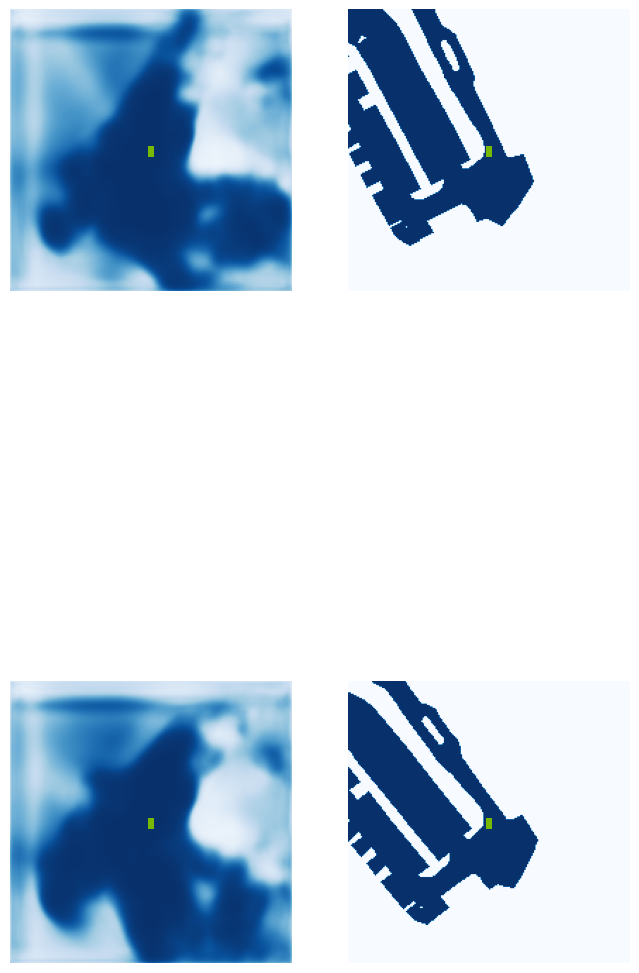

  5%|▌         | 2/40 [00:08<02:14,  3.55s/it]

Image saved! ... ./runs/get_val_info/0-iou-0.30.jpg


 12%|█▎        | 5/40 [00:21<02:28,  4.25s/it]

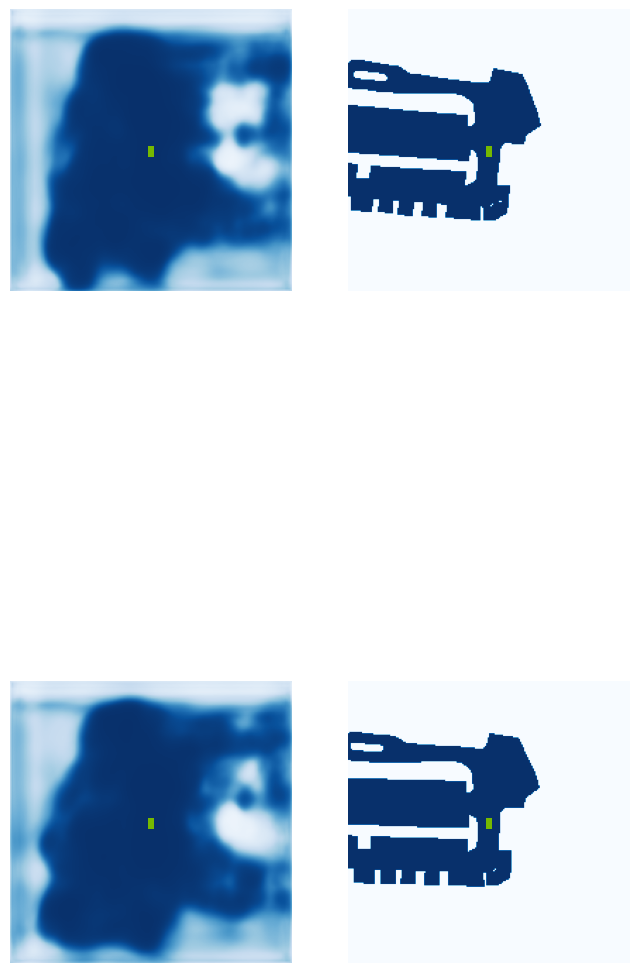

 15%|█▌        | 6/40 [00:22<01:44,  3.06s/it]

Image saved! ... ./runs/get_val_info/5-iou-0.27.jpg


 25%|██▌       | 10/40 [00:34<01:22,  2.76s/it]

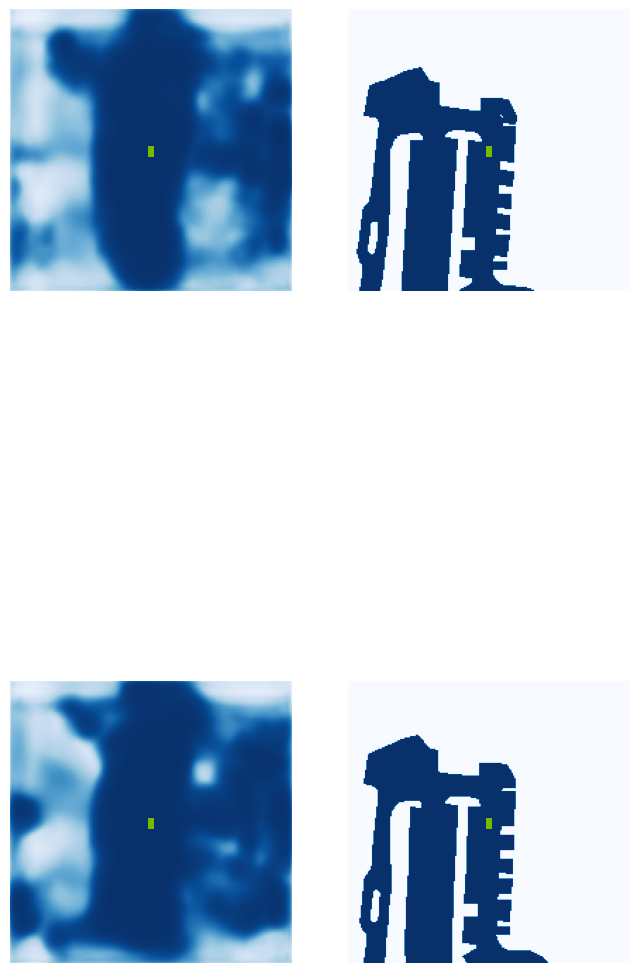

 30%|███       | 12/40 [00:41<01:19,  2.84s/it]

Image saved! ... ./runs/get_val_info/10-iou-0.27.jpg


 38%|███▊      | 15/40 [00:54<01:36,  3.85s/it]

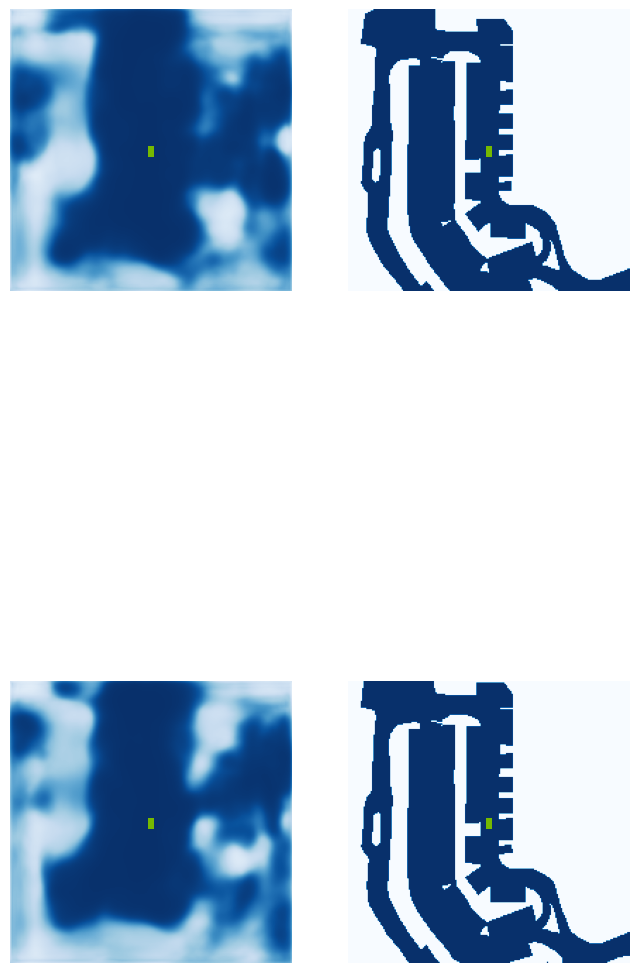

 40%|████      | 16/40 [00:55<01:07,  2.81s/it]

Image saved! ... ./runs/get_val_info/15-iou-0.37.jpg


 50%|█████     | 20/40 [01:08<00:55,  2.79s/it]

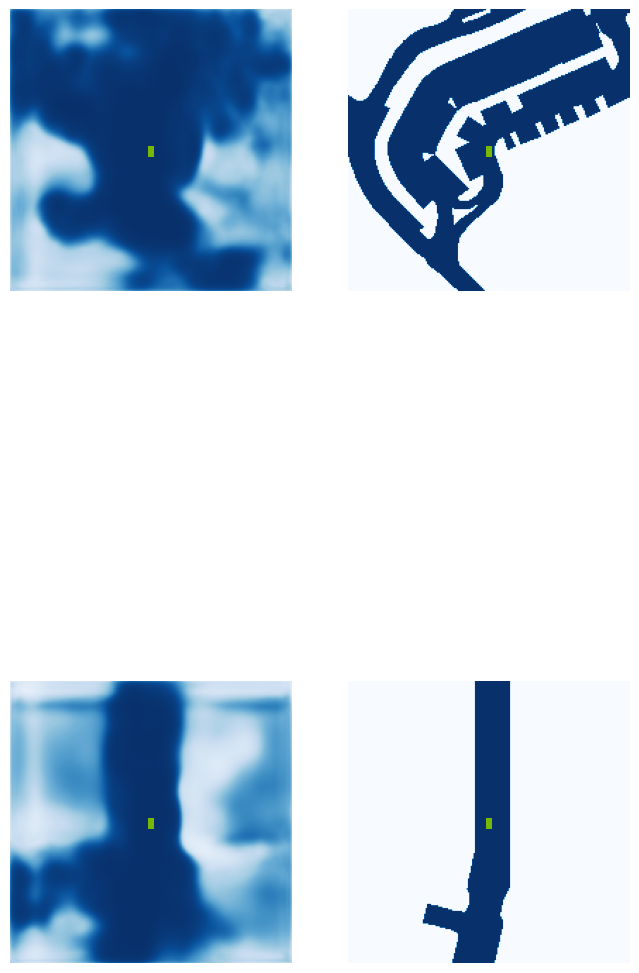

 55%|█████▌    | 22/40 [01:15<00:52,  2.93s/it]

Image saved! ... ./runs/get_val_info/20-iou-0.35.jpg


 62%|██████▎   | 25/40 [01:28<00:58,  3.92s/it]

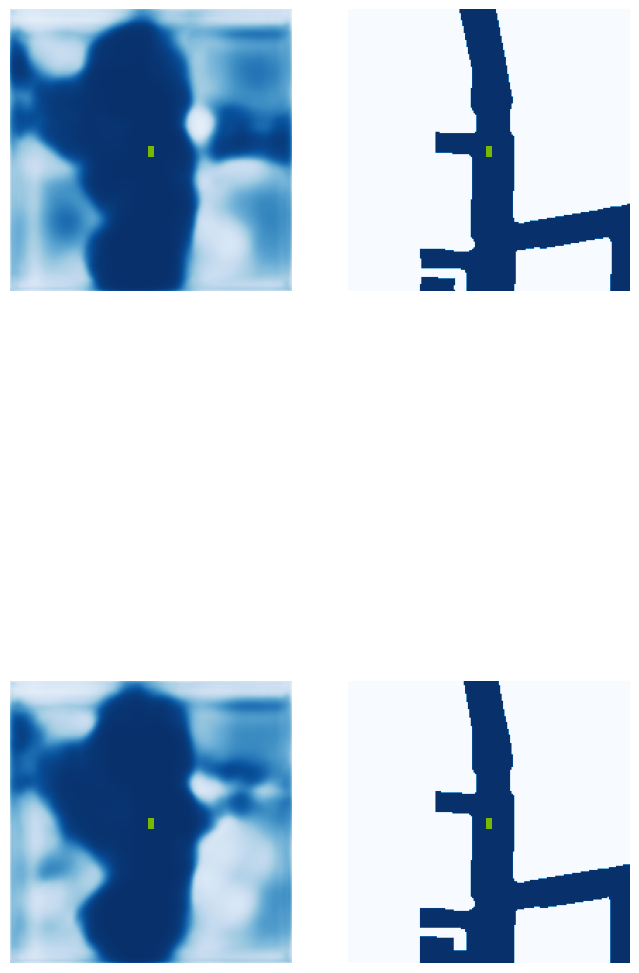

 65%|██████▌   | 26/40 [01:29<00:40,  2.87s/it]

Image saved! ... ./runs/get_val_info/25-iou-0.29.jpg


 75%|███████▌  | 30/40 [01:42<00:27,  2.70s/it]

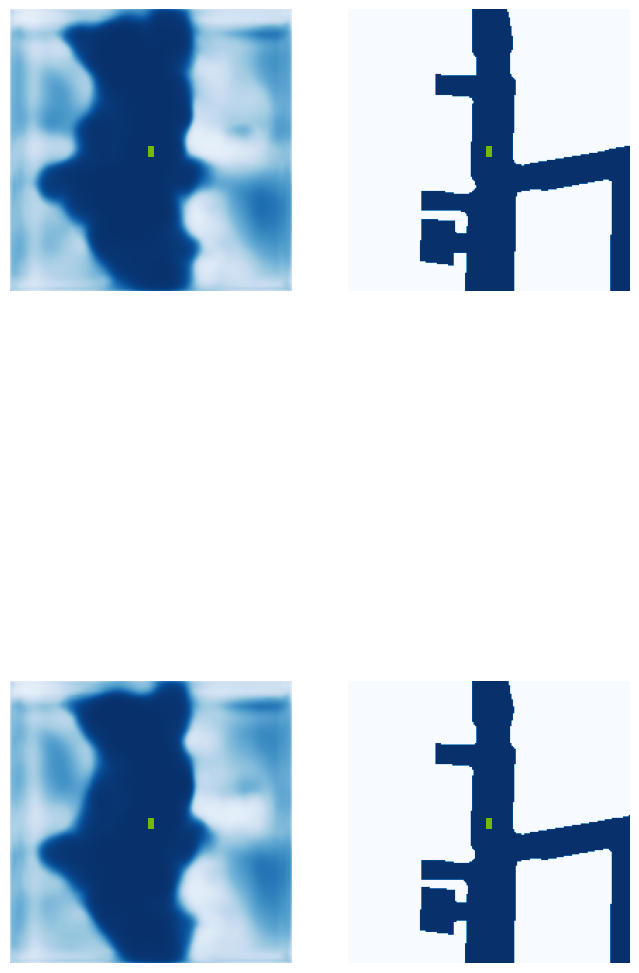

 80%|████████  | 32/40 [01:49<00:22,  2.82s/it]

Image saved! ... ./runs/get_val_info/30-iou-0.40.jpg


 88%|████████▊ | 35/40 [02:01<00:18,  3.69s/it]

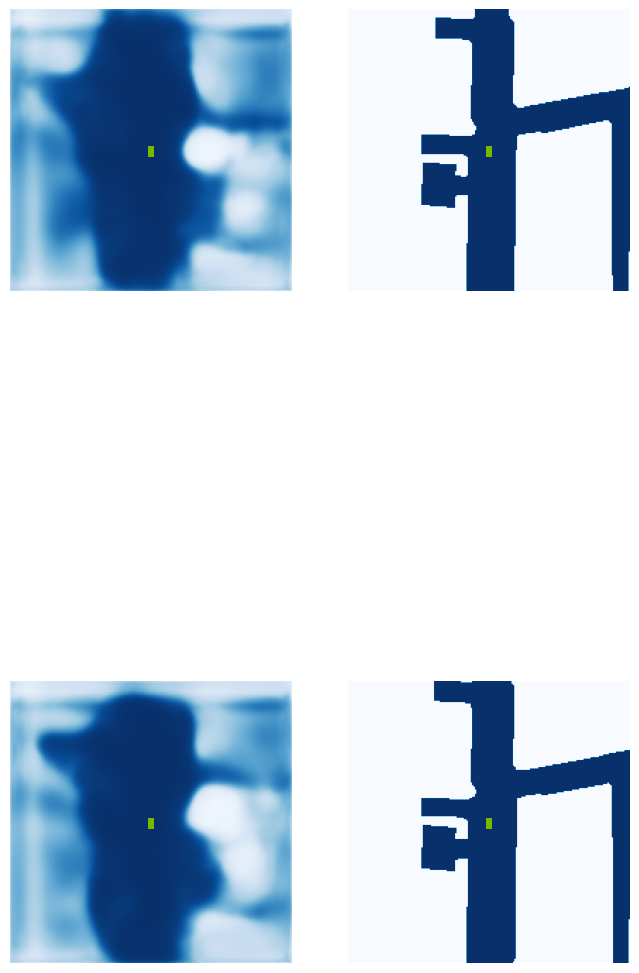

 90%|█████████ | 36/40 [02:01<00:11,  2.77s/it]

Image saved! ... ./runs/get_val_info/35-iou-0.39.jpg


100%|██████████| 40/40 [02:14<00:00,  3.36s/it]


VAL {'loss': 1.3309038921638772, 'iou': 0.33748304315817057}
saving ...  ./runs/model500.pt
510 0.4706073999404907
520 0.6832998394966125
530 0.6391116976737976
540 0.36973515152931213
550 0.373801589012146
560 0.6058952808380127
570 0.5848404169082642
580 0.465369313955307
590 0.5549191236495972
600 0.4810032546520233
610 0.38455715775489807
620 1.0017292499542236
630 0.5019926428794861
640 0.454440712928772
Epoch: 5/60
650 0.377083420753479
660 0.5257341265678406
670 0.4104265570640564
680 0.3691197335720062
690 0.5059229135513306
700 0.41005903482437134
710 0.44758719205856323
720 0.44421443343162537
730 0.6250972151756287
740 0.3972074091434479
750 0.5207965970039368
760 0.49228909611701965
770 0.42713645100593567
780 0.3555779755115509
790 0.425859659910202
800 0.527641773223877
Epoch: 6/60
810 0.3582906723022461
820 0.4211152195930481
830 0.32595282793045044
840 0.40530312061309814
850 0.38167375326156616
860 0.3621140718460083
870 0.44463494420051575
880 0.4245207905769348
890 0

  0%|          | 0/40 [00:00<?, ?it/s]

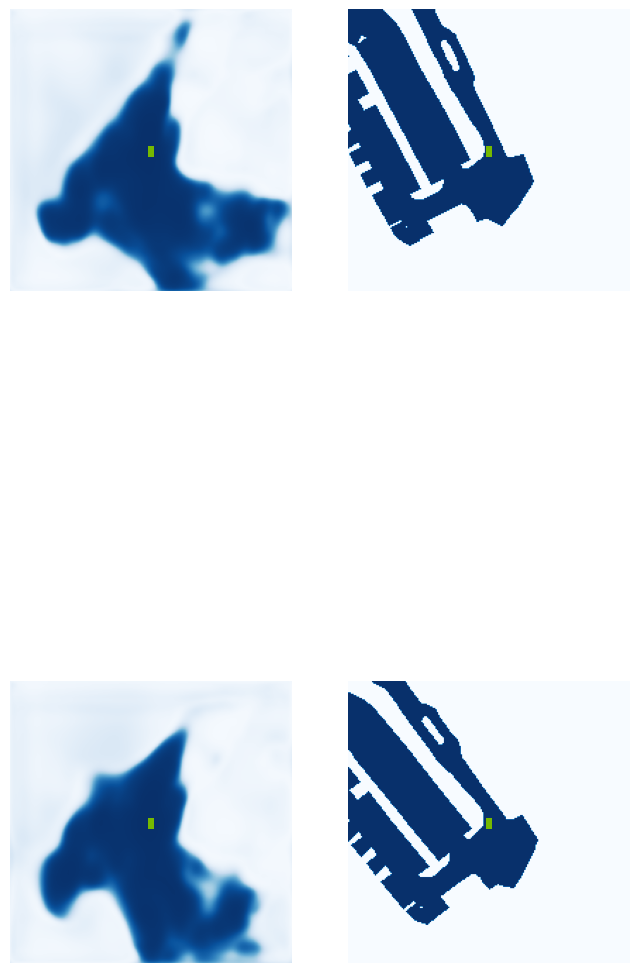

  5%|▌         | 2/40 [00:01<00:20,  1.89it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.26.jpg


 12%|█▎        | 5/40 [00:01<00:08,  4.20it/s]

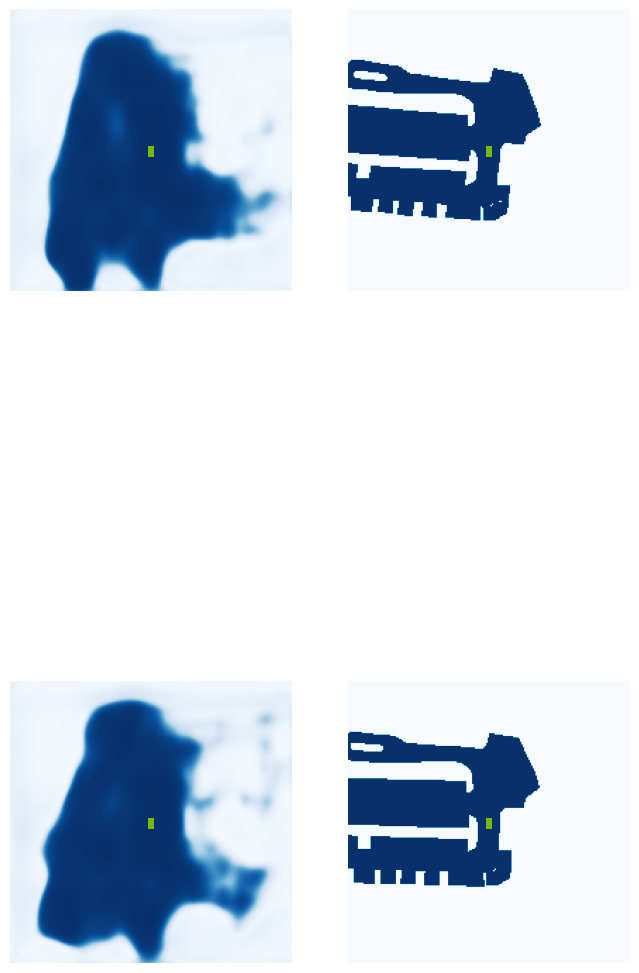

 18%|█▊        | 7/40 [00:02<00:08,  4.10it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.36.jpg


 25%|██▌       | 10/40 [00:02<00:05,  5.20it/s]

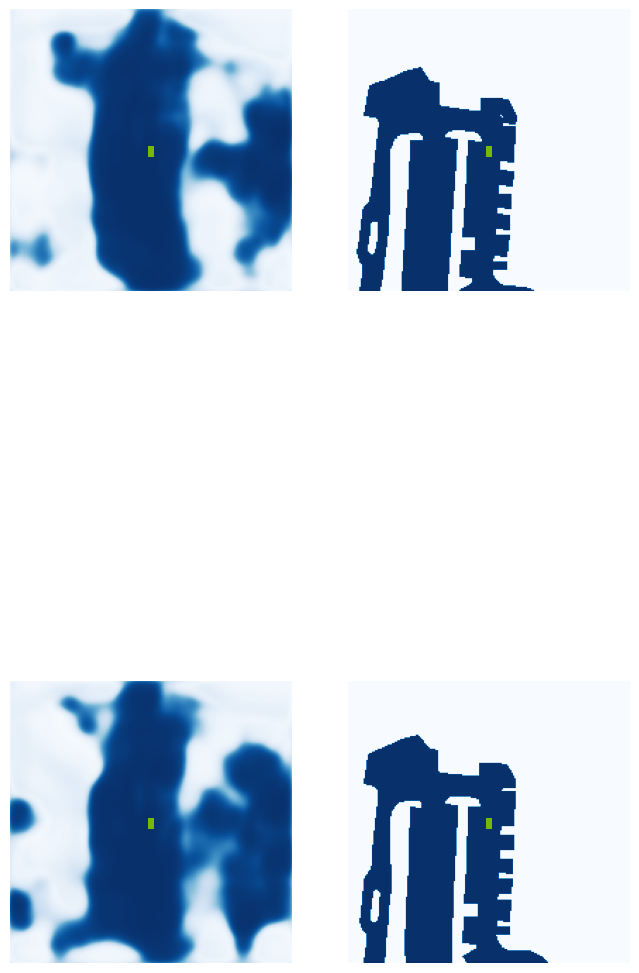

 30%|███       | 12/40 [00:03<00:07,  3.81it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.27.jpg


 38%|███▊      | 15/40 [00:03<00:05,  4.92it/s]

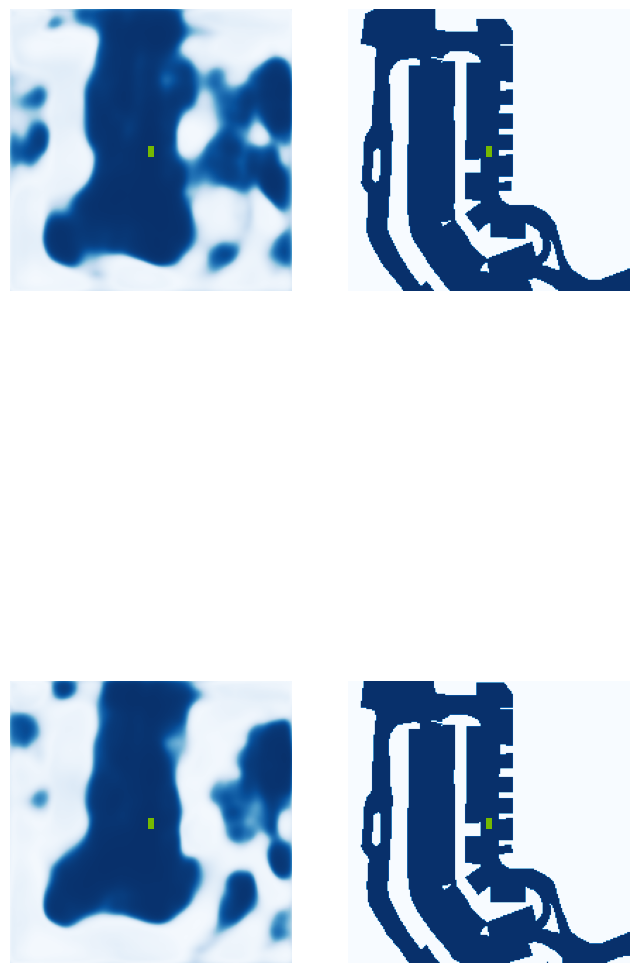

 42%|████▎     | 17/40 [00:04<00:06,  3.31it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.35.jpg


 50%|█████     | 20/40 [00:05<00:03,  5.70it/s]

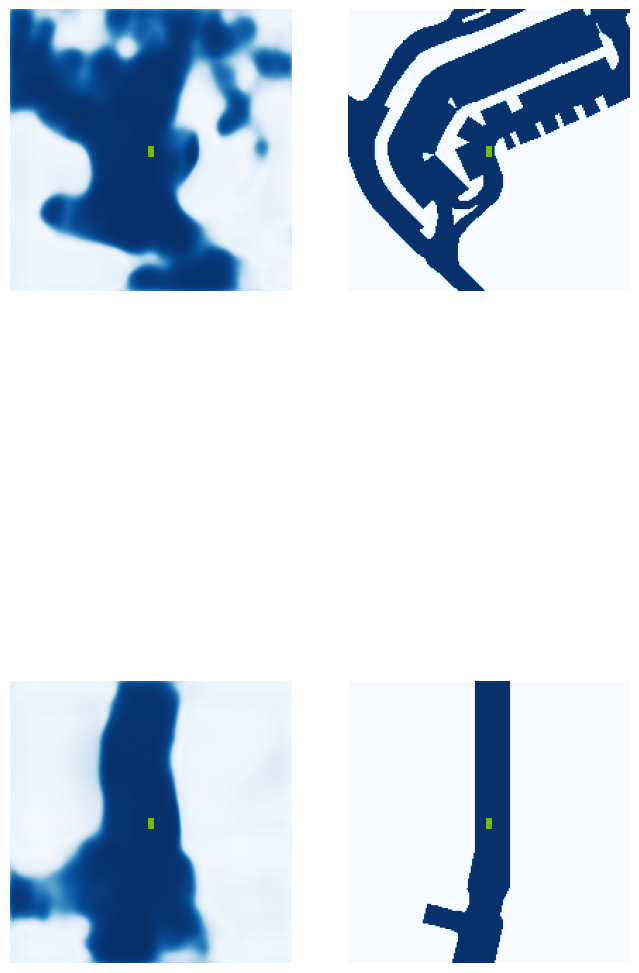

 55%|█████▌    | 22/40 [00:05<00:03,  4.78it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.40.jpg


 62%|██████▎   | 25/40 [00:06<00:02,  6.47it/s]

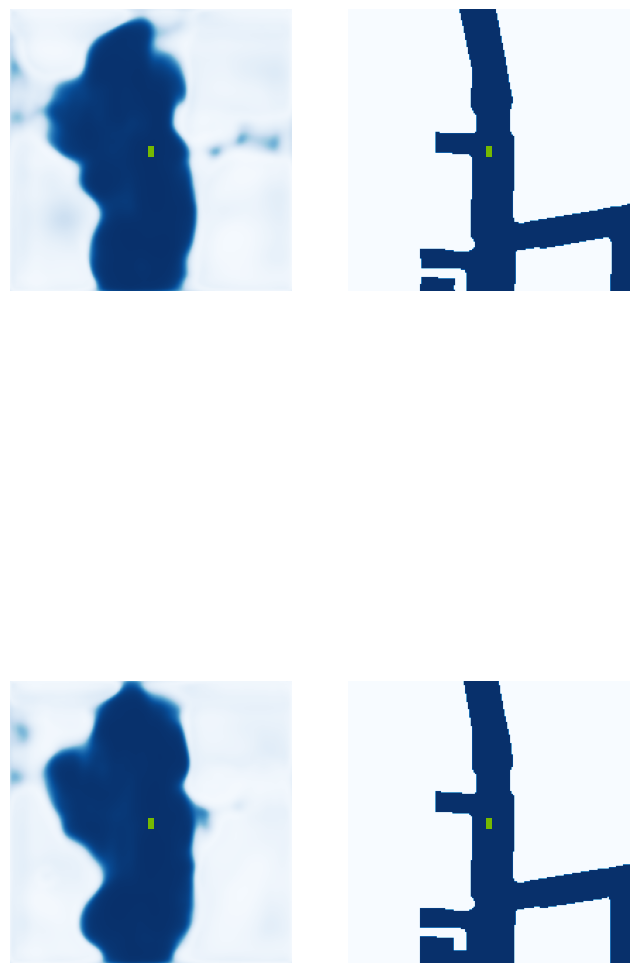

 68%|██████▊   | 27/40 [00:06<00:02,  5.32it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.40.jpg


 72%|███████▎  | 29/40 [00:06<00:01,  6.01it/s]

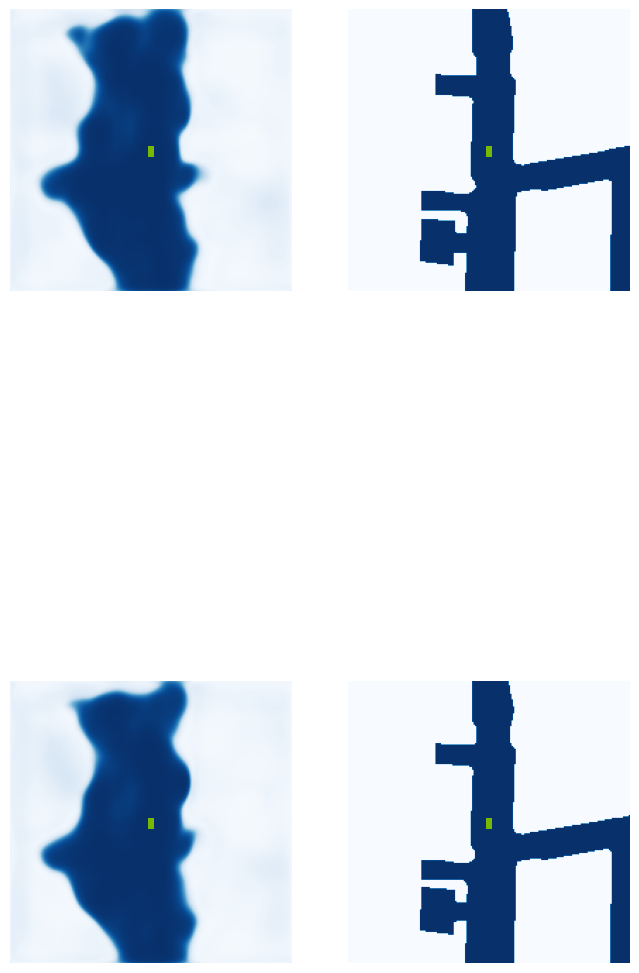

 80%|████████  | 32/40 [00:07<00:01,  4.70it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.45.jpg


 88%|████████▊ | 35/40 [00:08<00:00,  6.54it/s]

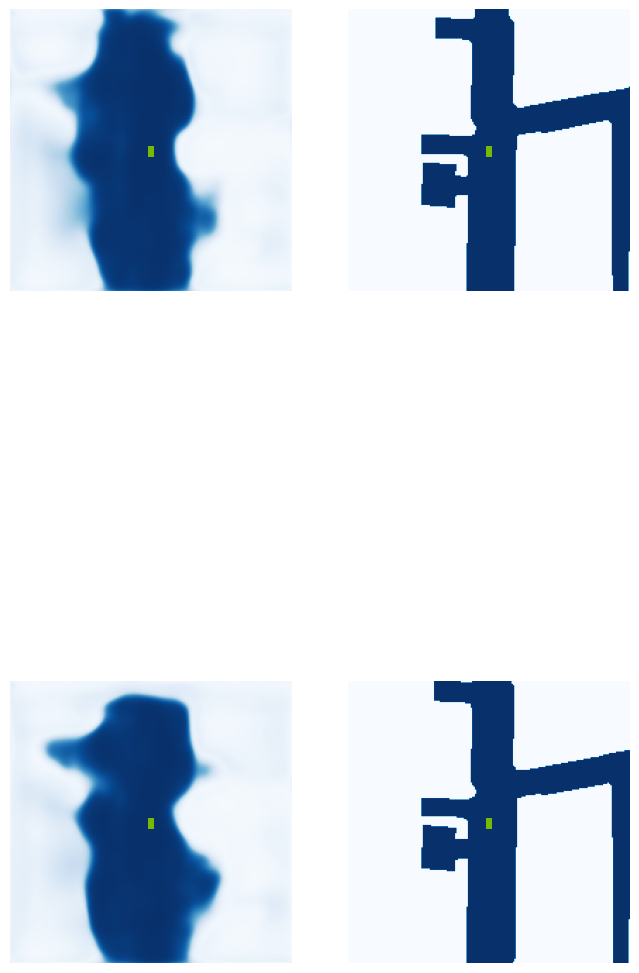

 92%|█████████▎| 37/40 [00:08<00:00,  5.17it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.43.jpg


100%|██████████| 40/40 [00:08<00:00,  4.46it/s]


VAL {'loss': 1.2639629090273823, 'iou': 0.3749177520130444}
saving ...  ./runs/model1000.pt
1010 0.33820003271102905
1020 0.6622504591941833
1030 0.41290780901908875
1040 0.2887745797634125
1050 0.5735758543014526
1060 0.5534476637840271
1070 0.8254388570785522
1080 0.4436987638473511
1090 0.5078808069229126
1100 0.39275509119033813
1110 0.3874308466911316
1120 0.45483073592185974
Epoch: 8/60
1130 0.363040030002594
1140 0.6286318302154541
1150 0.3172309398651123
1160 0.4922037422657013
1170 0.41113680601119995
1180 0.3117932081222534
1190 0.49294036626815796
1200 0.48161581158638
1210 0.3090033233165741
1220 0.3492618203163147
1230 0.3006838858127594
1240 0.6461865305900574
1250 0.3961605429649353
1260 0.6376773715019226
1270 0.5317596793174744
1280 0.4096616506576538
Epoch: 9/60
1290 0.3656809329986572
1300 0.268352746963501
1310 0.29040995240211487
1320 0.2927262485027313
1330 0.8595772385597229
1340 0.4148770272731781
1350 0.36465445160865784
1360 0.28529849648475647
1370 0.27752512

  0%|          | 0/40 [00:00<?, ?it/s]

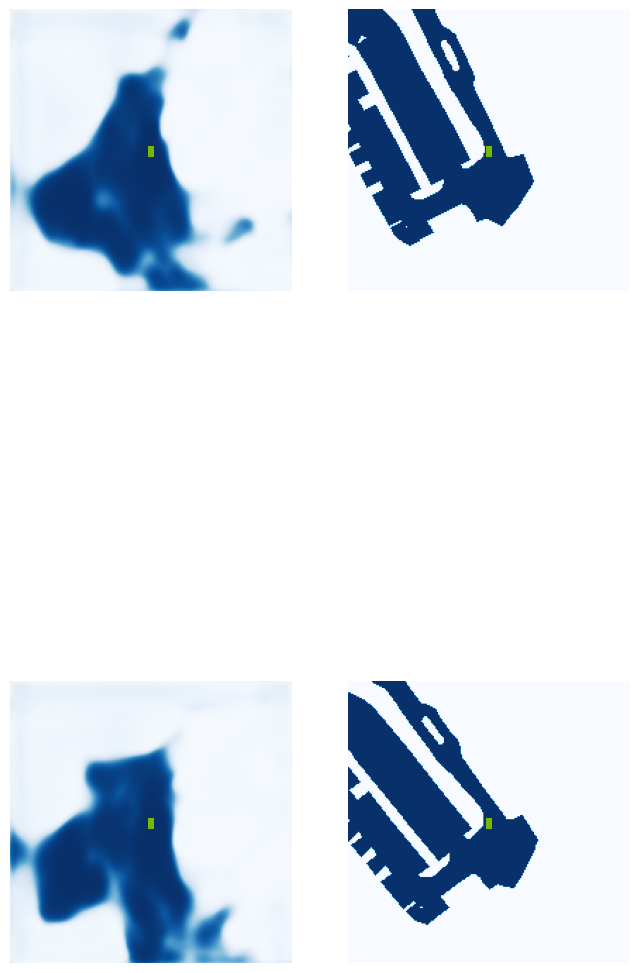

  5%|▌         | 2/40 [00:01<00:20,  1.88it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.32.jpg


 12%|█▎        | 5/40 [00:01<00:09,  3.77it/s]

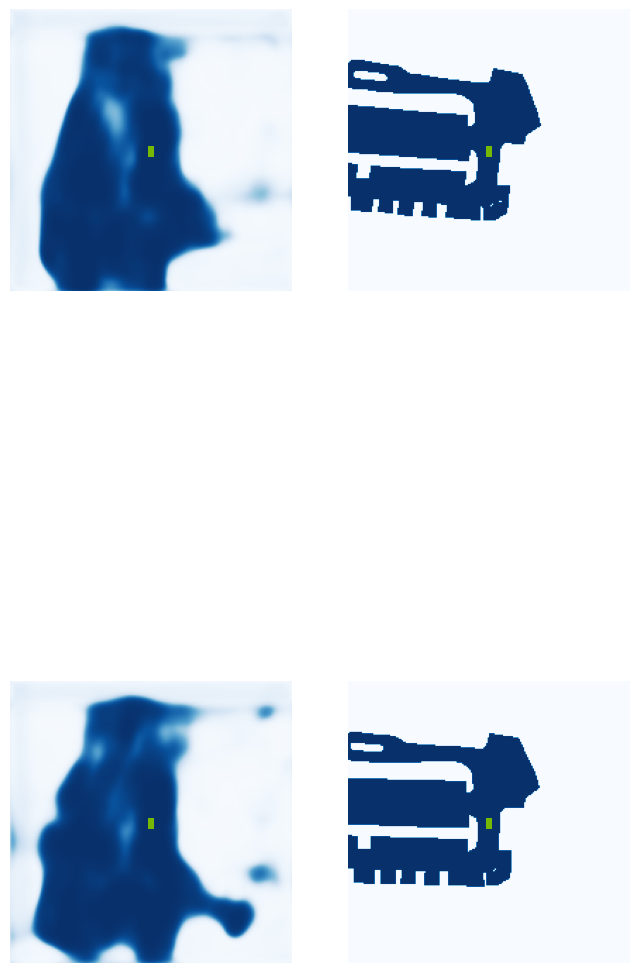

 18%|█▊        | 7/40 [00:02<00:08,  3.93it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.34.jpg


 25%|██▌       | 10/40 [00:02<00:05,  5.58it/s]

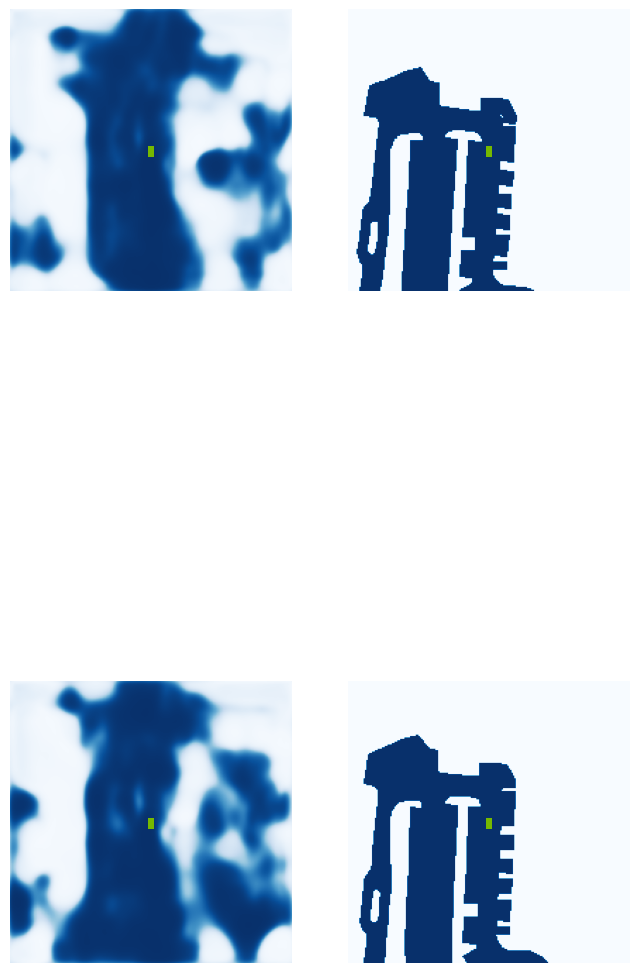

 30%|███       | 12/40 [00:03<00:07,  3.65it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.30.jpg


 38%|███▊      | 15/40 [00:04<00:05,  4.56it/s]

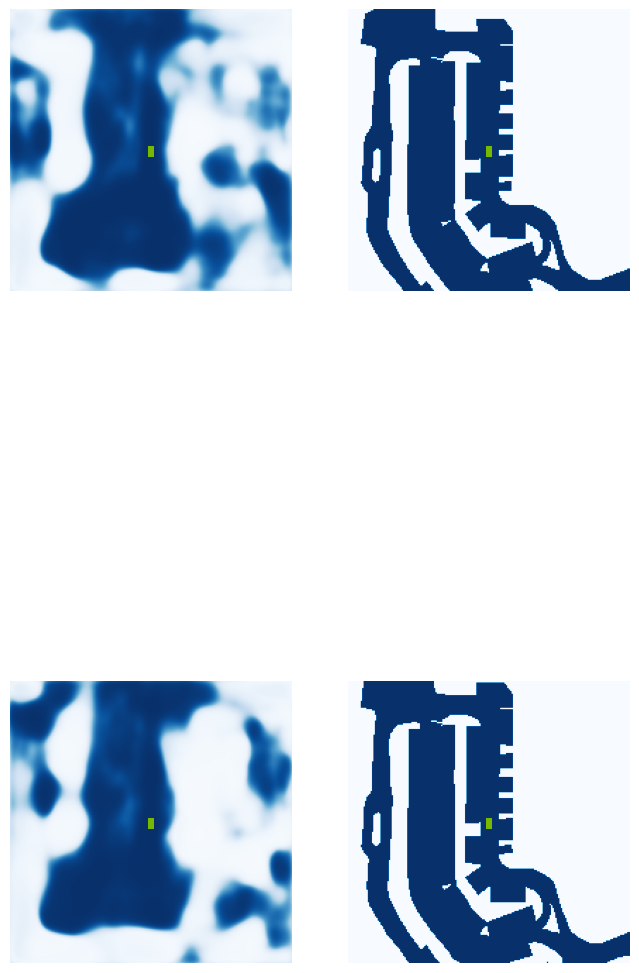

 40%|████      | 16/40 [00:04<00:06,  3.51it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.44.jpg


 50%|█████     | 20/40 [00:05<00:03,  5.30it/s]

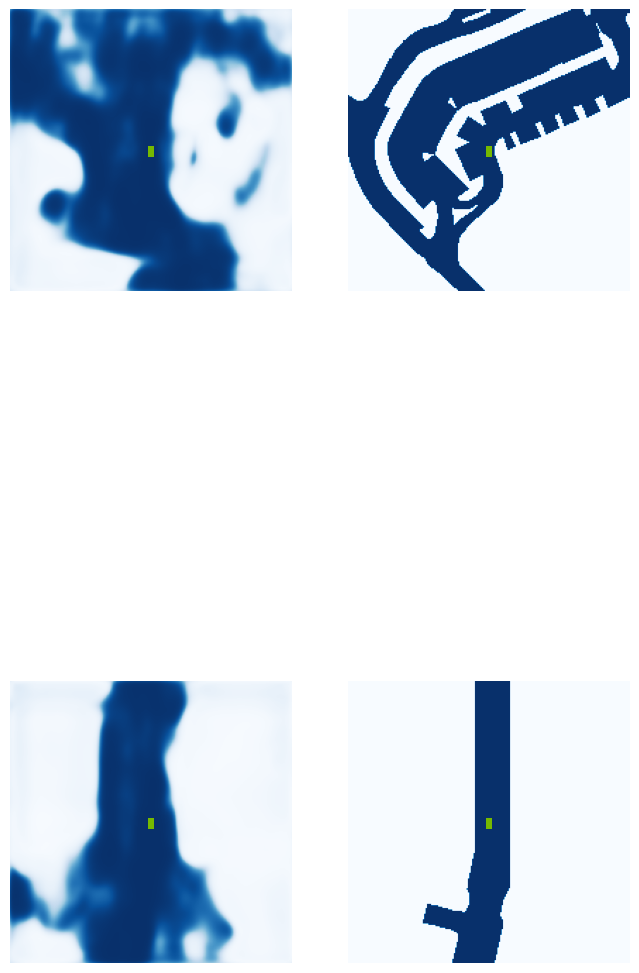

 52%|█████▎    | 21/40 [00:05<00:05,  3.27it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.41.jpg


 62%|██████▎   | 25/40 [00:06<00:02,  5.43it/s]

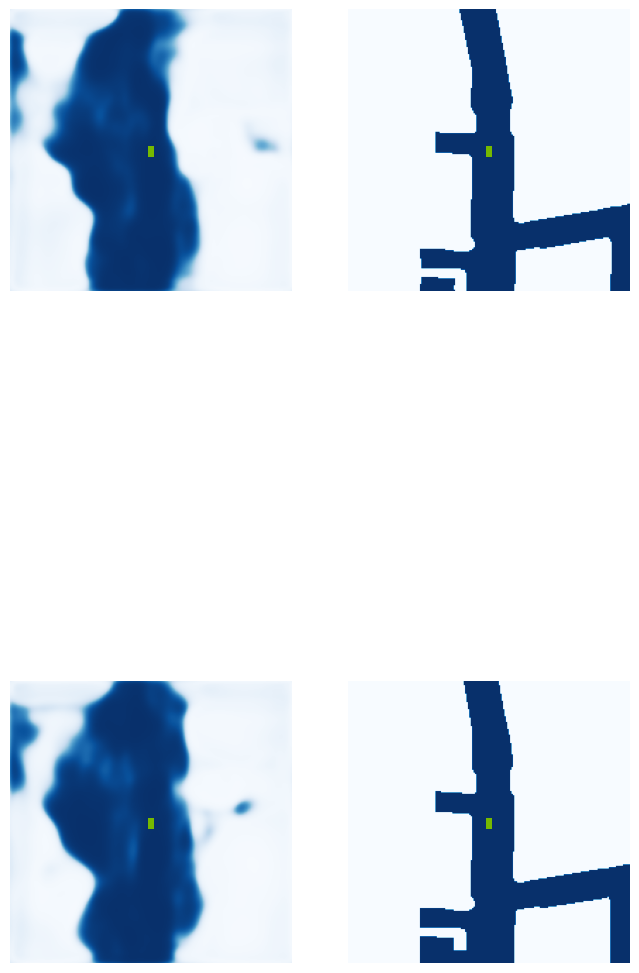

 68%|██████▊   | 27/40 [00:06<00:02,  4.89it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.39.jpg


 72%|███████▎  | 29/40 [00:07<00:01,  5.56it/s]

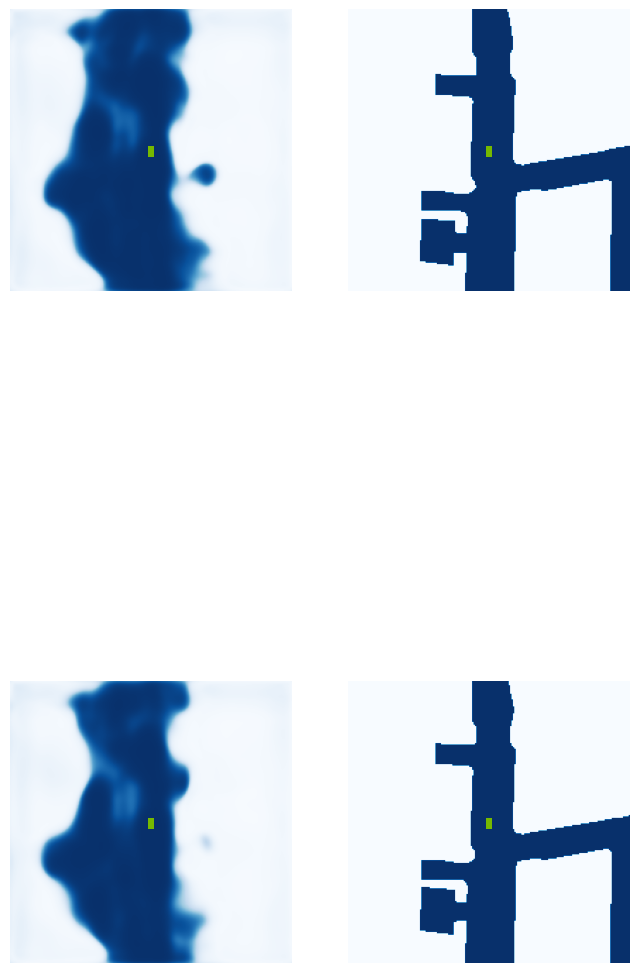

 80%|████████  | 32/40 [00:08<00:02,  3.82it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.43.jpg


 88%|████████▊ | 35/40 [00:08<00:00,  5.66it/s]

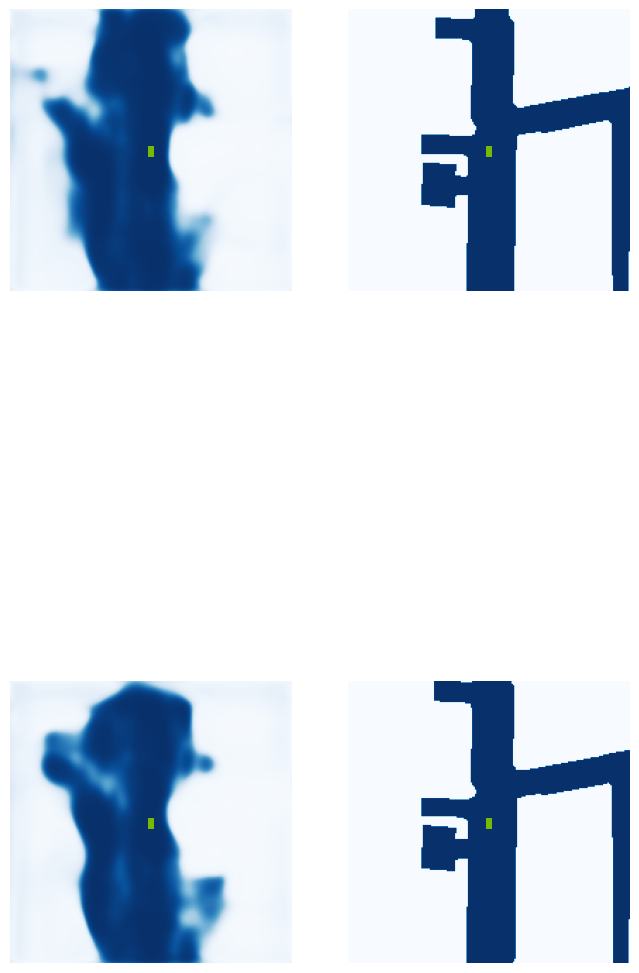

 90%|█████████ | 36/40 [00:08<00:00,  4.46it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.42.jpg


100%|██████████| 40/40 [00:09<00:00,  4.31it/s]


VAL {'loss': 1.2425050794342418, 'iou': 0.39489801285108805}
saving ...  ./runs/model1500.pt
1510 0.4217264652252197
1520 0.36976760625839233
1530 0.298511803150177
1540 0.3588998019695282
1550 0.2681533396244049
1560 0.25101712346076965
1570 0.3477473258972168
1580 0.45502468943595886
1590 1.2757813930511475
1600 0.4200077950954437
1610 0.26168814301490784
Epoch: 11/60
1620 0.2643548846244812
1630 0.6665767431259155
1640 0.4216788113117218
1650 0.47668299078941345
1660 0.2669502794742584
1670 0.35262930393218994
1680 0.233817920088768
1690 0.2369520217180252
1700 0.2269085943698883
1710 0.2492431104183197
1720 0.26513704657554626
1730 0.40558862686157227
1740 0.2890210747718811
1750 0.4958561956882477
1760 0.5395237803459167
1770 0.3868352770805359
Epoch: 12/60
1780 0.22874754667282104
1790 0.3014043867588043
1800 0.9949605464935303
1810 0.31372591853141785
1820 0.22426630556583405
1830 0.3834216296672821
1840 0.43459004163742065
1850 0.5075617432594299
1860 0.25477442145347595
1870 0

  0%|          | 0/40 [00:00<?, ?it/s]

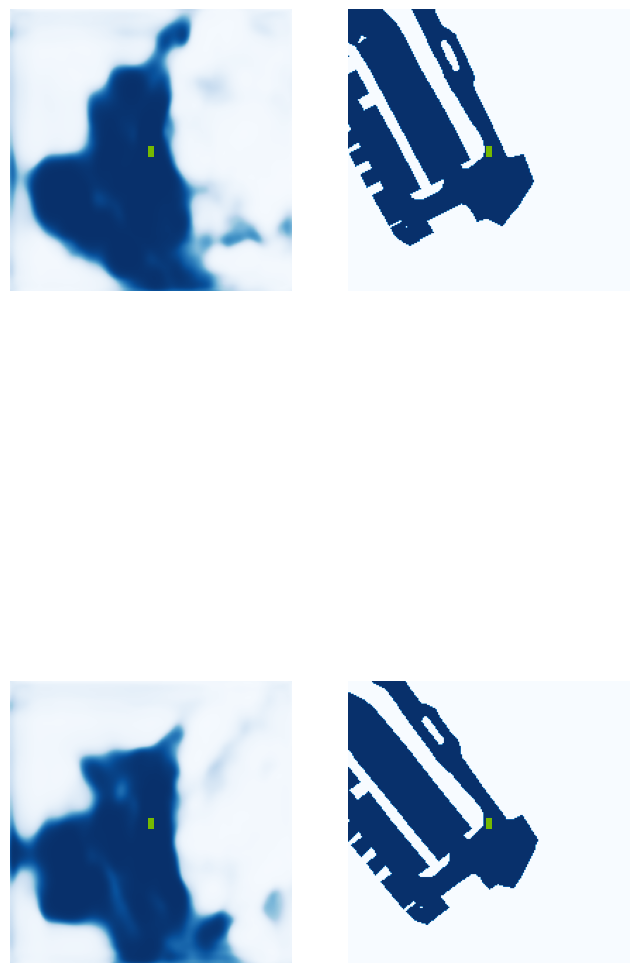

  5%|▌         | 2/40 [00:01<00:20,  1.84it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.33.jpg


 12%|█▎        | 5/40 [00:01<00:08,  4.23it/s]

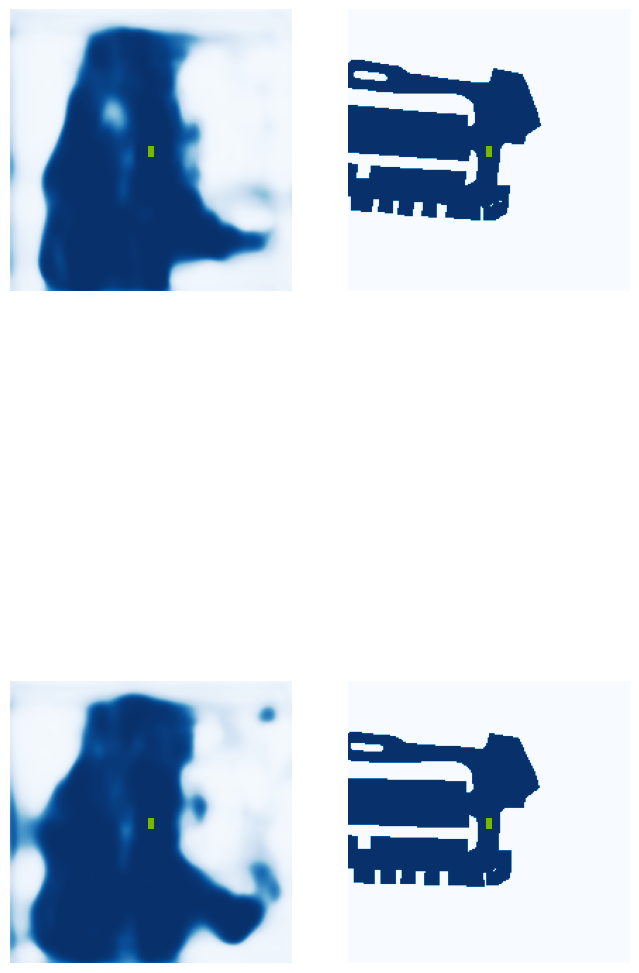

 18%|█▊        | 7/40 [00:02<00:08,  4.09it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.32.jpg


 25%|██▌       | 10/40 [00:02<00:05,  5.07it/s]

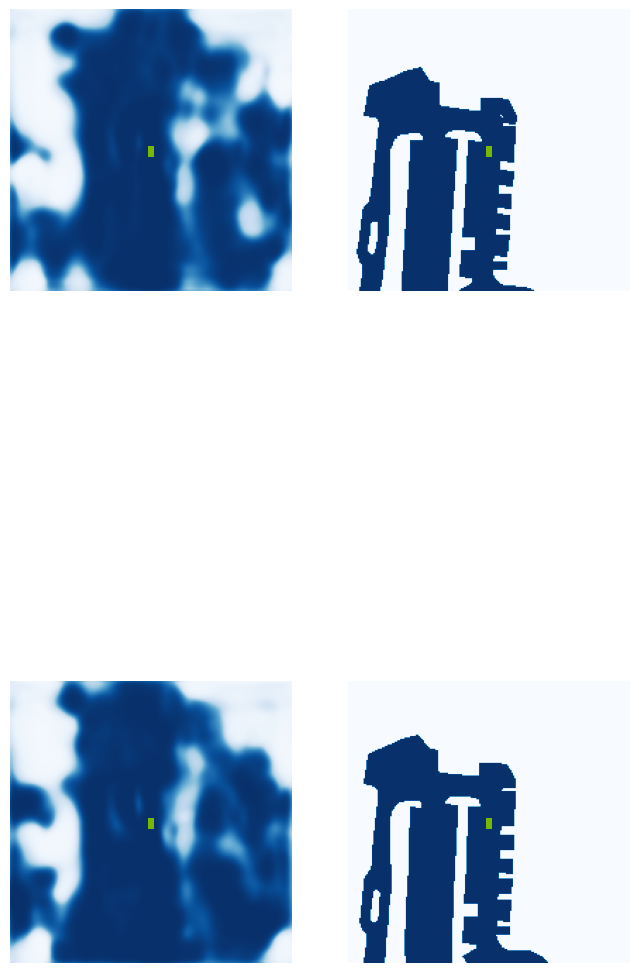

 30%|███       | 12/40 [00:03<00:08,  3.43it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.30.jpg


 38%|███▊      | 15/40 [00:04<00:05,  4.44it/s]

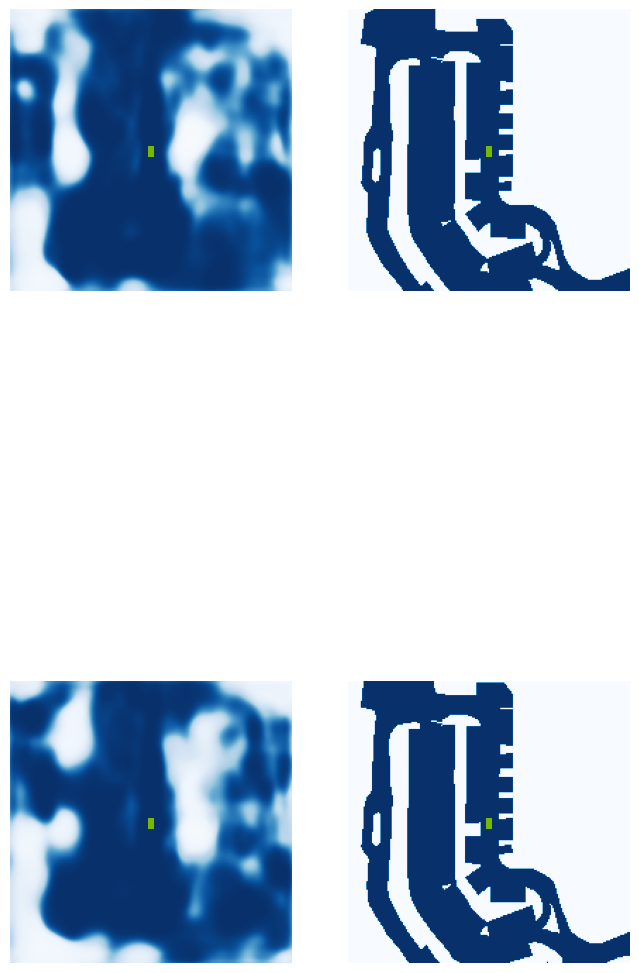

 42%|████▎     | 17/40 [00:04<00:05,  4.35it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.45.jpg


 50%|█████     | 20/40 [00:05<00:03,  5.63it/s]

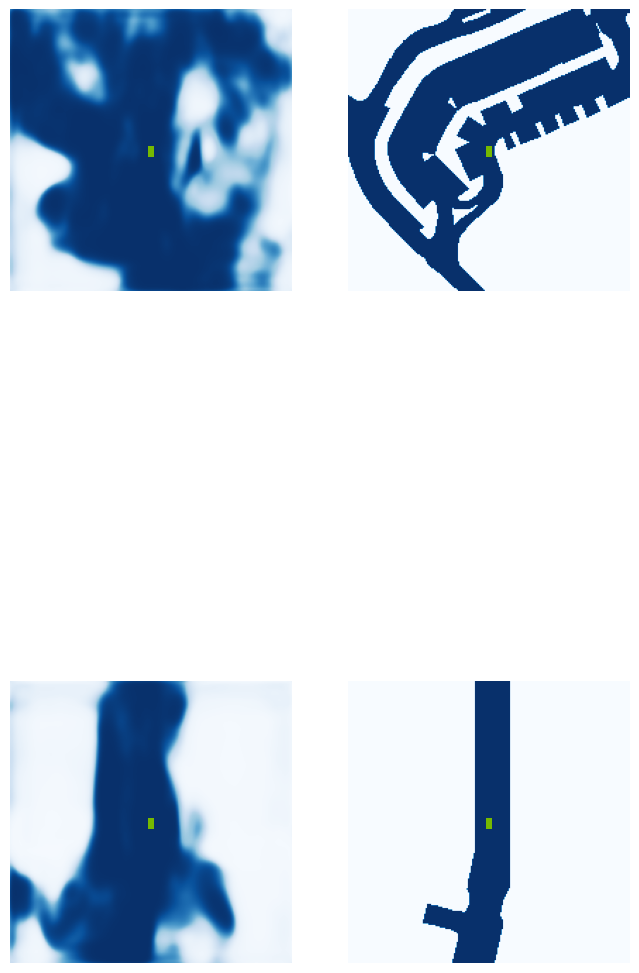

 55%|█████▌    | 22/40 [00:05<00:04,  4.06it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.42.jpg


 62%|██████▎   | 25/40 [00:06<00:02,  5.72it/s]

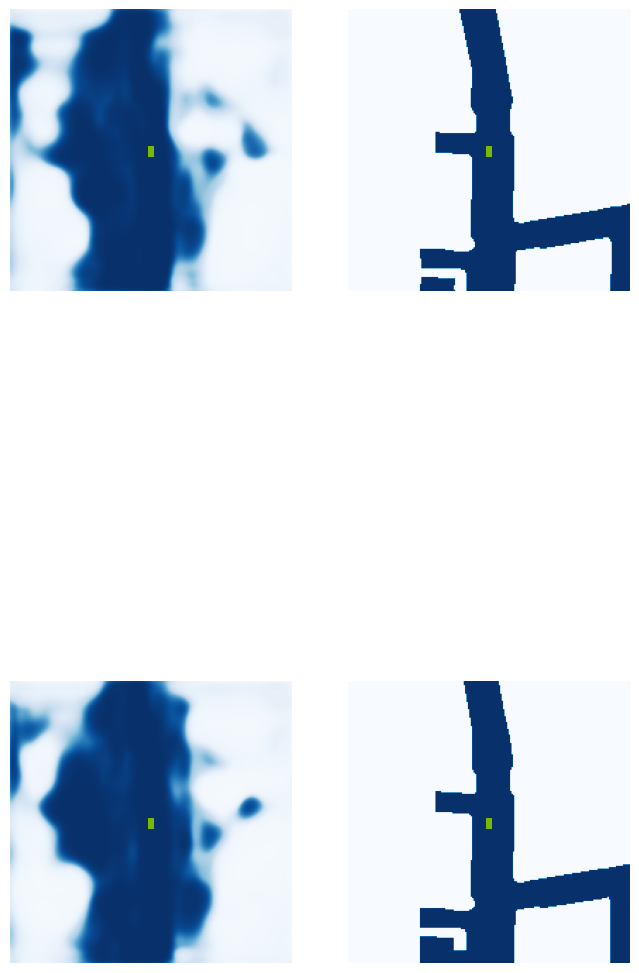

 68%|██████▊   | 27/40 [00:06<00:02,  4.97it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.38.jpg


 72%|███████▎  | 29/40 [00:07<00:01,  5.86it/s]

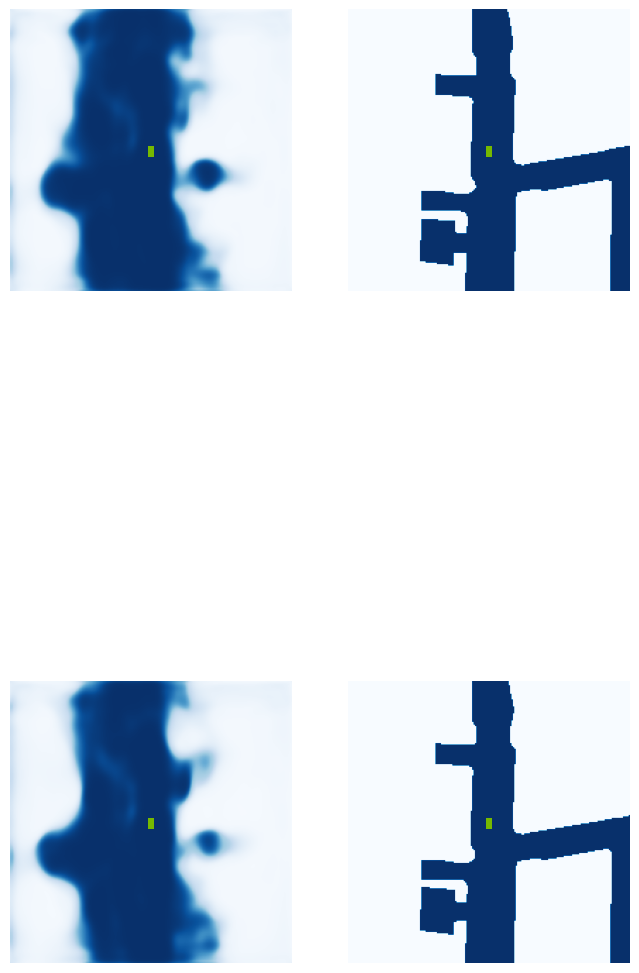

 80%|████████  | 32/40 [00:07<00:01,  4.81it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.42.jpg


 88%|████████▊ | 35/40 [00:08<00:00,  6.77it/s]

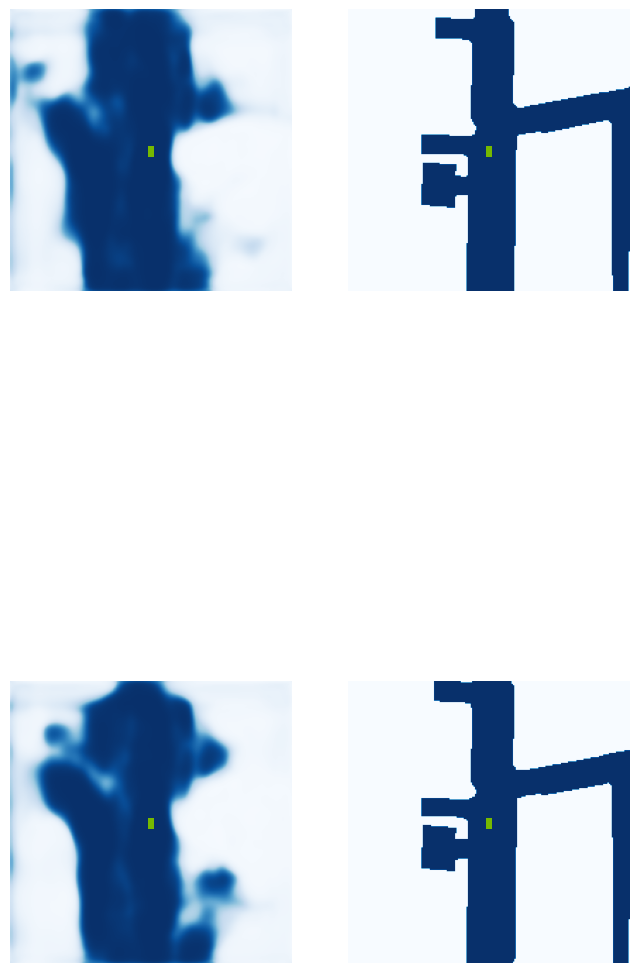

 92%|█████████▎| 37/40 [00:08<00:00,  5.47it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.40.jpg


100%|██████████| 40/40 [00:09<00:00,  4.42it/s]


VAL {'loss': 1.4143358159948278, 'iou': 0.38950950800039497}
saving ...  ./runs/model2000.pt
2010 0.7322536706924438
2020 0.3139350116252899
2030 0.19630199670791626
2040 0.6903244256973267
2050 0.2954675853252411
2060 0.195967435836792
2070 0.5972613096237183
2080 0.31494393944740295
2090 0.22726181149482727
Epoch: 14/60
2100 0.4743088185787201
2110 0.34983840584754944
2120 0.19813917577266693
2130 0.3848761320114136
2140 0.42788660526275635
2150 0.251484215259552
2160 0.23273947834968567
2170 0.19570304453372955
2180 0.2210640013217926
2190 0.3243575096130371
2200 0.22982768714427948
2210 0.30712997913360596
2220 0.24494731426239014
2230 0.21449220180511475
2240 0.2346213012933731
2250 0.5205524563789368
Epoch: 15/60
2260 0.29658710956573486
2270 0.3296891152858734
2280 0.6610510349273682
2290 0.3111882209777832
2300 0.23056752979755402
2310 0.2924759089946747
2320 0.31766027212142944
2330 0.2142392098903656
2340 0.31754904985427856
2350 0.31245097517967224
2360 0.2804966866970062
23

  0%|          | 0/40 [00:00<?, ?it/s]

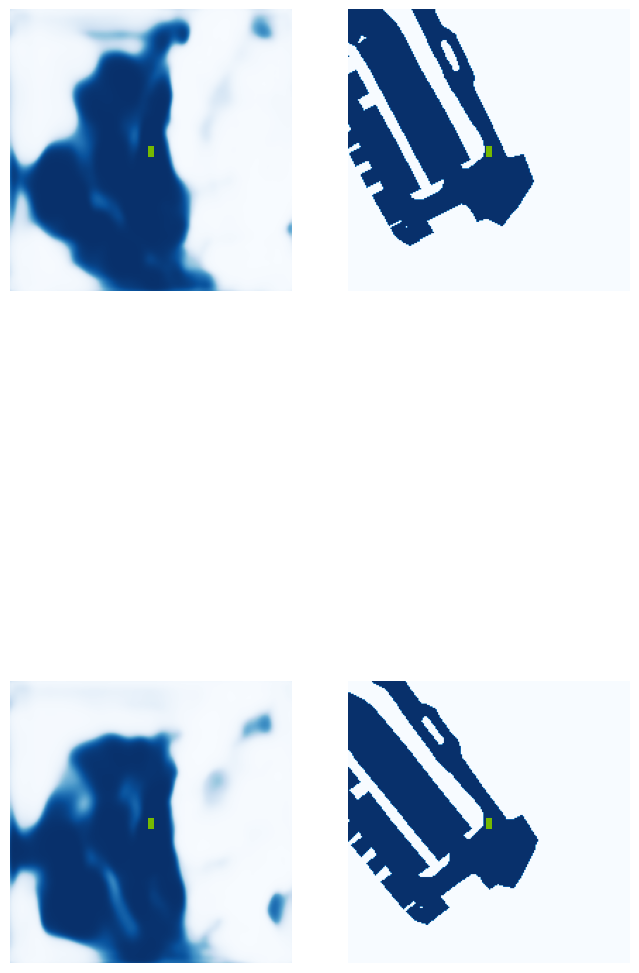

  5%|▌         | 2/40 [00:01<00:20,  1.82it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.37.jpg


 12%|█▎        | 5/40 [00:01<00:07,  4.50it/s]

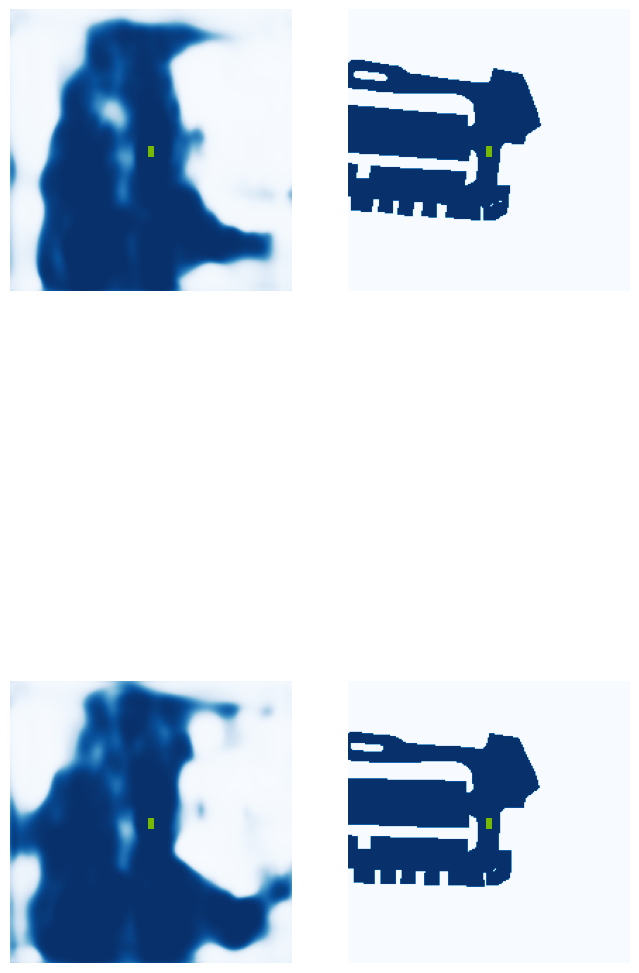

 18%|█▊        | 7/40 [00:02<00:07,  4.40it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.32.jpg


 25%|██▌       | 10/40 [00:02<00:05,  5.02it/s]

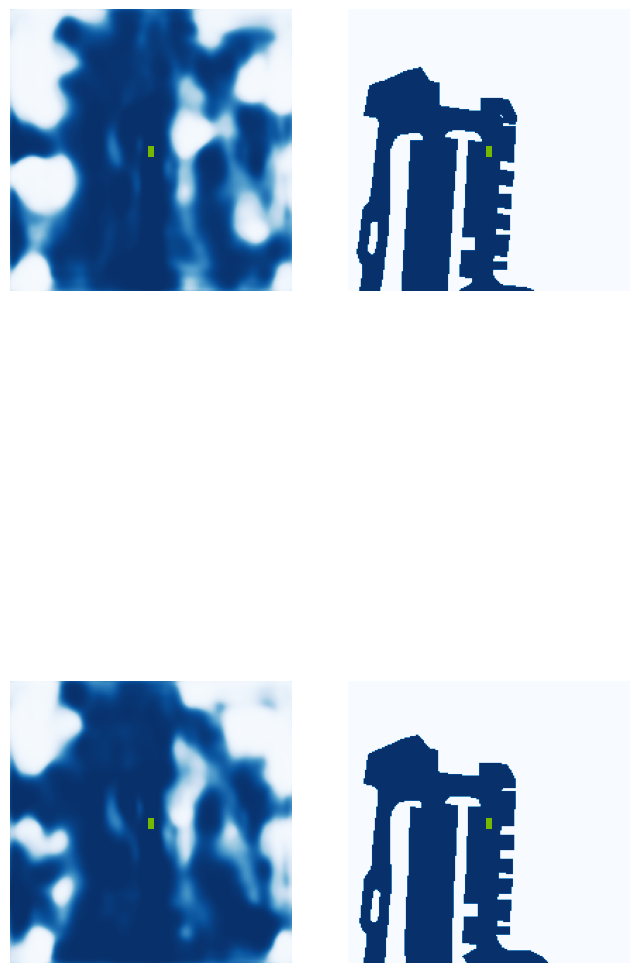

 30%|███       | 12/40 [00:03<00:07,  3.81it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.35.jpg


 38%|███▊      | 15/40 [00:04<00:05,  4.36it/s]

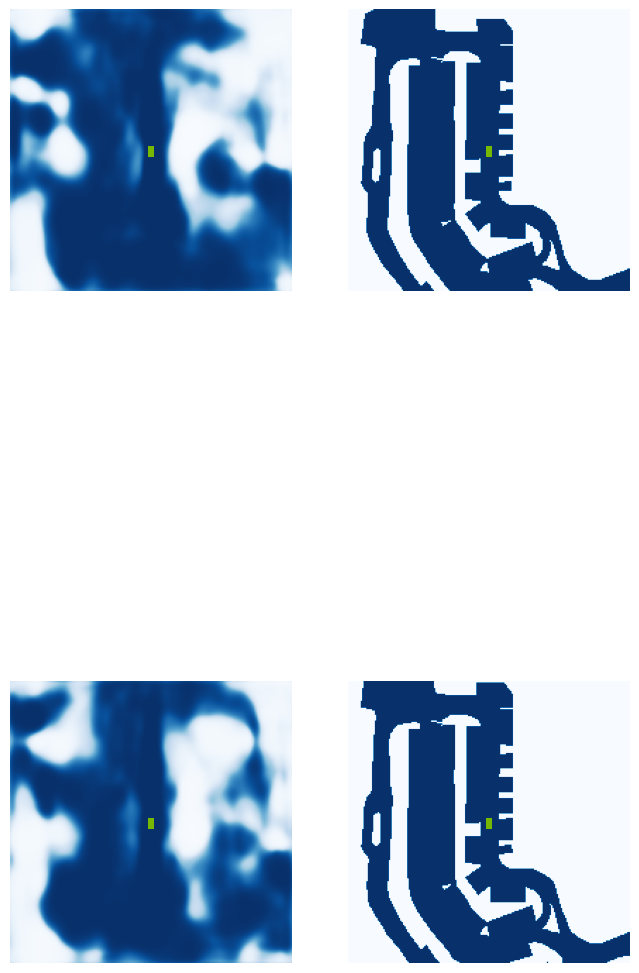

 42%|████▎     | 17/40 [00:04<00:05,  4.37it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.50.jpg


 48%|████▊     | 19/40 [00:05<00:04,  4.25it/s]

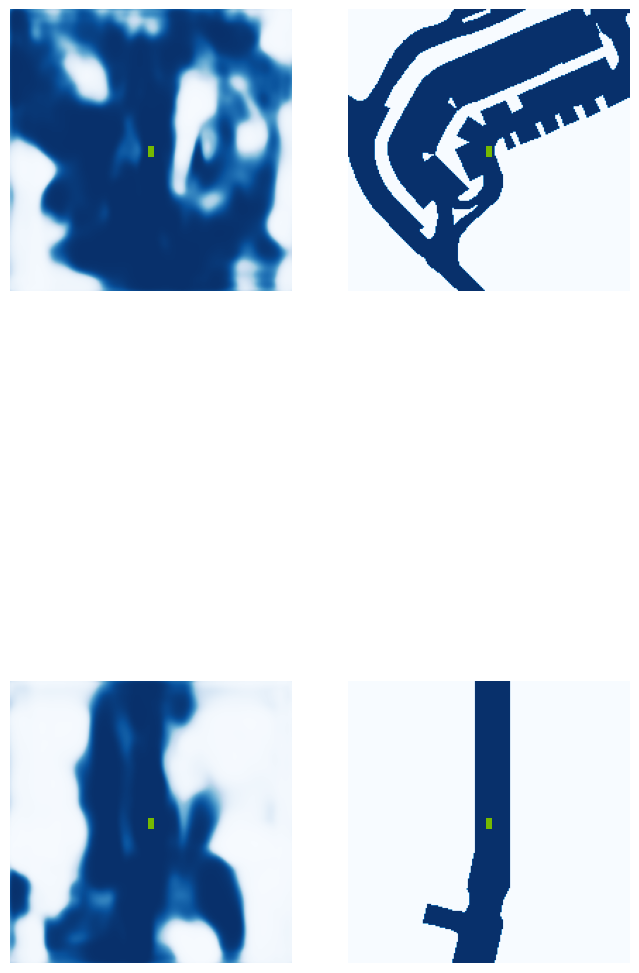

 57%|█████▊    | 23/40 [00:05<00:03,  4.64it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.37.jpg


 62%|██████▎   | 25/40 [00:06<00:02,  5.32it/s]

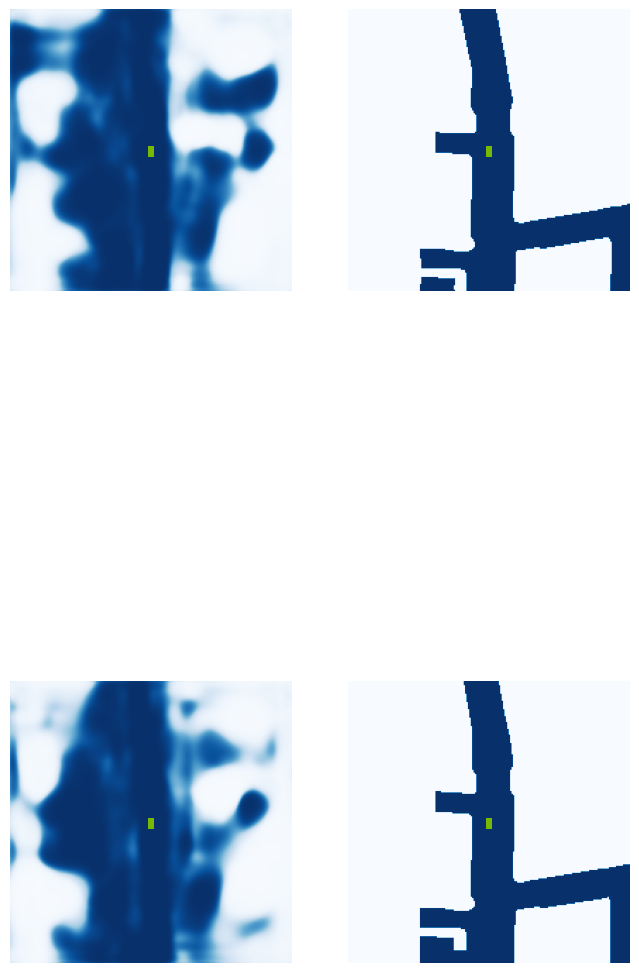

 68%|██████▊   | 27/40 [00:06<00:02,  4.75it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.32.jpg


 72%|███████▎  | 29/40 [00:07<00:01,  5.64it/s]

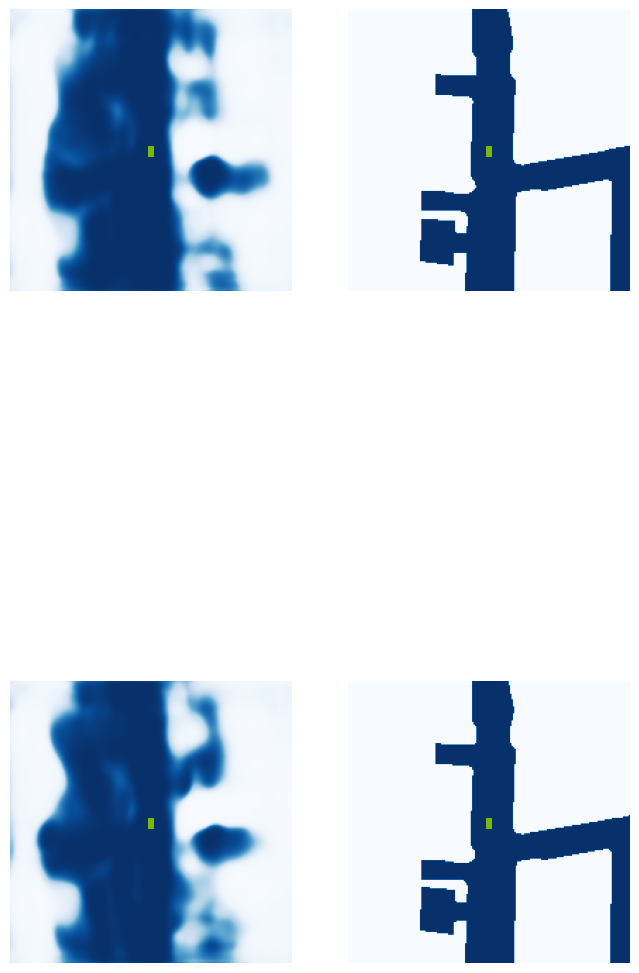

 80%|████████  | 32/40 [00:07<00:01,  4.71it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.39.jpg


 88%|████████▊ | 35/40 [00:08<00:00,  5.78it/s]

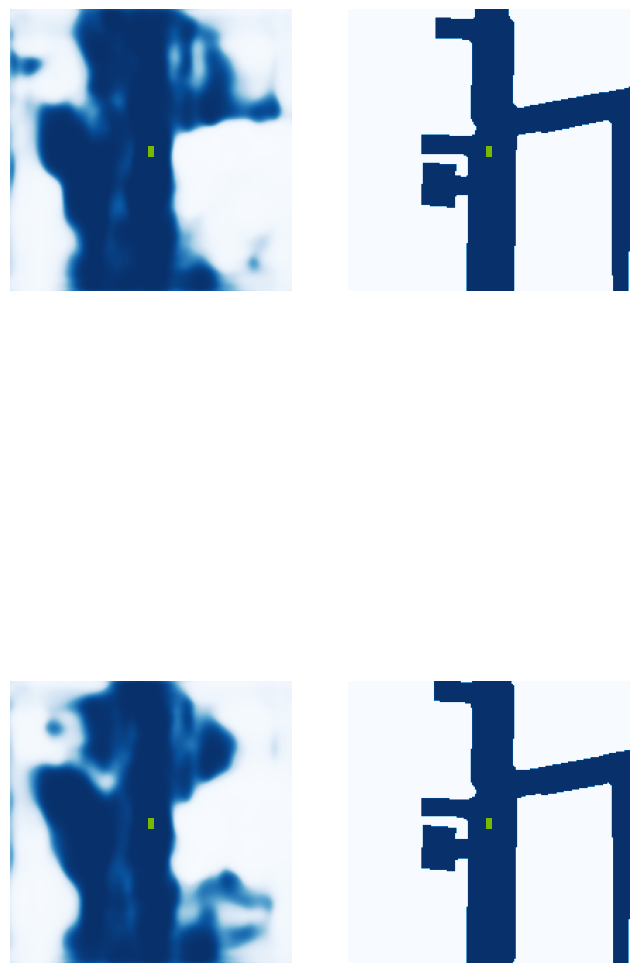

 92%|█████████▎| 37/40 [00:08<00:00,  4.81it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.38.jpg


100%|██████████| 40/40 [00:09<00:00,  4.40it/s]


VAL {'loss': 1.4959437670531097, 'iou': 0.38053245698026694}
saving ...  ./runs/model2500.pt
2510 0.1930525302886963
2520 0.280947744846344
2530 0.3022101819515228
2540 0.17406614124774933
2550 0.2556278109550476
2560 0.23615780472755432
2570 0.3585427701473236
Epoch: 17/60
2580 0.2612782418727875
2590 0.23514927923679352
2600 0.2230251431465149
2610 0.2043866217136383
2620 0.18797792494297028
2630 0.20471185445785522
2640 0.3579050600528717
2650 0.1917974203824997
2660 0.2387791872024536
2670 0.24631507694721222
2680 0.5252109169960022
2690 0.30516767501831055
2700 0.15177474915981293
2710 0.4813784062862396
2720 0.4018237590789795
2730 0.3076346814632416
Epoch: 18/60
2740 0.20447605848312378
2750 0.3378571569919586
2760 0.2381652295589447
2770 0.3210027813911438
2780 0.1549542248249054
2790 0.24640946090221405
2800 0.2661513388156891
2810 0.37417924404144287
2820 0.25566351413726807
2830 0.1775217205286026
2840 0.2876587212085724
2850 0.1563180536031723
2860 0.16456806659698486
2870 

  0%|          | 0/40 [00:00<?, ?it/s]

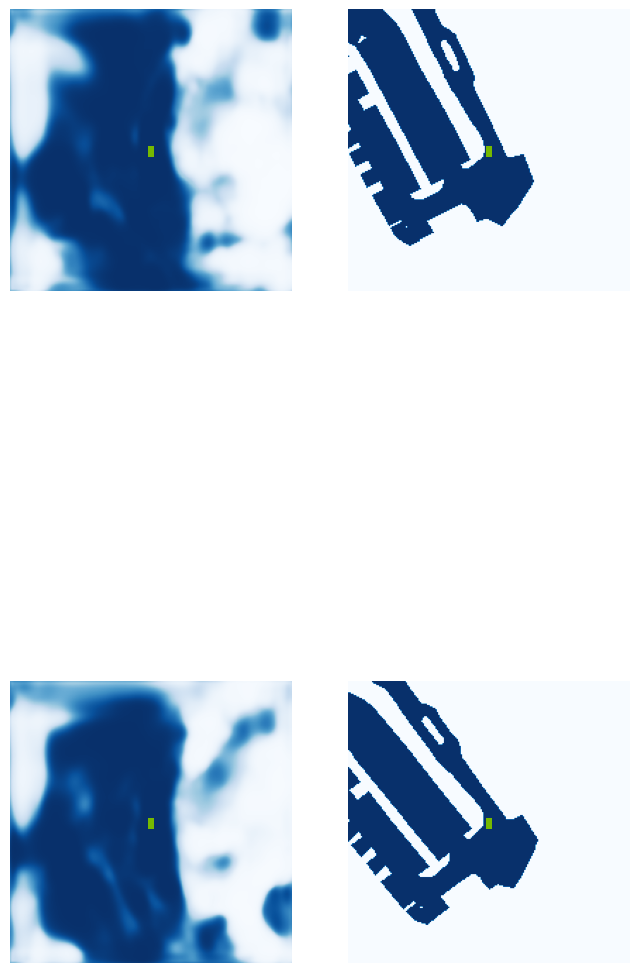

  5%|▌         | 2/40 [00:01<00:20,  1.81it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.37.jpg


 12%|█▎        | 5/40 [00:01<00:09,  3.79it/s]

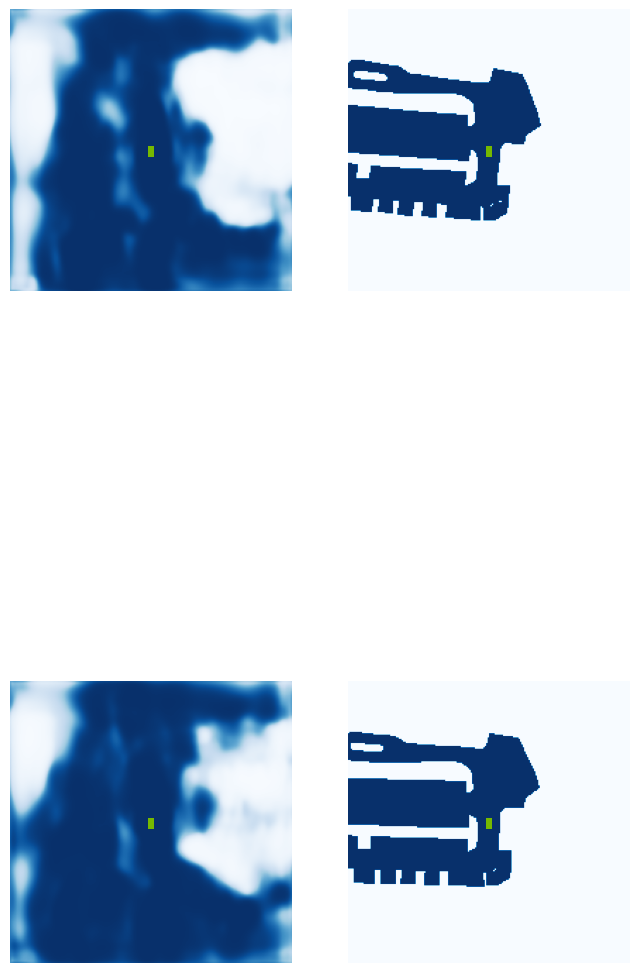

 18%|█▊        | 7/40 [00:02<00:08,  3.92it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.28.jpg


 25%|██▌       | 10/40 [00:02<00:06,  4.84it/s]

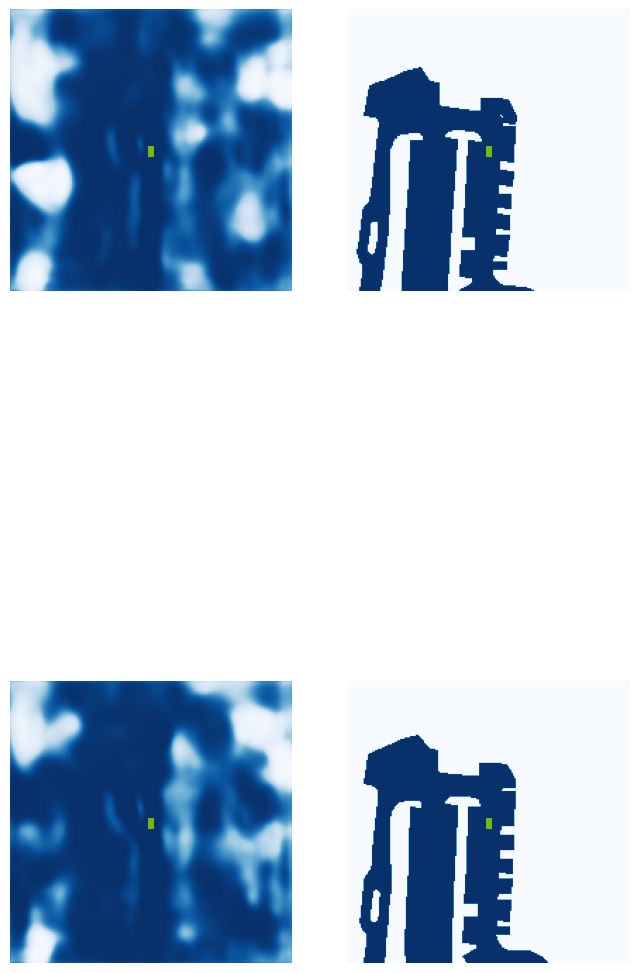

 28%|██▊       | 11/40 [00:03<00:09,  3.04it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.32.jpg


 38%|███▊      | 15/40 [00:04<00:05,  4.72it/s]

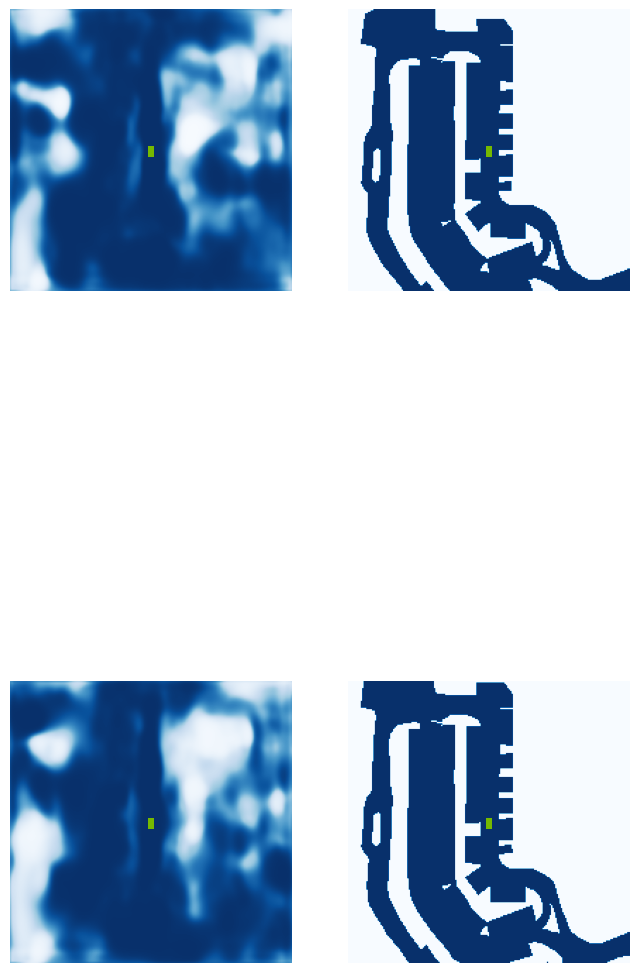

 42%|████▎     | 17/40 [00:04<00:05,  4.57it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.49.jpg


 48%|████▊     | 19/40 [00:05<00:04,  4.73it/s]

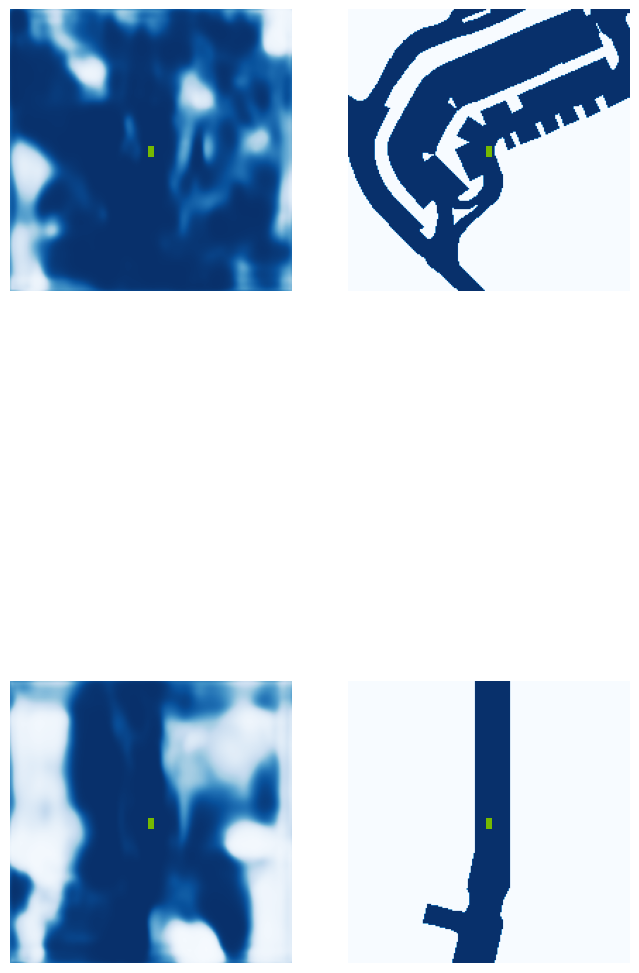

 57%|█████▊    | 23/40 [00:05<00:03,  4.80it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.34.jpg


 62%|██████▎   | 25/40 [00:06<00:02,  5.55it/s]

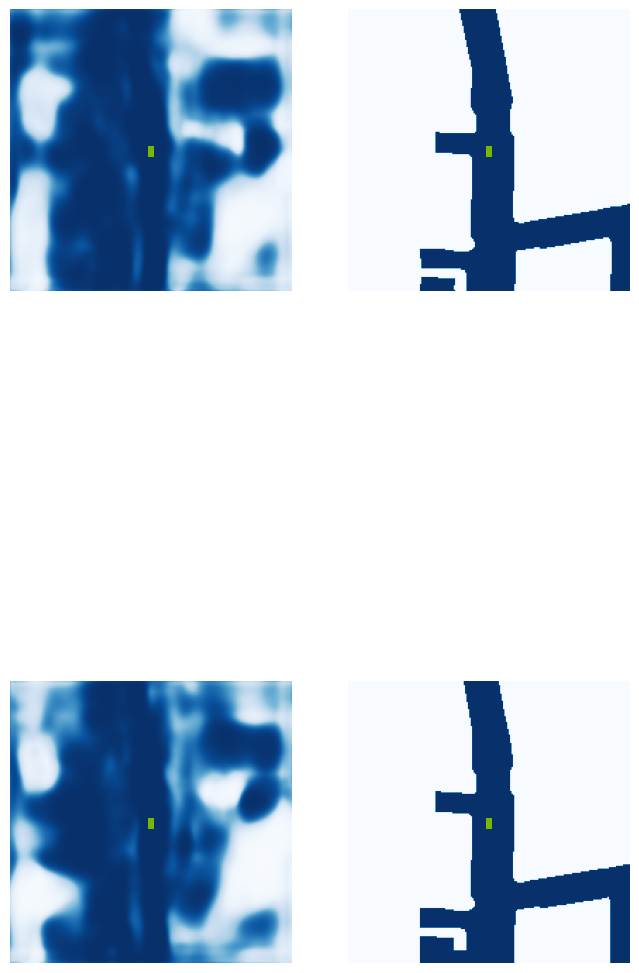

 68%|██████▊   | 27/40 [00:06<00:02,  5.09it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.26.jpg


 75%|███████▌  | 30/40 [00:07<00:01,  6.59it/s]

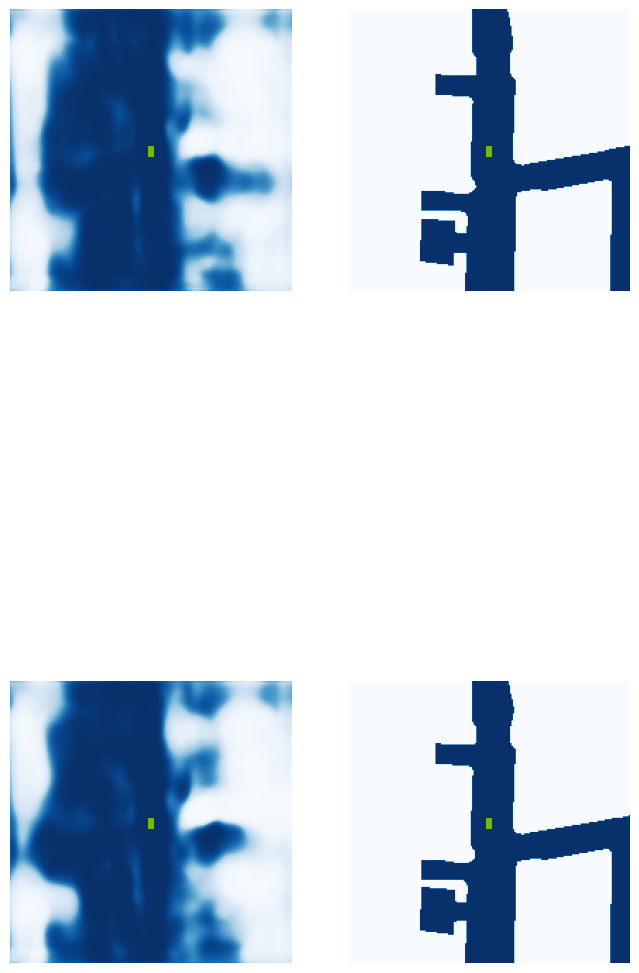

 80%|████████  | 32/40 [00:07<00:01,  4.51it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.36.jpg


 88%|████████▊ | 35/40 [00:08<00:00,  6.19it/s]

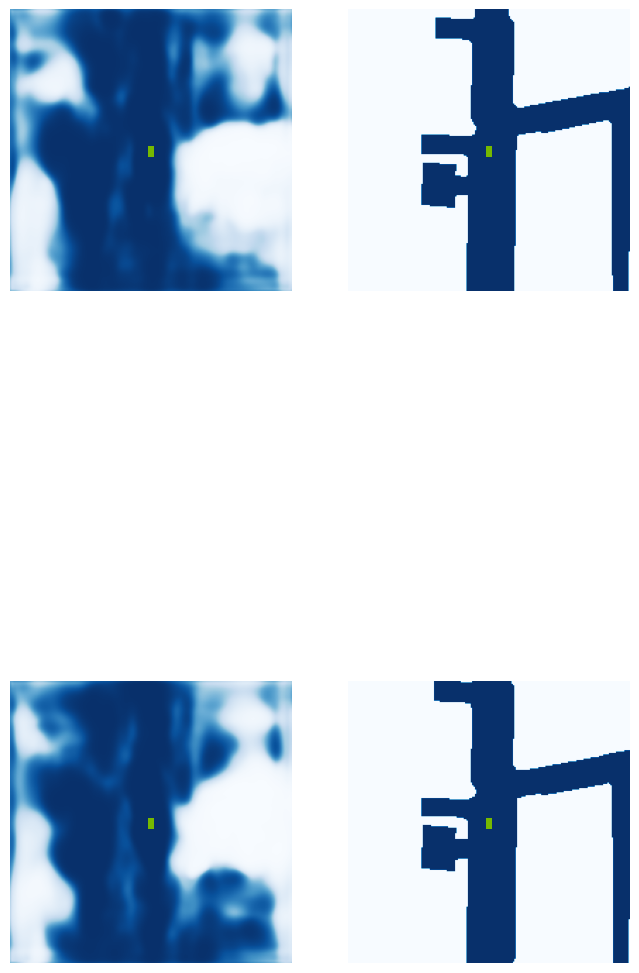

 92%|█████████▎| 37/40 [00:08<00:00,  4.74it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.32.jpg


100%|██████████| 40/40 [00:09<00:00,  4.43it/s]


VAL {'loss': 1.6320955370679313, 'iou': 0.3489676201728343}
saving ...  ./runs/model3000.pt
3010 0.14950589835643768
3020 0.285910427570343
3030 0.18814067542552948
3040 0.16057614982128143
3050 0.3192085027694702
Epoch: 20/60
3060 0.2846628427505493
3070 0.49746590852737427
3080 0.18802312016487122
3090 0.25504931807518005
3100 0.16460633277893066
3110 0.3763801157474518
3120 0.24543823301792145
3130 0.28237923979759216
3140 0.15055152773857117
3150 0.2821446359157562
3160 0.28547167778015137
3170 0.17178459465503693
3180 0.5087532997131348
3190 0.262960821390152
3200 0.19868795573711395
3210 0.2960486114025116
3220 0.3701023757457733
Epoch: 21/60
3230 0.30993303656578064
3240 0.3621039390563965
3250 0.20228856801986694
3260 0.20651184022426605
3270 0.20503653585910797
3280 0.22964638471603394
3290 0.19039781391620636
3300 0.19919352233409882
3310 0.2445739209651947
3320 0.1990707665681839
3330 0.1738431602716446
3340 0.37243813276290894
3350 0.37948957085609436
3360 0.159563869237899

  0%|          | 0/40 [00:00<?, ?it/s]

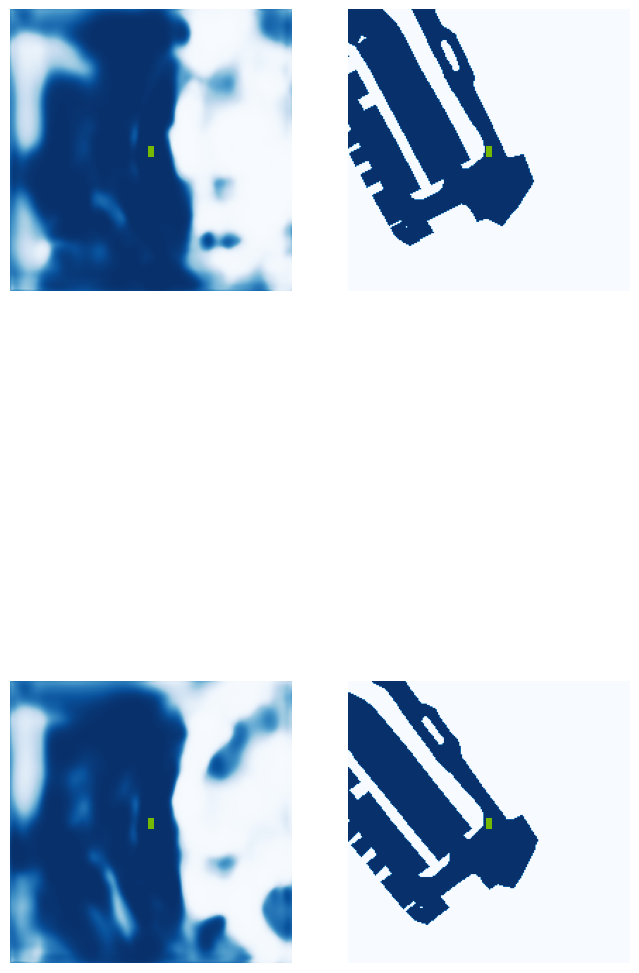

  5%|▌         | 2/40 [00:01<00:21,  1.75it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.38.jpg


 12%|█▎        | 5/40 [00:01<00:08,  4.25it/s]

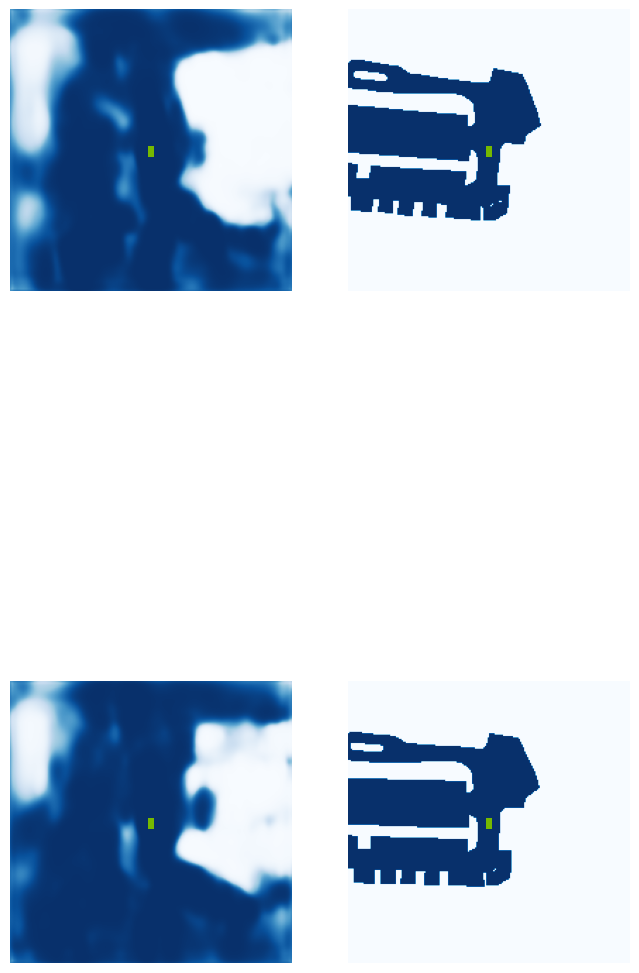

 18%|█▊        | 7/40 [00:02<00:07,  4.15it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.28.jpg


 25%|██▌       | 10/40 [00:02<00:06,  4.93it/s]

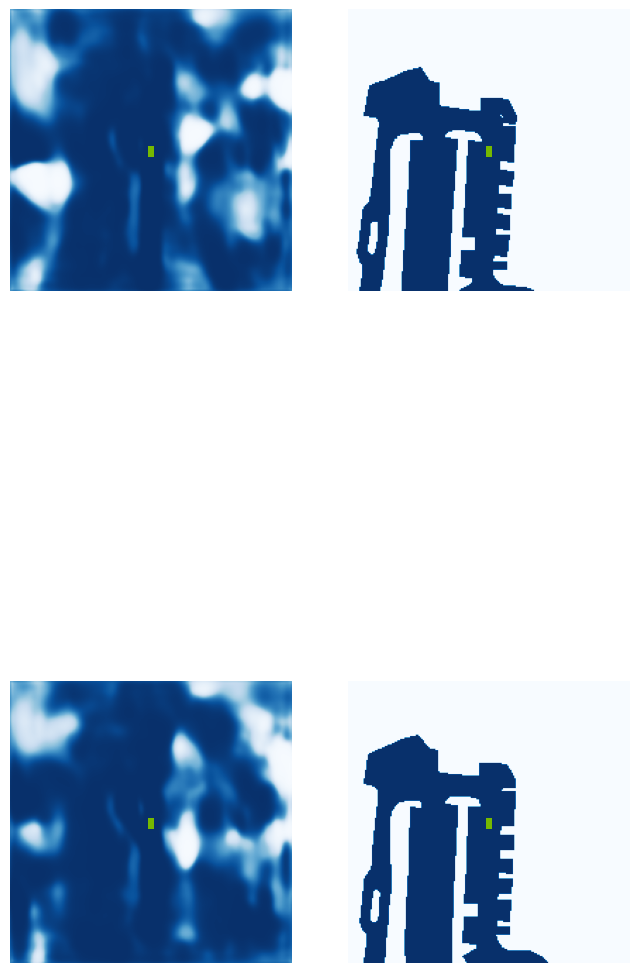

 30%|███       | 12/40 [00:03<00:07,  3.53it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.32.jpg


 38%|███▊      | 15/40 [00:04<00:05,  4.84it/s]

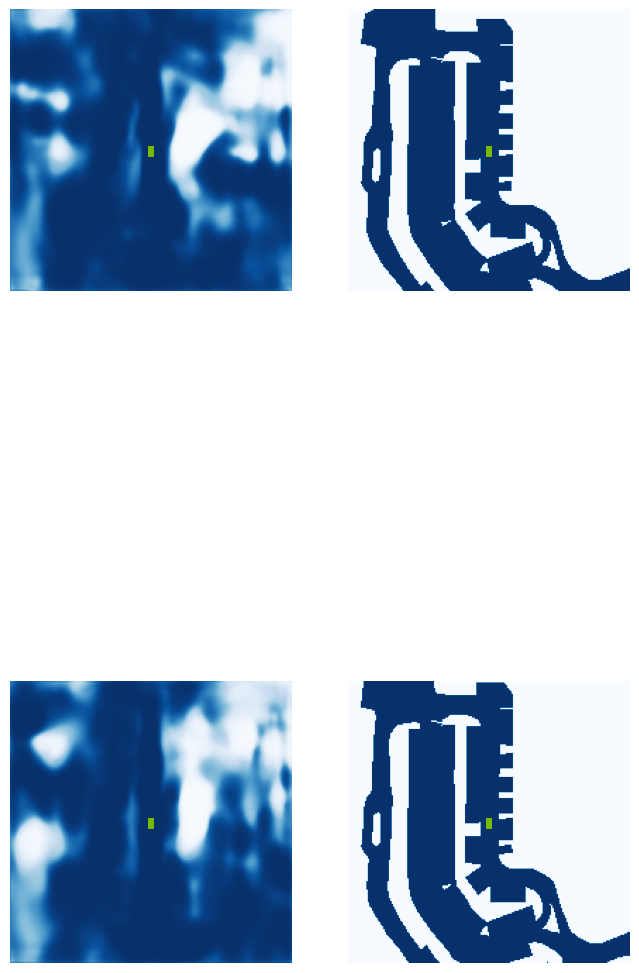

 42%|████▎     | 17/40 [00:04<00:05,  4.37it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.50.jpg


 48%|████▊     | 19/40 [00:05<00:04,  4.54it/s]

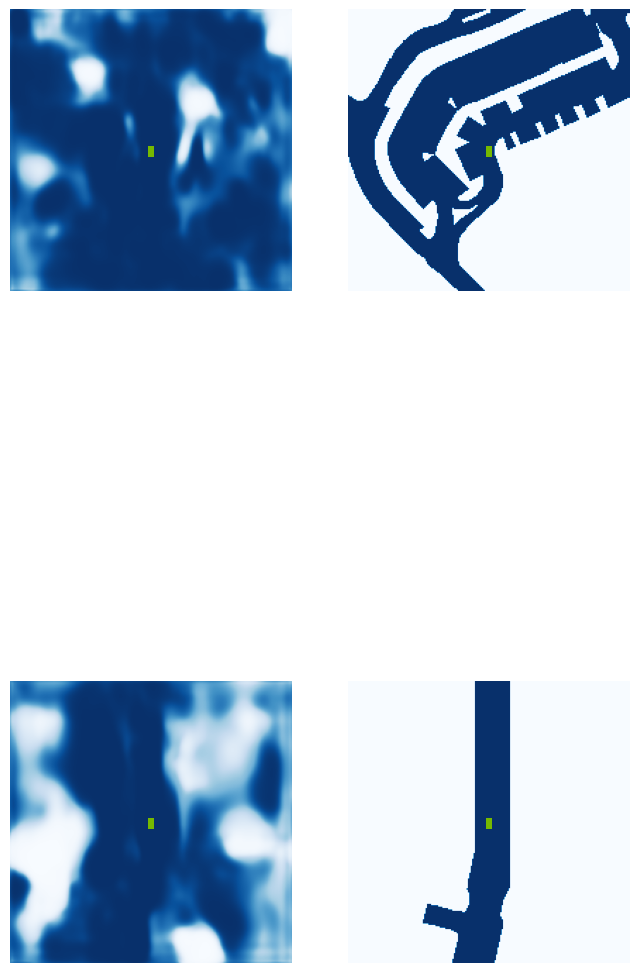

 55%|█████▌    | 22/40 [00:05<00:04,  4.16it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.32.jpg


 62%|██████▎   | 25/40 [00:06<00:02,  5.85it/s]

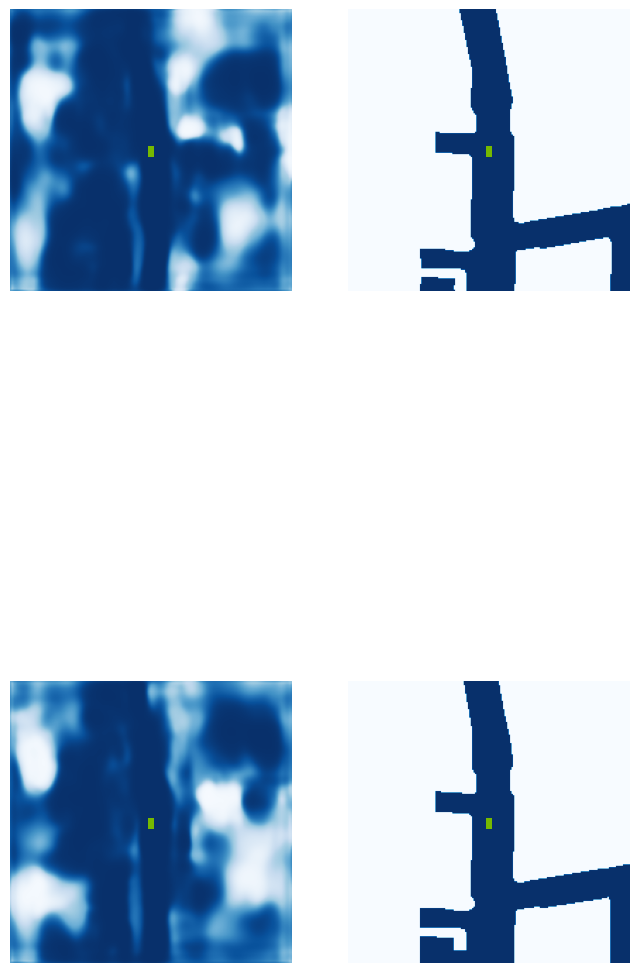

 68%|██████▊   | 27/40 [00:06<00:02,  5.13it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.25.jpg


 75%|███████▌  | 30/40 [00:07<00:01,  6.46it/s]

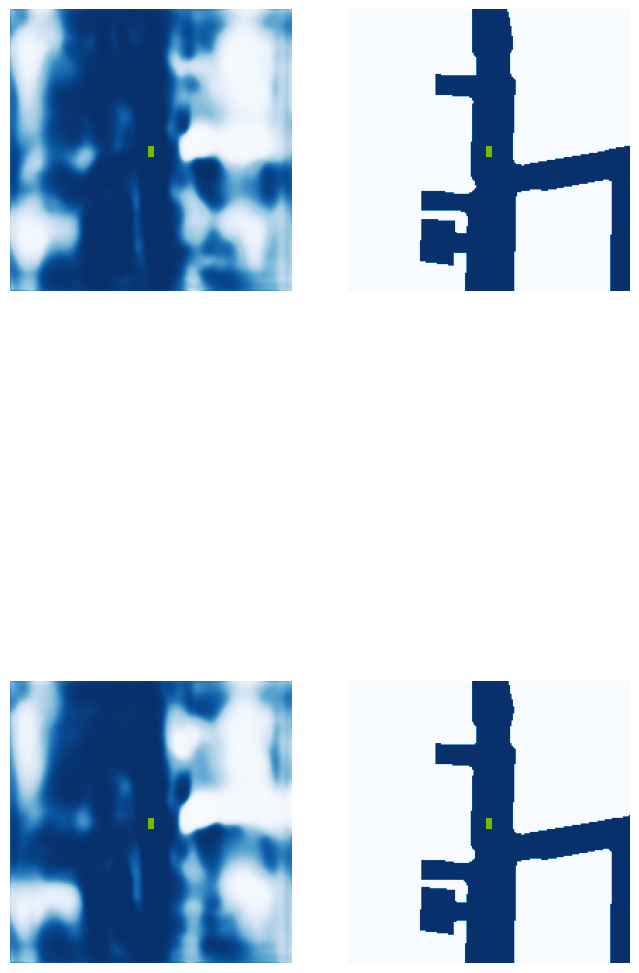

 80%|████████  | 32/40 [00:07<00:01,  4.40it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.34.jpg


 88%|████████▊ | 35/40 [00:08<00:00,  6.23it/s]

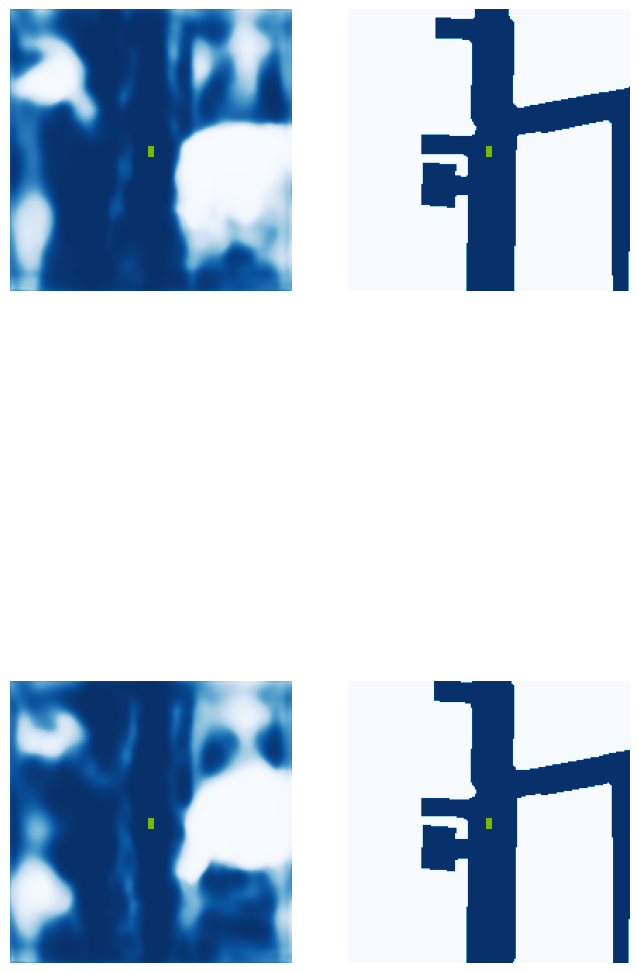

 92%|█████████▎| 37/40 [00:08<00:00,  4.74it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.31.jpg


100%|██████████| 40/40 [00:09<00:00,  4.32it/s]


VAL {'loss': 1.7443548779428741, 'iou': 0.34198504721428974}
saving ...  ./runs/model3500.pt
3510 0.2111457884311676
3520 0.11448642611503601
3530 0.22197966277599335
3540 0.4850332736968994
Epoch: 23/60
3550 0.2334505319595337
3560 0.19685868918895721
3570 0.1611669510602951
3580 0.4581434428691864
3590 0.2437388300895691
3600 0.22611300647258759
3610 0.17941391468048096
3620 0.17633746564388275
3630 0.19657744467258453
3640 0.20377935469150543
3650 0.4443303644657135
3660 0.42575857043266296
3670 0.20993325114250183
3680 0.10981369018554688
3690 0.320283442735672
3700 0.42415496706962585
Epoch: 24/60
3710 0.18890511989593506
3720 0.2668626010417938
3730 0.15868593752384186
3740 0.15055446326732635
3750 0.23677553236484528
3760 0.1419752836227417
3770 0.3417648375034332
3780 0.13238859176635742
3790 0.3811899423599243
3800 0.20149211585521698
3810 0.1391758769750595
3820 0.21500155329704285
3830 0.16084513068199158
3840 0.368552565574646
3850 0.3311527371406555
3860 0.2474578768014907

  0%|          | 0/40 [00:00<?, ?it/s]

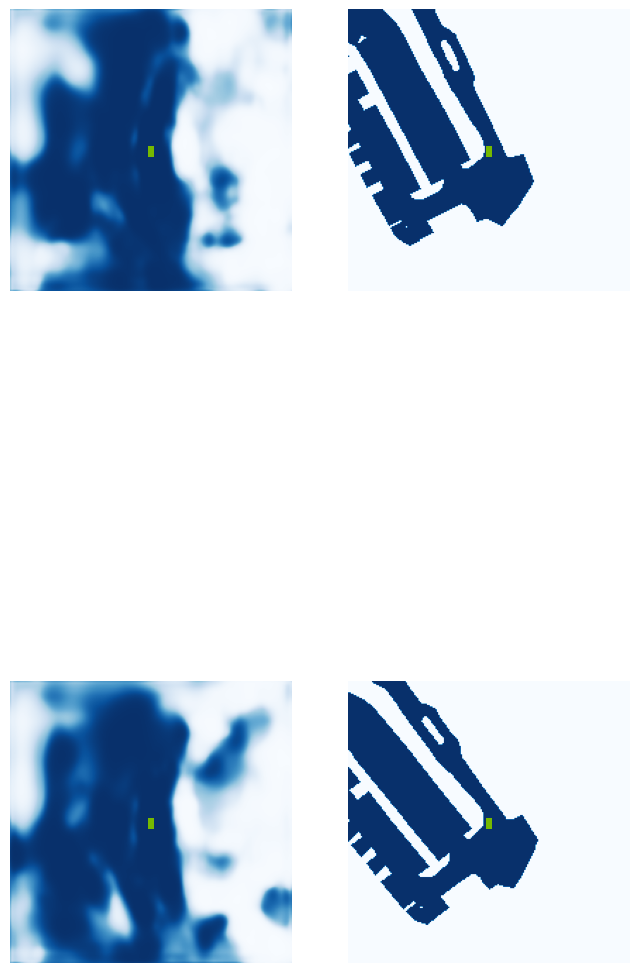

  5%|▌         | 2/40 [00:01<00:21,  1.80it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.36.jpg


 12%|█▎        | 5/40 [00:01<00:07,  4.38it/s]

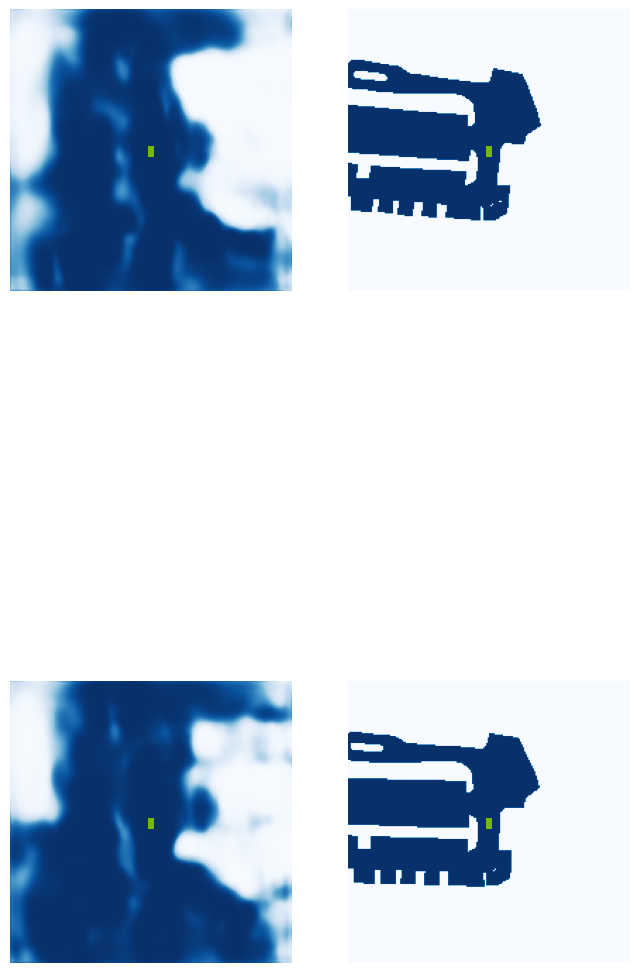

 18%|█▊        | 7/40 [00:02<00:11,  2.96it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.28.jpg


 25%|██▌       | 10/40 [00:03<00:05,  5.15it/s]

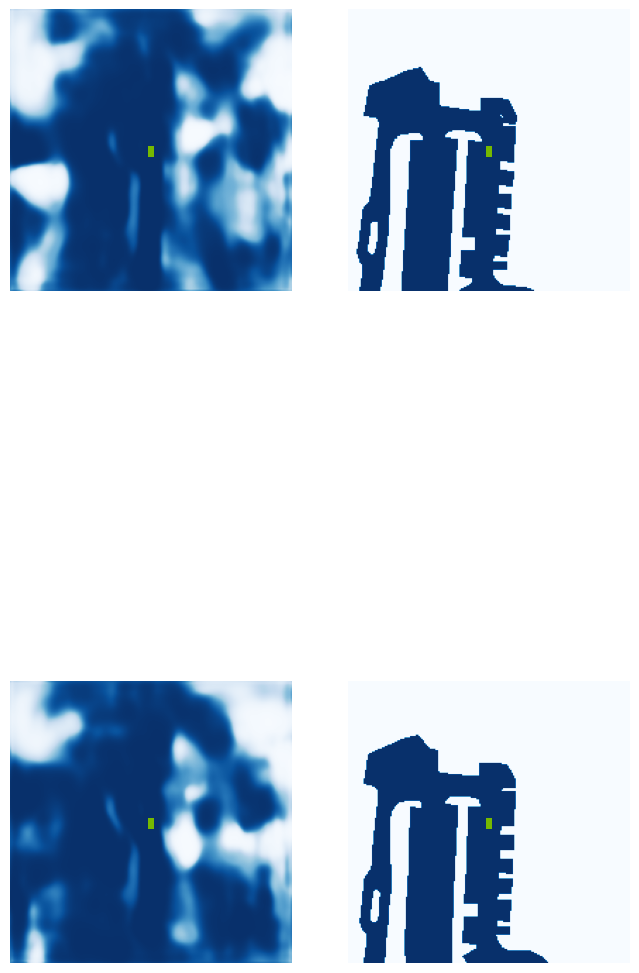

 30%|███       | 12/40 [00:03<00:05,  4.73it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.35.jpg


 38%|███▊      | 15/40 [00:04<00:04,  5.07it/s]

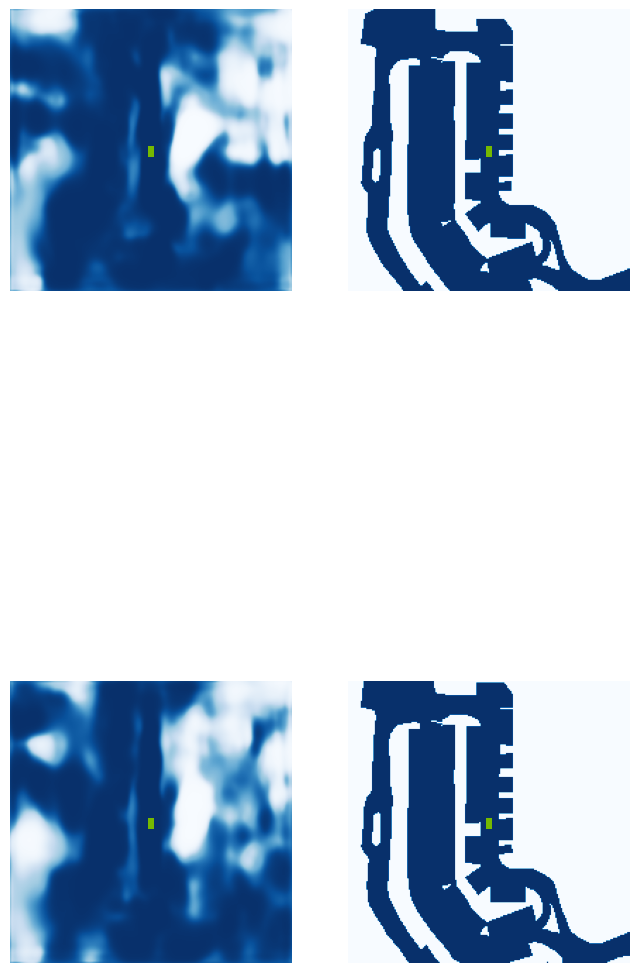

 42%|████▎     | 17/40 [00:04<00:05,  4.38it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.51.jpg


 50%|█████     | 20/40 [00:05<00:03,  5.47it/s]

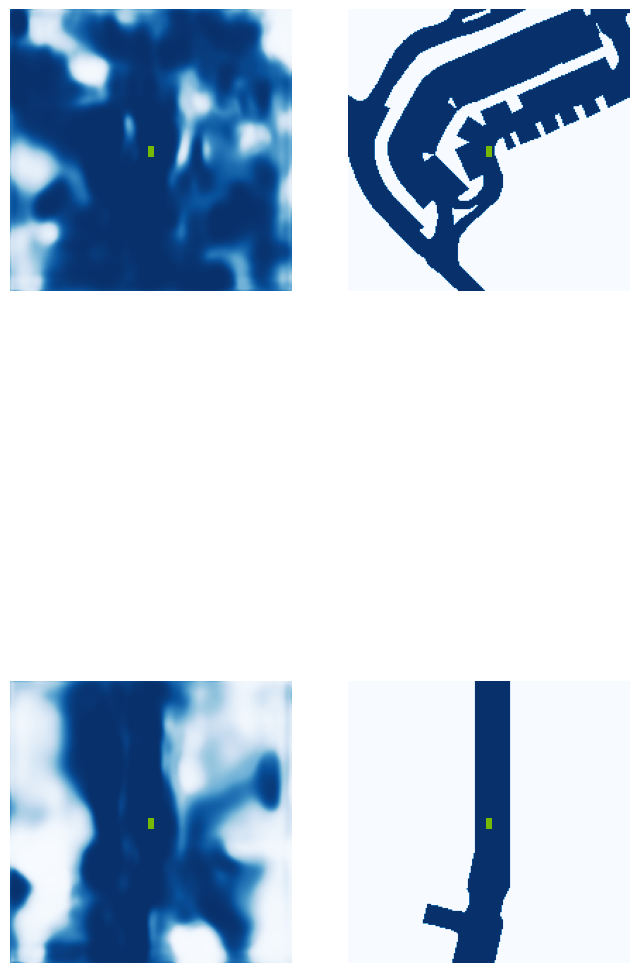

 55%|█████▌    | 22/40 [00:05<00:04,  4.10it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.35.jpg


 62%|██████▎   | 25/40 [00:06<00:02,  6.00it/s]

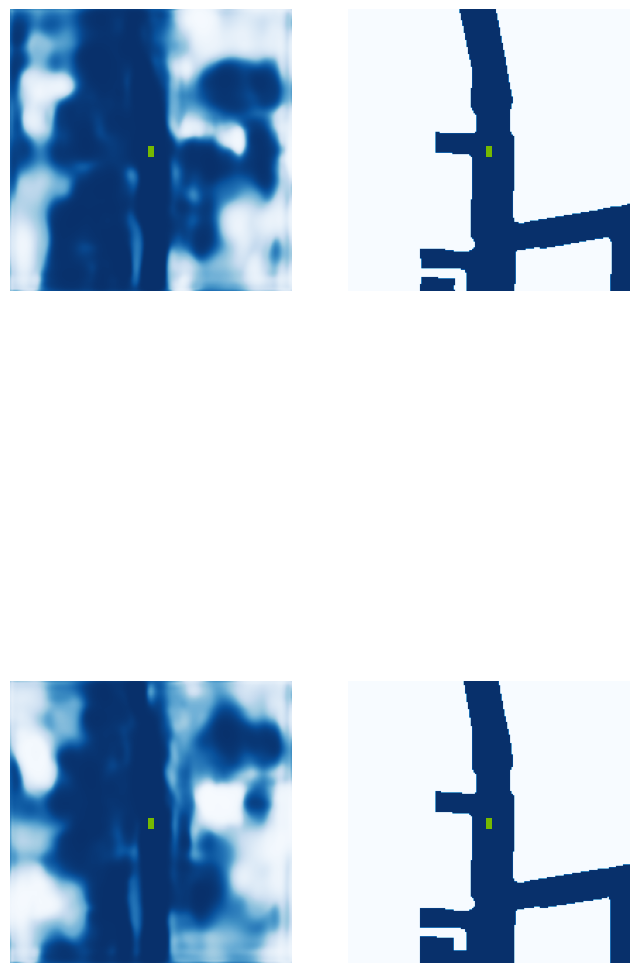

 68%|██████▊   | 27/40 [00:06<00:02,  4.92it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.27.jpg


 75%|███████▌  | 30/40 [00:07<00:01,  6.89it/s]

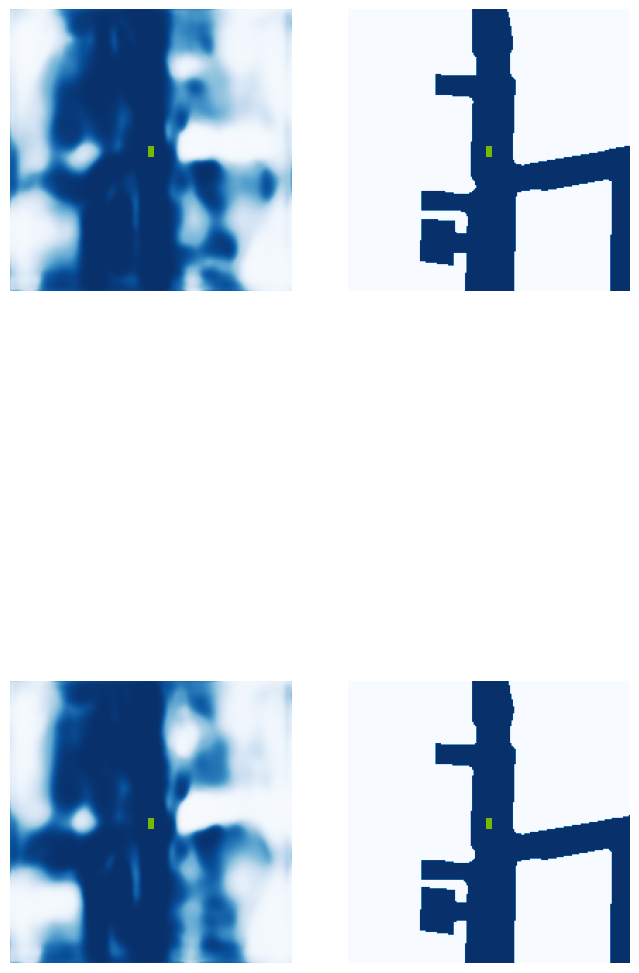

 80%|████████  | 32/40 [00:07<00:01,  4.47it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.36.jpg


 88%|████████▊ | 35/40 [00:08<00:00,  6.62it/s]

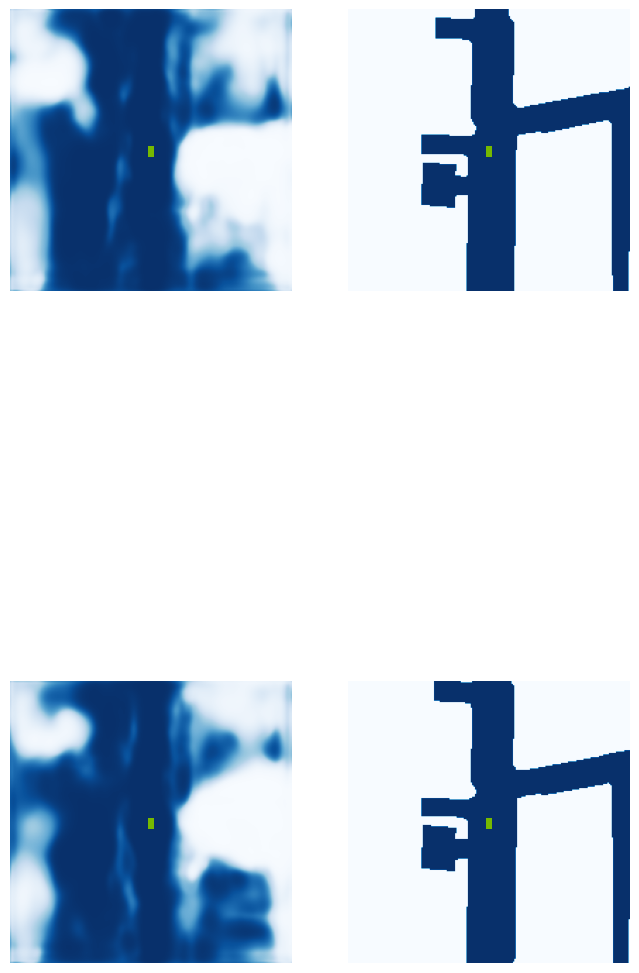

 92%|█████████▎| 37/40 [00:08<00:00,  4.89it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.34.jpg


100%|██████████| 40/40 [00:09<00:00,  4.40it/s]


VAL {'loss': 1.6140155497892403, 'iou': 0.3593617220485887}
saving ...  ./runs/model4000.pt
4010 0.3174129128456116
4020 0.20006486773490906
Epoch: 26/60
4030 0.45317161083221436
4040 0.17961063981056213
4050 0.22993573546409607
4060 0.1503576934337616
4070 0.1458655446767807
4080 0.20480428636074066
4090 0.2901833951473236
4100 0.1311536580324173
4110 0.11181092262268066
4120 0.16605418920516968
4130 0.12183940410614014
4140 0.30393606424331665
4150 0.15892408788204193
4160 0.12267249077558517
4170 0.2158012092113495
4180 0.19371508061885834
Epoch: 27/60
4190 0.24555638432502747
4200 0.24455448985099792
4210 0.19007621705532074
4220 0.29063716530799866
4230 0.2373877316713333
4240 0.19631578028202057
4250 0.1346890926361084
4260 0.14537443220615387
4270 0.16079315543174744
4280 0.21075639128684998
4290 0.19015435874462128
4300 0.1616845726966858
4310 0.224199578166008
4320 0.16240821778774261
4330 0.10222254693508148
4340 0.12093599885702133
Epoch: 28/60
4350 0.19077962636947632
4360 

  0%|          | 0/40 [00:00<?, ?it/s]

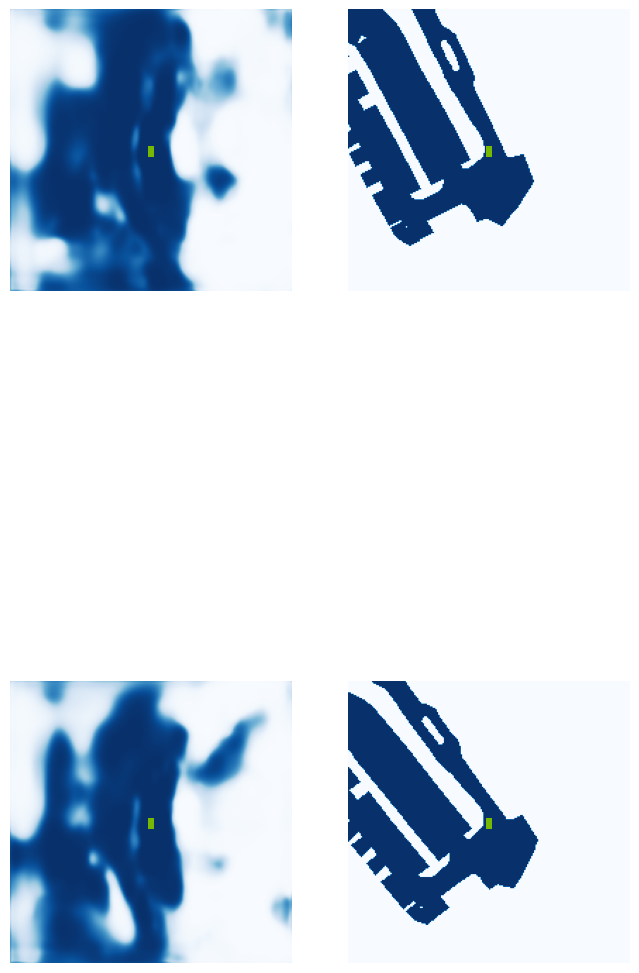

  5%|▌         | 2/40 [00:01<00:20,  1.86it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.37.jpg


 12%|█▎        | 5/40 [00:01<00:08,  4.15it/s]

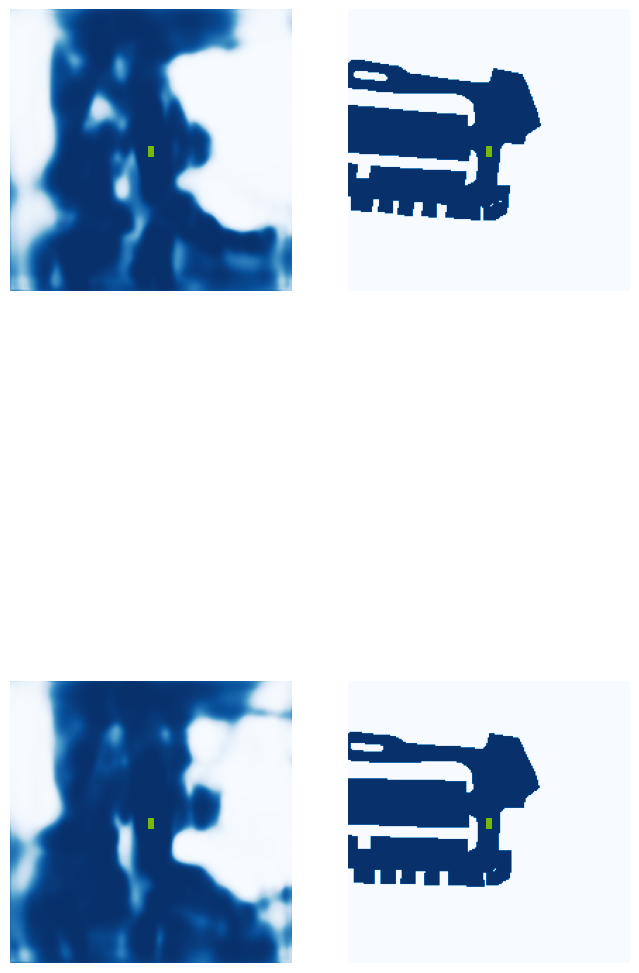

 18%|█▊        | 7/40 [00:02<00:08,  4.09it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.27.jpg


 25%|██▌       | 10/40 [00:02<00:05,  5.19it/s]

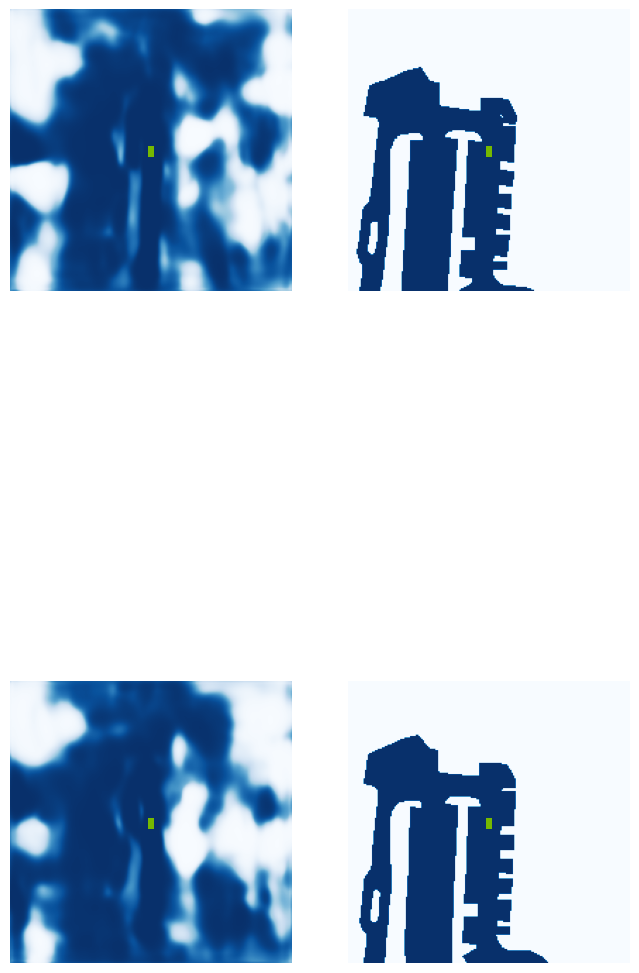

 30%|███       | 12/40 [00:03<00:07,  3.69it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.36.jpg


 38%|███▊      | 15/40 [00:04<00:05,  4.50it/s]

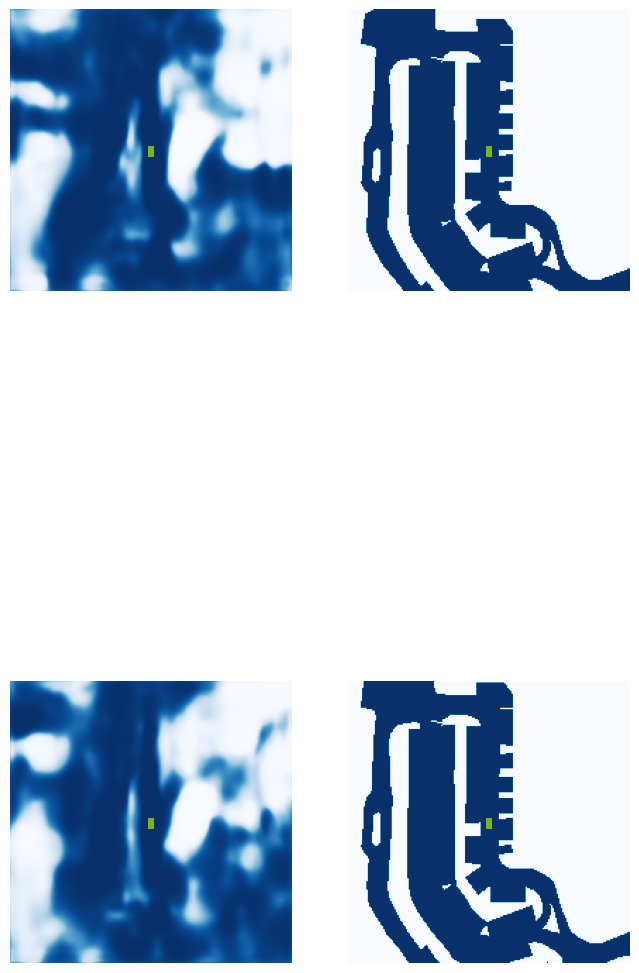

 42%|████▎     | 17/40 [00:04<00:05,  4.32it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.50.jpg


 50%|█████     | 20/40 [00:05<00:03,  5.17it/s]

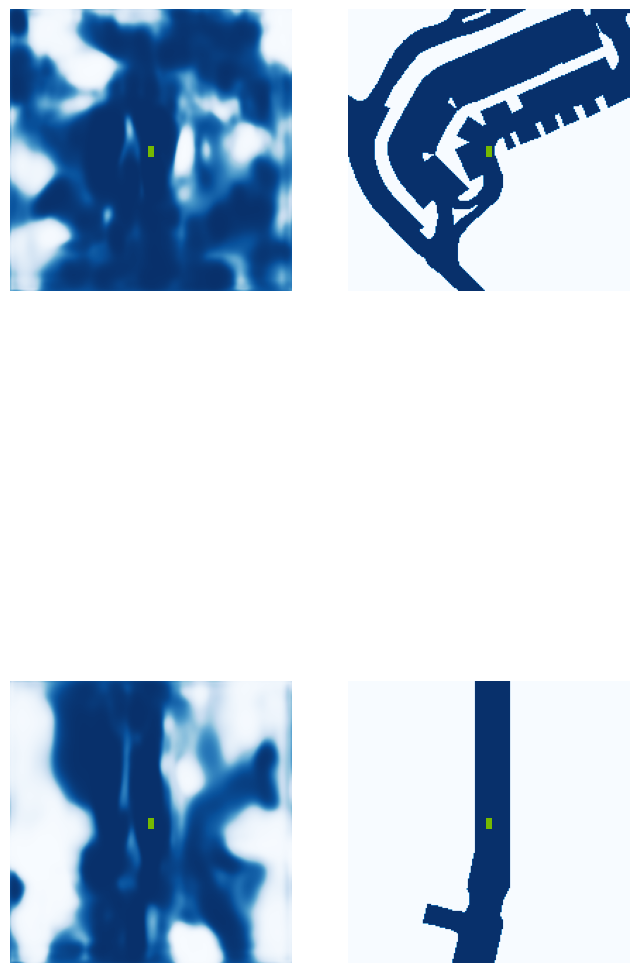

 55%|█████▌    | 22/40 [00:05<00:04,  4.10it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.33.jpg


 62%|██████▎   | 25/40 [00:06<00:02,  6.33it/s]

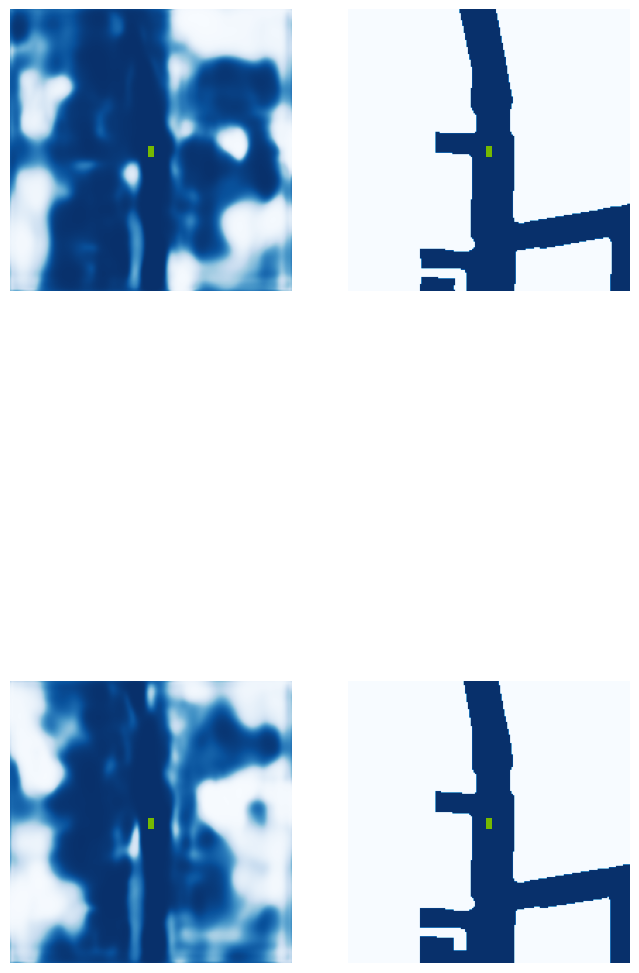

 68%|██████▊   | 27/40 [00:06<00:02,  4.70it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.27.jpg


 75%|███████▌  | 30/40 [00:07<00:01,  6.09it/s]

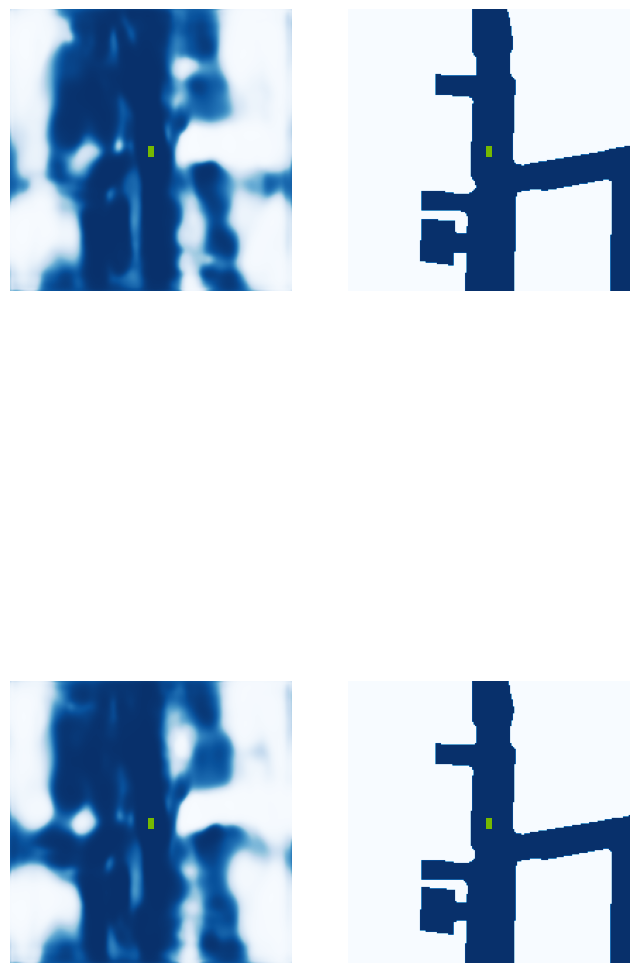

 80%|████████  | 32/40 [00:07<00:01,  4.44it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.35.jpg


 88%|████████▊ | 35/40 [00:08<00:00,  6.38it/s]

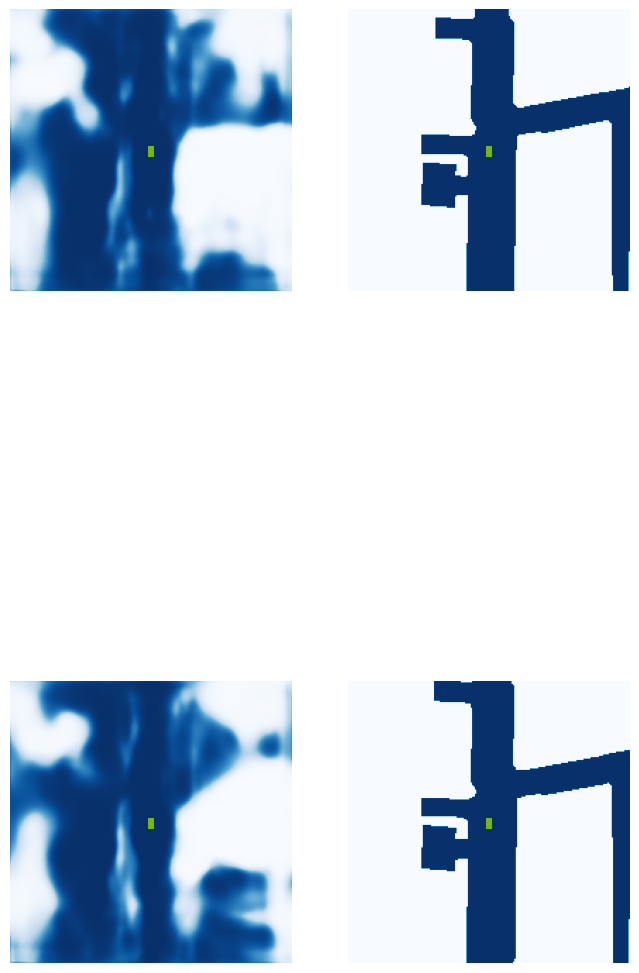

 92%|█████████▎| 37/40 [00:08<00:00,  4.91it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.34.jpg


100%|██████████| 40/40 [00:09<00:00,  4.43it/s]


VAL {'loss': 1.4673104403931418, 'iou': 0.355525313060518}
saving ...  ./runs/model4500.pt
Epoch: 29/60
4510 0.13954617083072662
4520 0.28800609707832336
4530 0.12103088200092316
4540 0.2549954652786255
4550 0.2518399953842163
4560 0.23141594231128693
4570 0.17203746736049652
4580 0.16351164877414703
4590 0.20876778662204742
4600 0.18985500931739807
4610 0.21195288002490997
4620 0.2706122100353241
4630 0.25226128101348877
4640 0.1616288423538208
4650 0.24594056606292725
4660 0.1392374038696289
Epoch: 30/60
4670 0.17873752117156982
4680 0.19385193288326263
4690 0.15603919327259064
4700 0.12476007640361786
4710 0.12669862806797028
4720 0.1340373009443283
4730 0.1675771027803421
4740 0.18807971477508545
4750 0.14702986180782318
4760 0.1912945955991745
4770 0.1714647114276886
4780 0.23013529181480408
4790 0.3152458071708679
4800 0.22413861751556396
4810 0.15558212995529175
4820 0.09249729663133621
4830 0.08145558834075928
Epoch: 31/60
4840 0.225474014878273
4850 0.23932738602161407
4860 0.

  0%|          | 0/40 [00:00<?, ?it/s]

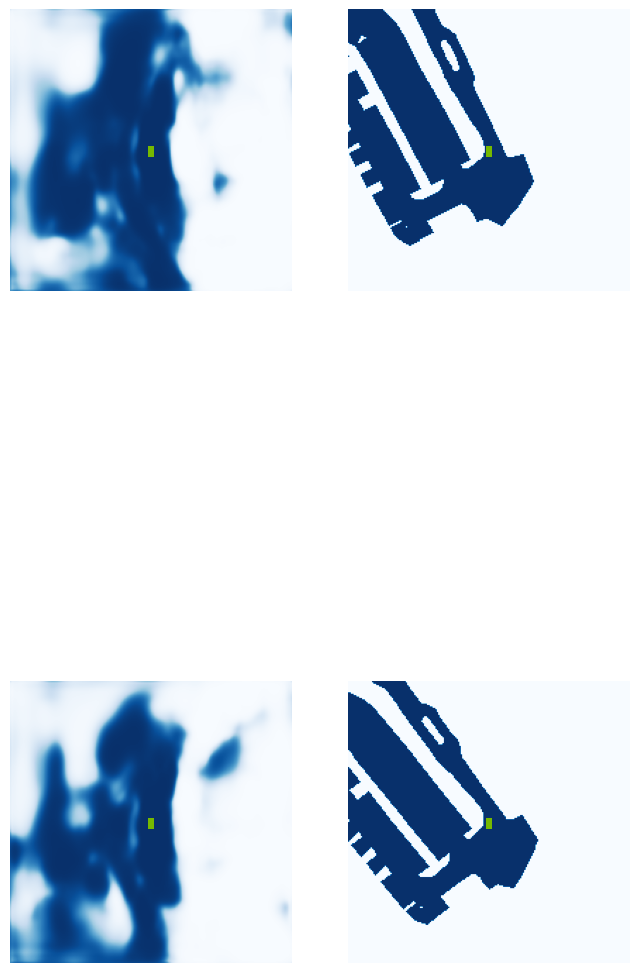

  5%|▌         | 2/40 [00:01<00:20,  1.82it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.36.jpg


 12%|█▎        | 5/40 [00:01<00:09,  3.80it/s]

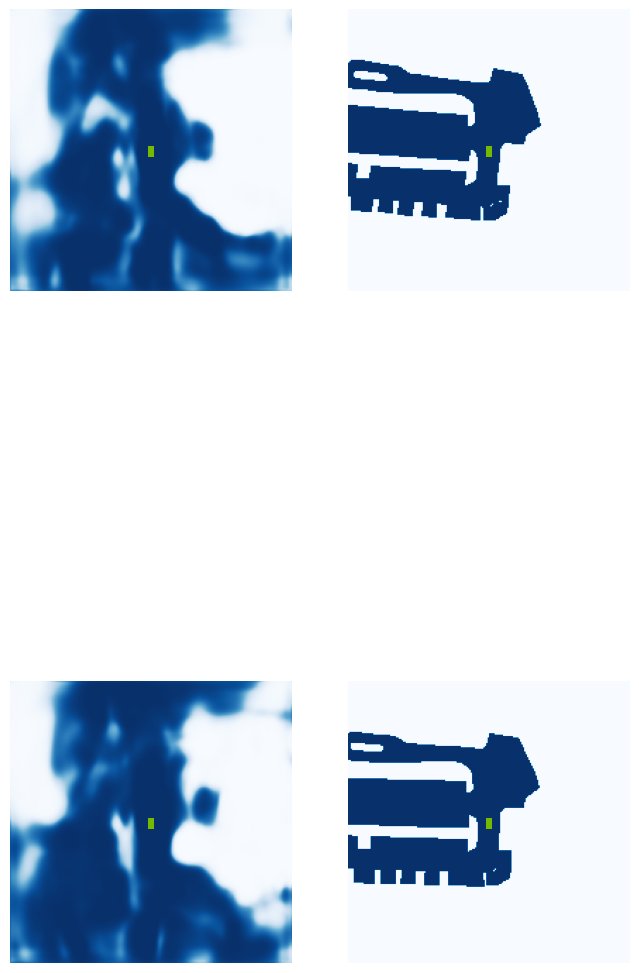

 18%|█▊        | 7/40 [00:02<00:08,  3.84it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.26.jpg


 25%|██▌       | 10/40 [00:02<00:05,  5.28it/s]

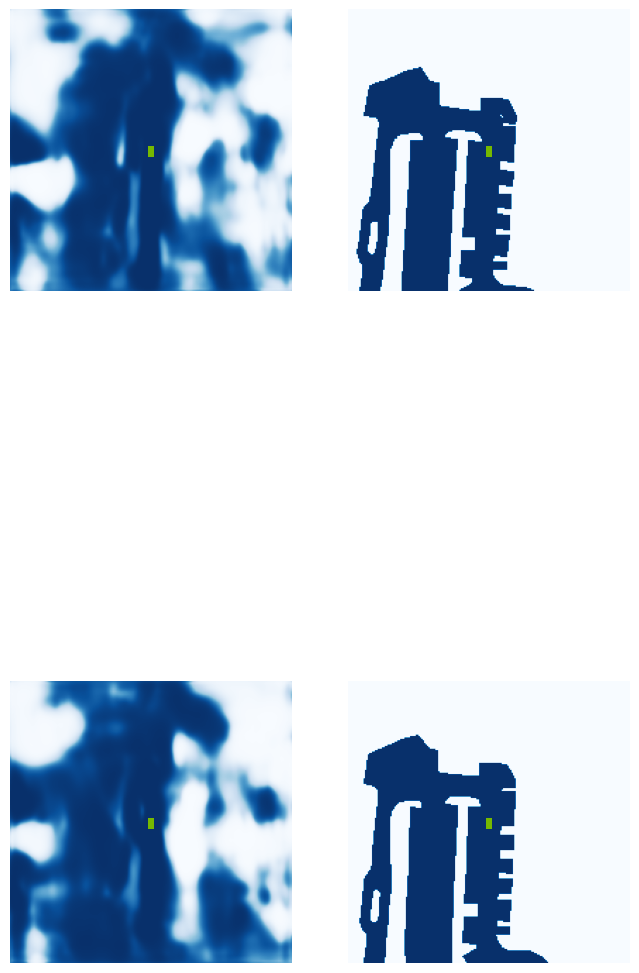

 32%|███▎      | 13/40 [00:03<00:05,  4.58it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.40.jpg


 38%|███▊      | 15/40 [00:04<00:05,  4.44it/s]

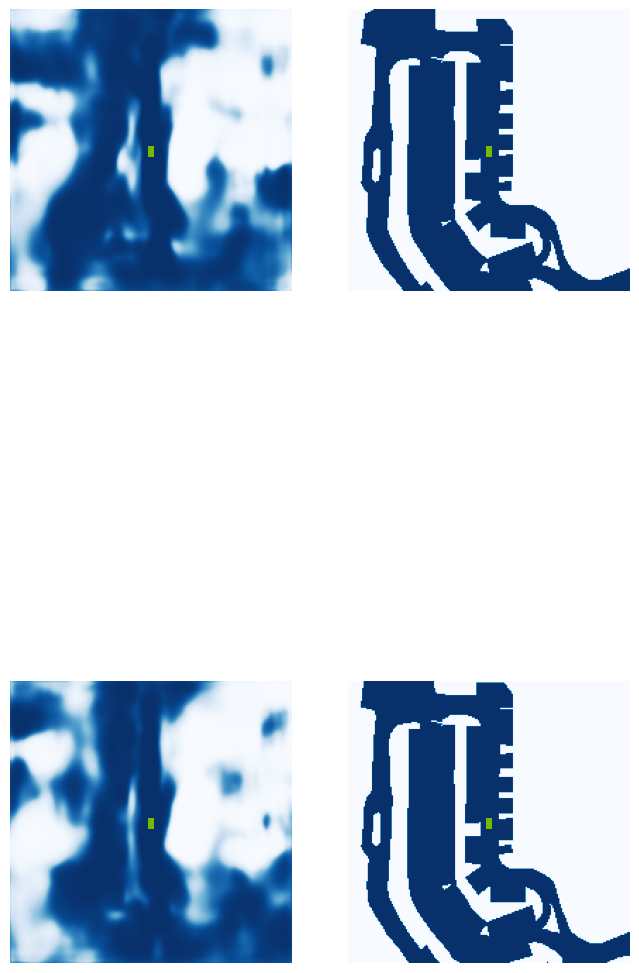

 42%|████▎     | 17/40 [00:04<00:05,  4.31it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.52.jpg


 50%|█████     | 20/40 [00:05<00:03,  5.44it/s]

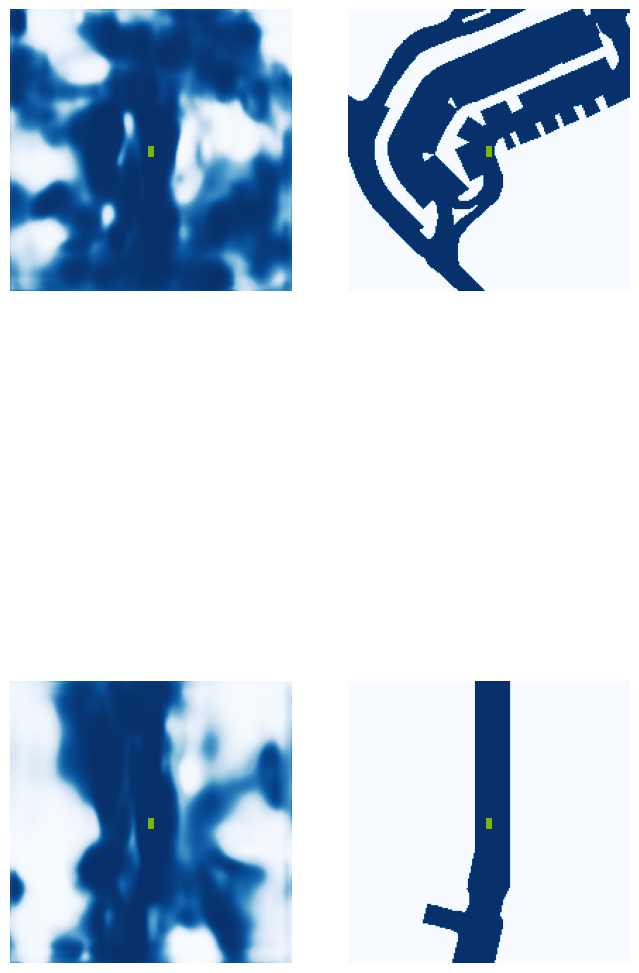

 55%|█████▌    | 22/40 [00:05<00:04,  3.89it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.34.jpg


 62%|██████▎   | 25/40 [00:06<00:02,  5.63it/s]

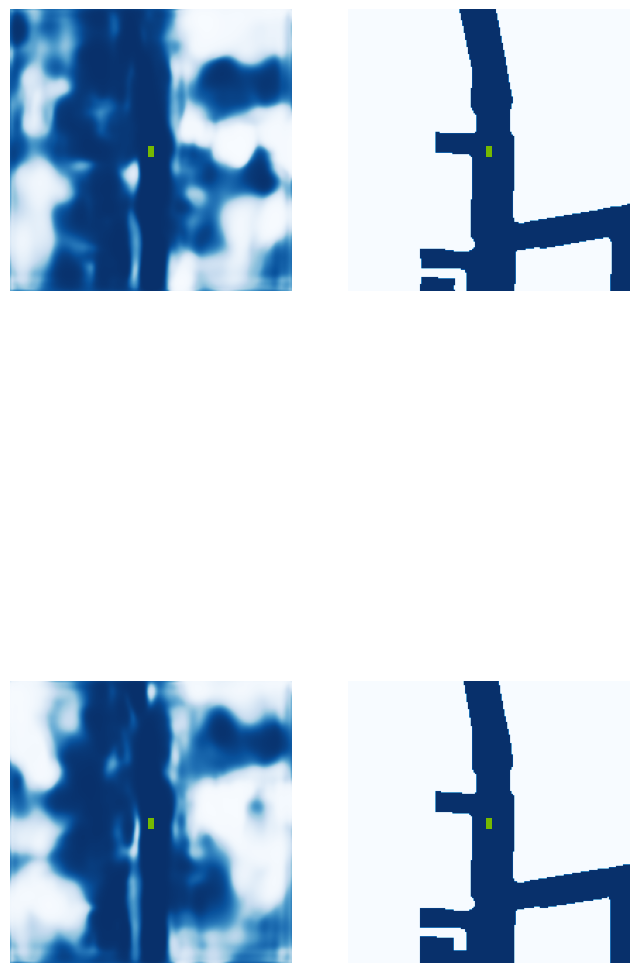

 68%|██████▊   | 27/40 [00:06<00:02,  4.64it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.31.jpg


 72%|███████▎  | 29/40 [00:07<00:01,  5.94it/s]

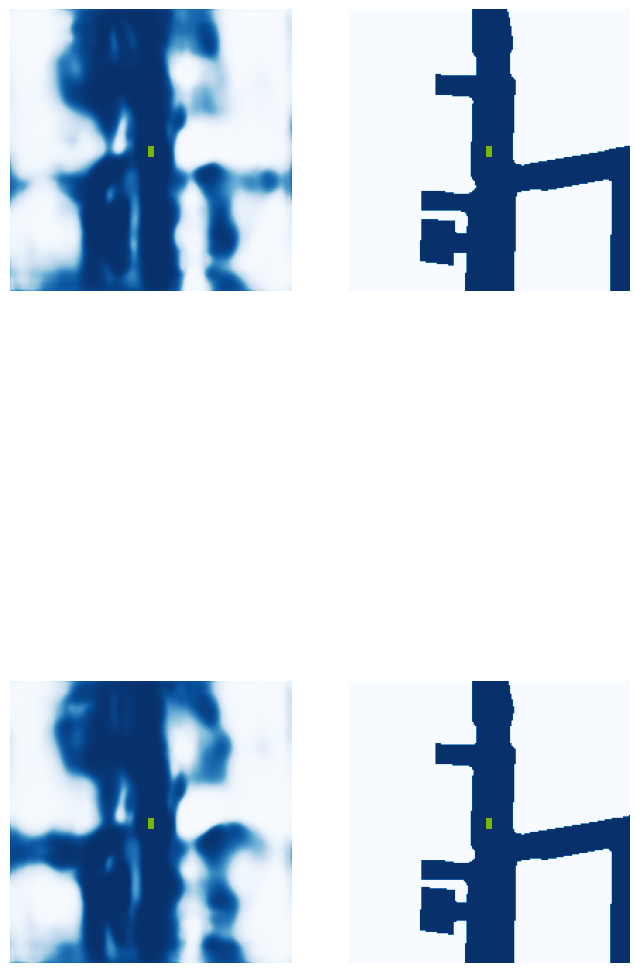

 82%|████████▎ | 33/40 [00:07<00:01,  5.34it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.41.jpg


 88%|████████▊ | 35/40 [00:08<00:00,  6.39it/s]

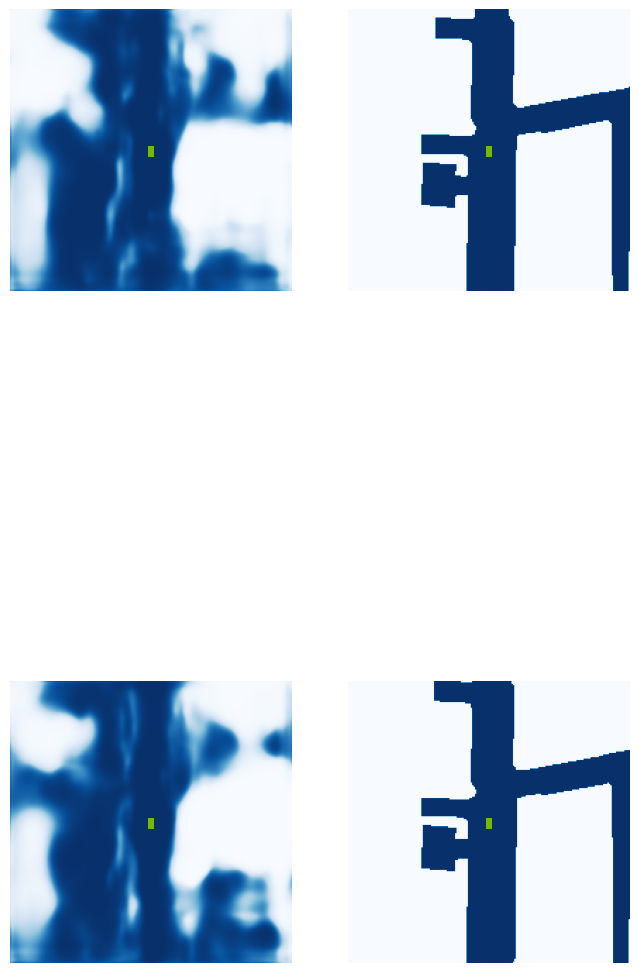

 92%|█████████▎| 37/40 [00:08<00:00,  5.20it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.35.jpg


100%|██████████| 40/40 [00:09<00:00,  4.40it/s]


VAL {'loss': 1.3159592858067266, 'iou': 0.37884562925667914}
saving ...  ./runs/model5000.pt
5010 0.22866103053092957
5020 0.2418443262577057
5030 0.14592282474040985
5040 0.07635511457920074
5050 0.1913994997739792
5060 0.1401565819978714
5070 0.09508204460144043
5080 0.18986615538597107
5090 0.1730985939502716
5100 0.4436757266521454
5110 0.1742647886276245
5120 0.17440876364707947
5130 0.24093227088451385
5140 0.11193305253982544
5150 0.21601390838623047
Epoch: 33/60
5160 0.13359203934669495
5170 0.09804782271385193
5180 0.24729487299919128
5190 0.10285929590463638
5200 0.1397504061460495
5210 0.1966519057750702
5220 0.12797990441322327
5230 0.22503338754177094
5240 0.15853333473205566
5250 0.1290436089038849
5260 0.25307077169418335
5270 0.28066226840019226
5280 0.087615467607975
5290 0.24467270076274872
5300 0.1886184960603714
5310 0.21622514724731445
Epoch: 34/60
5320 0.11434997618198395
5330 0.18778617680072784
5340 0.20979256927967072
5350 0.2181817889213562
5360 0.133864074945

  0%|          | 0/40 [00:00<?, ?it/s]

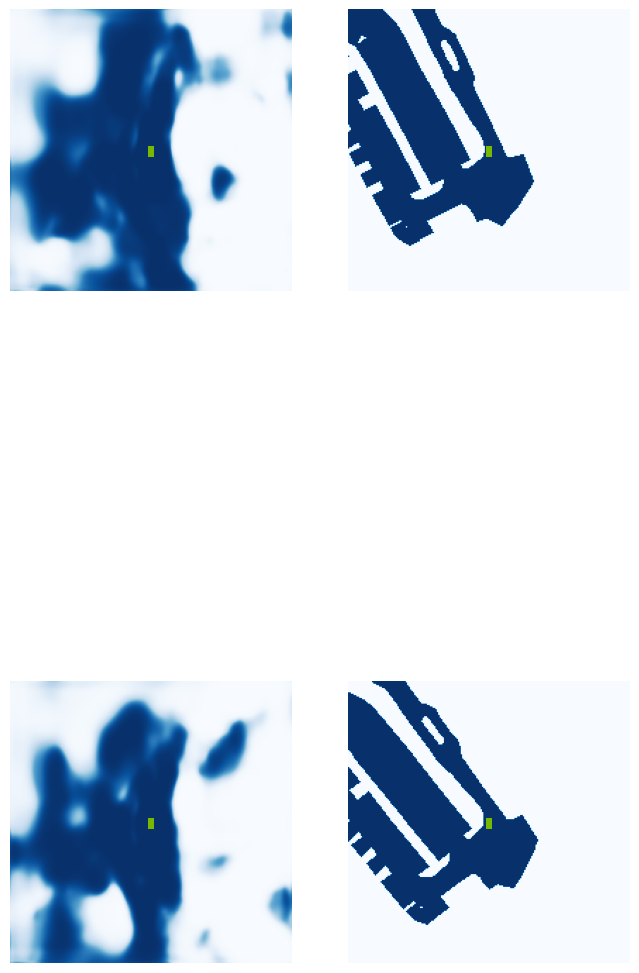

  5%|▌         | 2/40 [00:01<00:20,  1.83it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.37.jpg


 12%|█▎        | 5/40 [00:01<00:09,  3.78it/s]

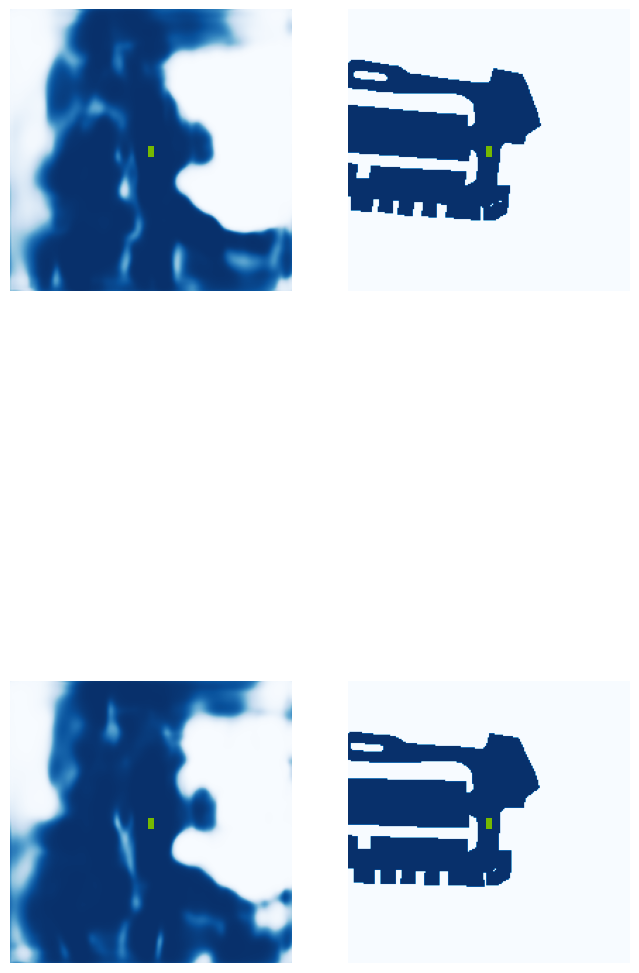

 18%|█▊        | 7/40 [00:02<00:08,  4.04it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.28.jpg


 25%|██▌       | 10/40 [00:02<00:05,  5.10it/s]

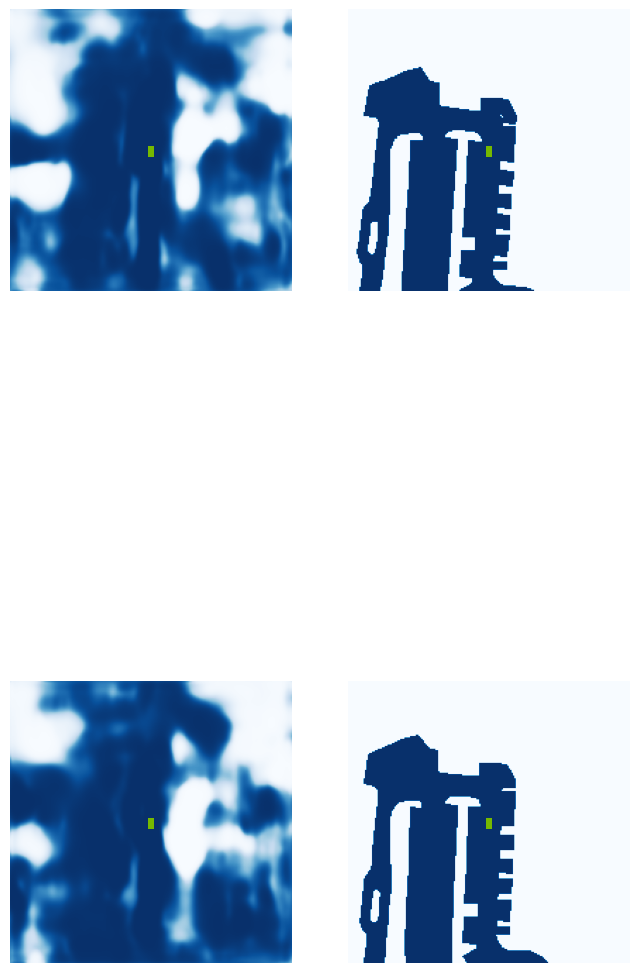

 30%|███       | 12/40 [00:03<00:07,  3.82it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.35.jpg


 38%|███▊      | 15/40 [00:04<00:05,  4.82it/s]

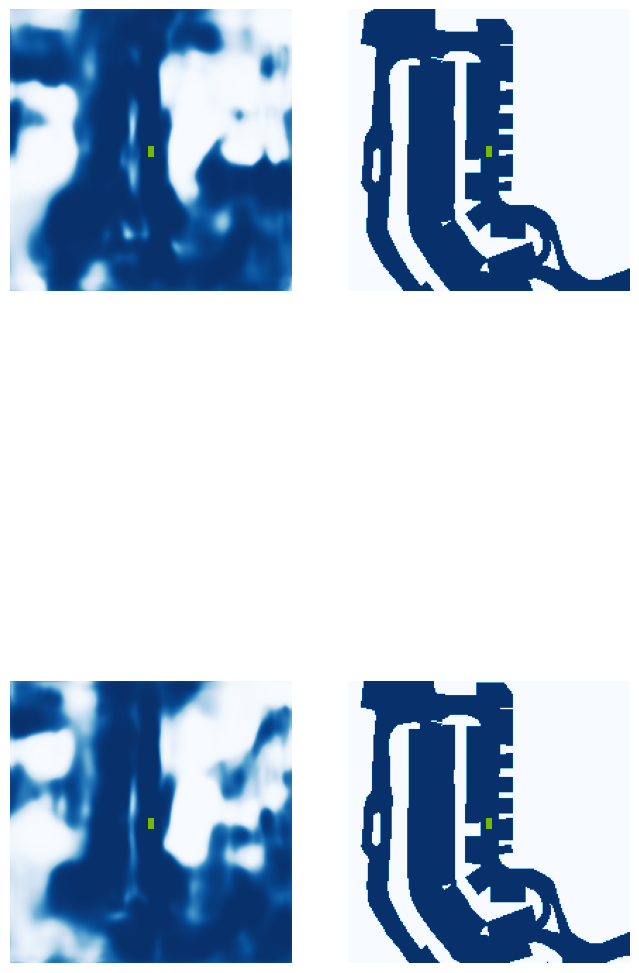

 42%|████▎     | 17/40 [00:04<00:05,  4.59it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.50.jpg


 50%|█████     | 20/40 [00:05<00:03,  5.36it/s]

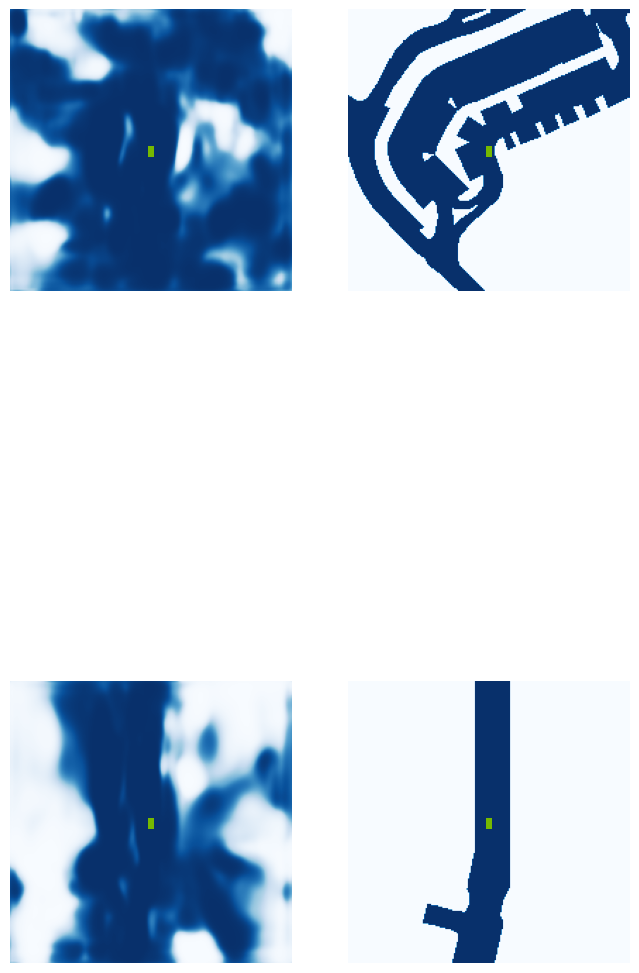

 52%|█████▎    | 21/40 [00:05<00:06,  3.16it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.34.jpg


 62%|██████▎   | 25/40 [00:06<00:02,  5.28it/s]

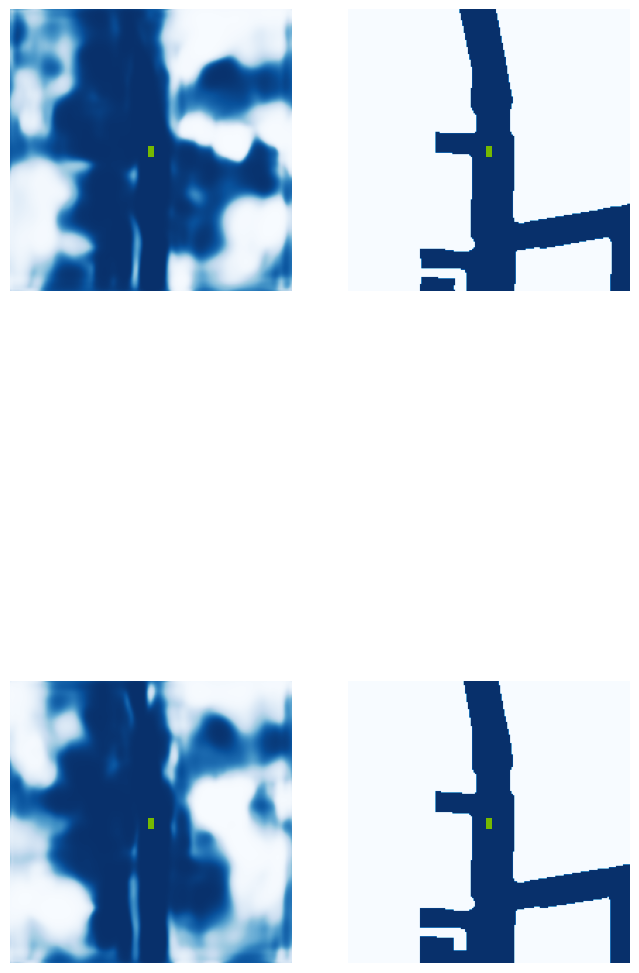

 68%|██████▊   | 27/40 [00:06<00:02,  4.91it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.31.jpg


 72%|███████▎  | 29/40 [00:07<00:02,  5.34it/s]

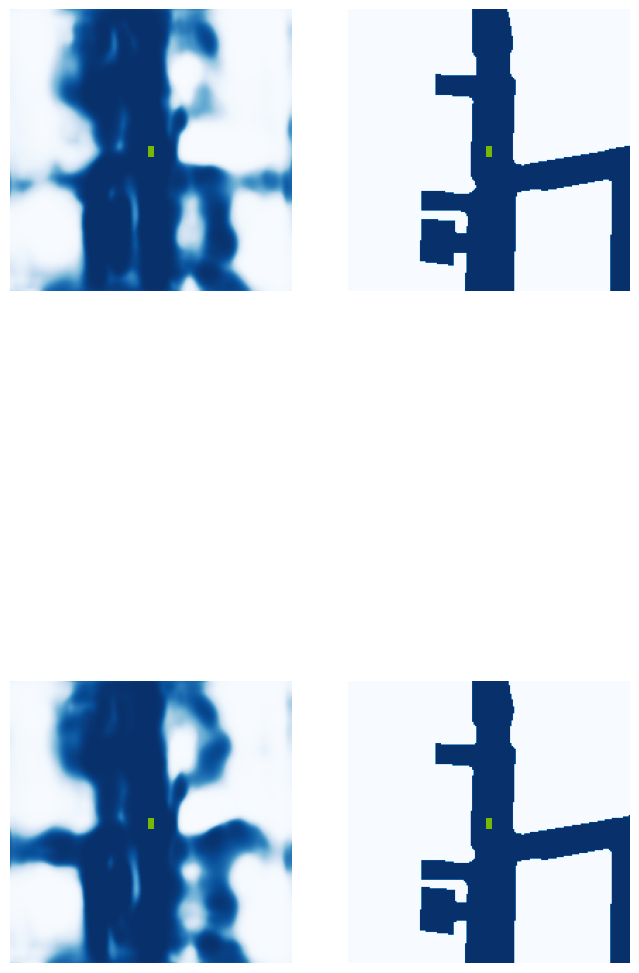

 82%|████████▎ | 33/40 [00:07<00:01,  5.17it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.40.jpg


 88%|████████▊ | 35/40 [00:08<00:00,  5.83it/s]

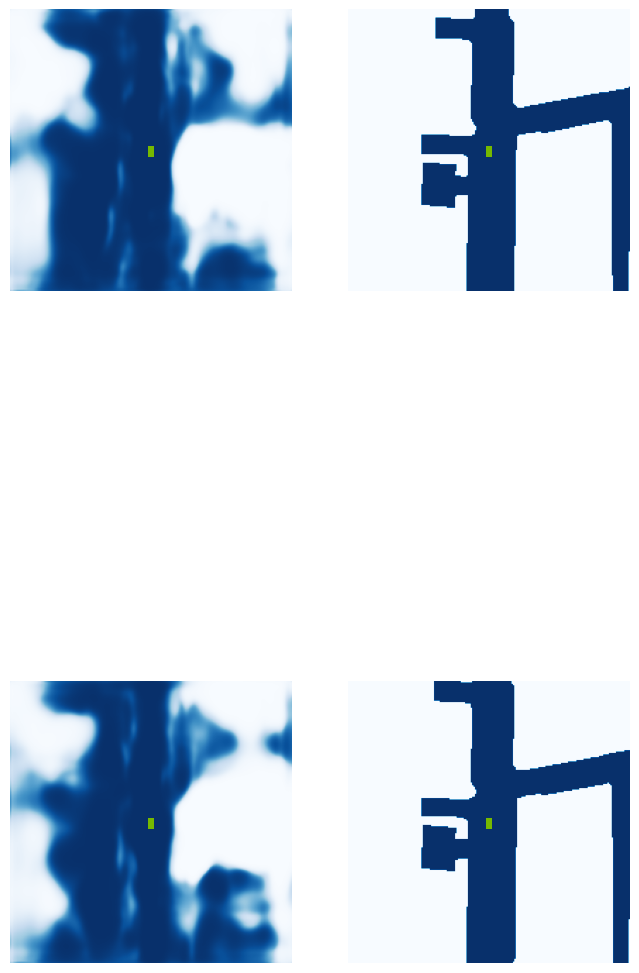

 95%|█████████▌| 38/40 [00:08<00:00,  5.72it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.34.jpg


100%|██████████| 40/40 [00:09<00:00,  4.43it/s]


VAL {'loss': 1.5446717768539617, 'iou': 0.3726434972627007}
saving ...  ./runs/model5500.pt
5510 0.10131170600652695
5520 0.15357376635074615
5530 0.26003798842430115
5540 0.21645104885101318
5550 0.14207446575164795
5560 0.07958512008190155
5570 0.06401410698890686
5580 0.34792107343673706
5590 0.17907372117042542
5600 0.23578202724456787
5610 0.17368441820144653
5620 0.2615169286727905
5630 0.24465958774089813
Epoch: 36/60
5640 0.08807434886693954
5650 0.17513634264469147
5660 0.09208321571350098
5670 0.29055169224739075
5680 0.07740696519613266
5690 0.2009158432483673
5700 0.17322756350040436
5710 0.21233080327510834
5720 0.1630515605211258
5730 0.1356060951948166
5740 0.14120395481586456
5750 0.09316486865282059
5760 0.15913456678390503
5770 0.195567786693573
5780 0.17528292536735535
5790 0.13926871120929718
Epoch: 37/60
5800 0.07725437730550766
5810 0.10461604595184326
5820 0.13468322157859802
5830 0.12274650484323502
5840 0.16643774509429932
5850 0.18626172840595245
5860 0.155506

  0%|          | 0/40 [00:00<?, ?it/s]

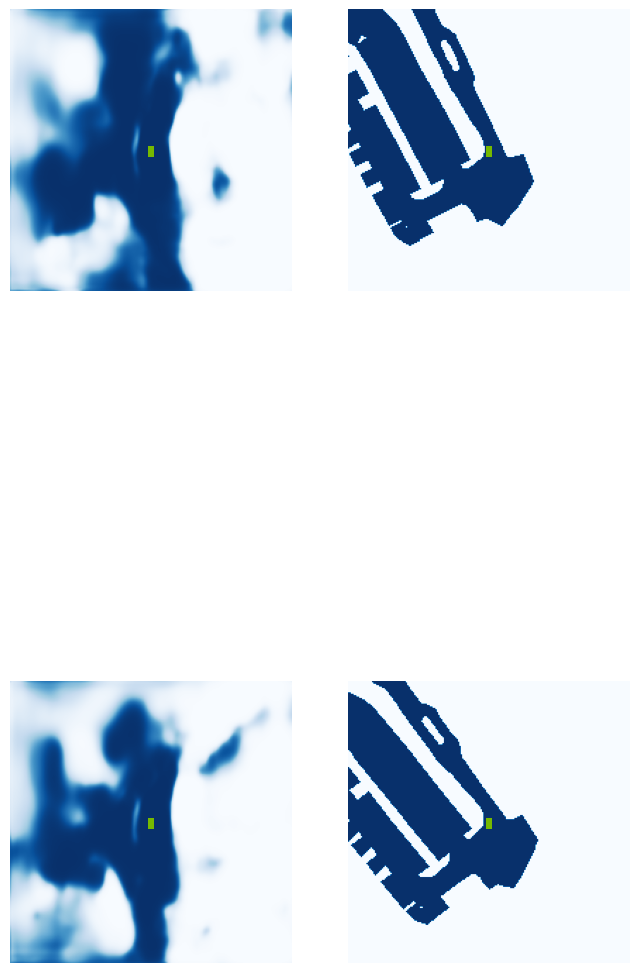

  5%|▌         | 2/40 [00:01<00:21,  1.75it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.38.jpg


 12%|█▎        | 5/40 [00:01<00:07,  4.54it/s]

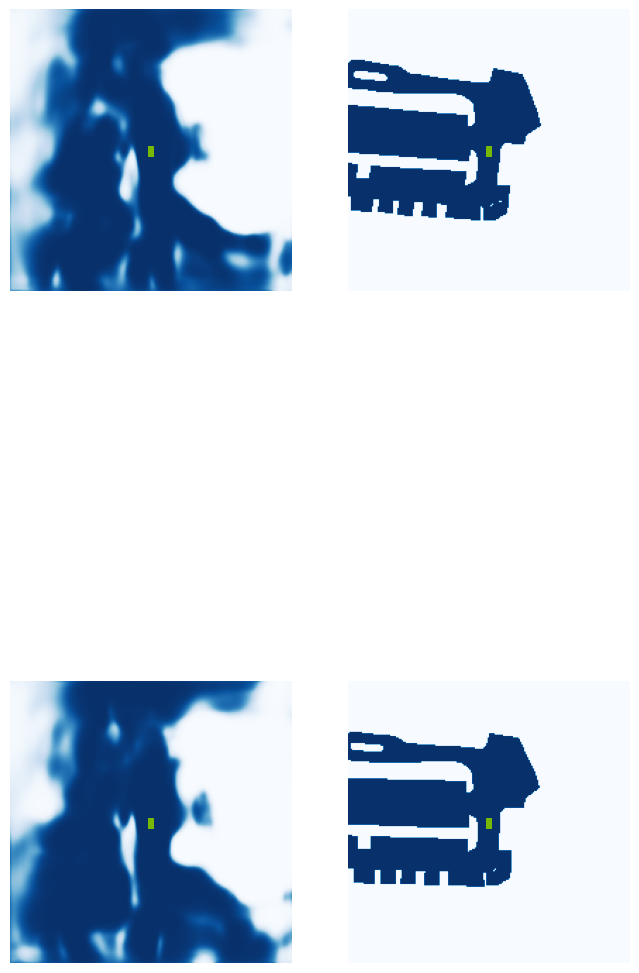

 18%|█▊        | 7/40 [00:02<00:07,  4.46it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.28.jpg


 25%|██▌       | 10/40 [00:02<00:06,  4.96it/s]

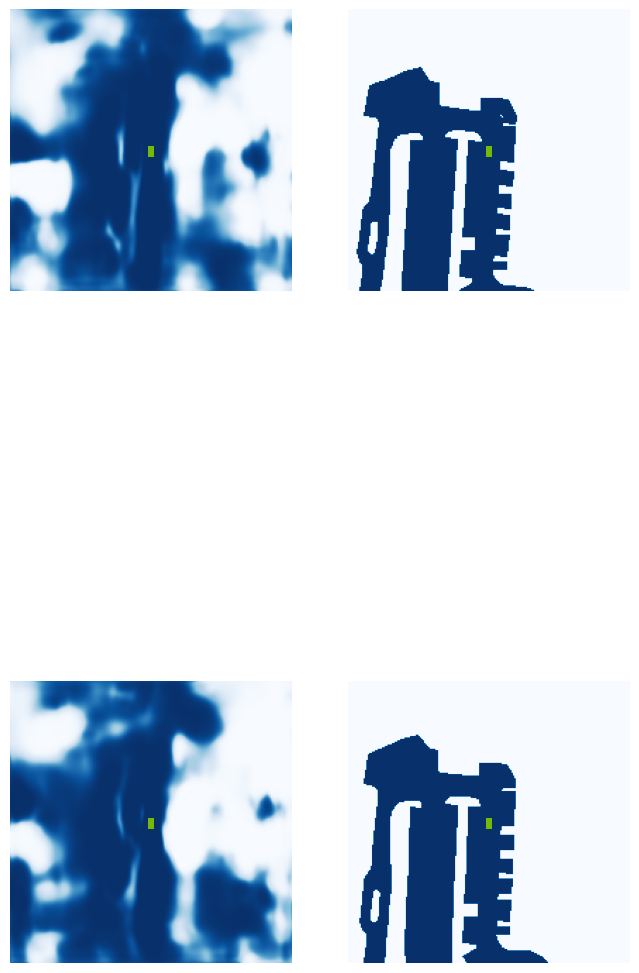

 30%|███       | 12/40 [00:03<00:07,  3.73it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.40.jpg


 38%|███▊      | 15/40 [00:04<00:05,  4.45it/s]

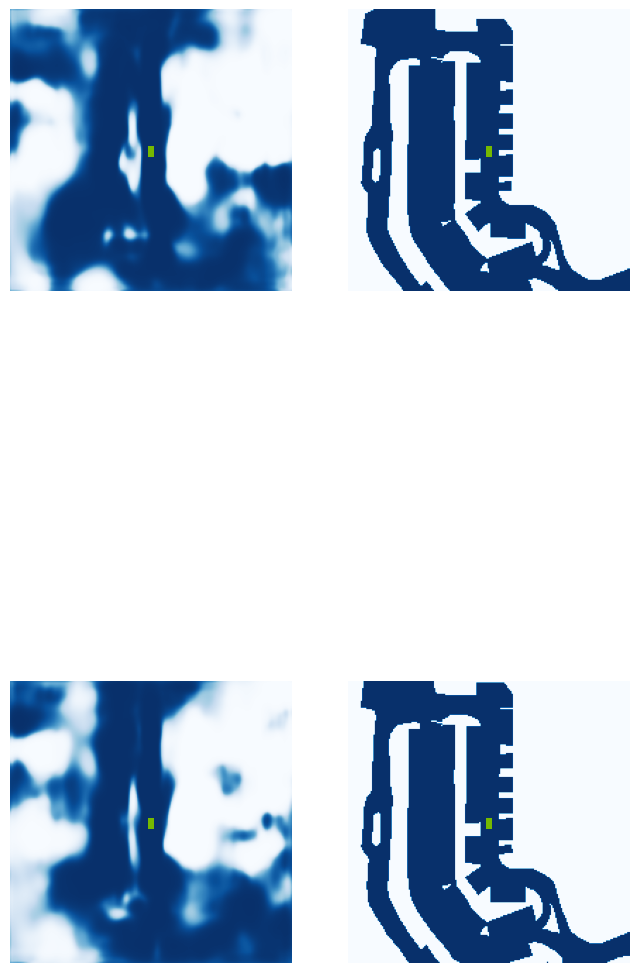

 42%|████▎     | 17/40 [00:04<00:05,  4.39it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.51.jpg


 50%|█████     | 20/40 [00:05<00:03,  5.39it/s]

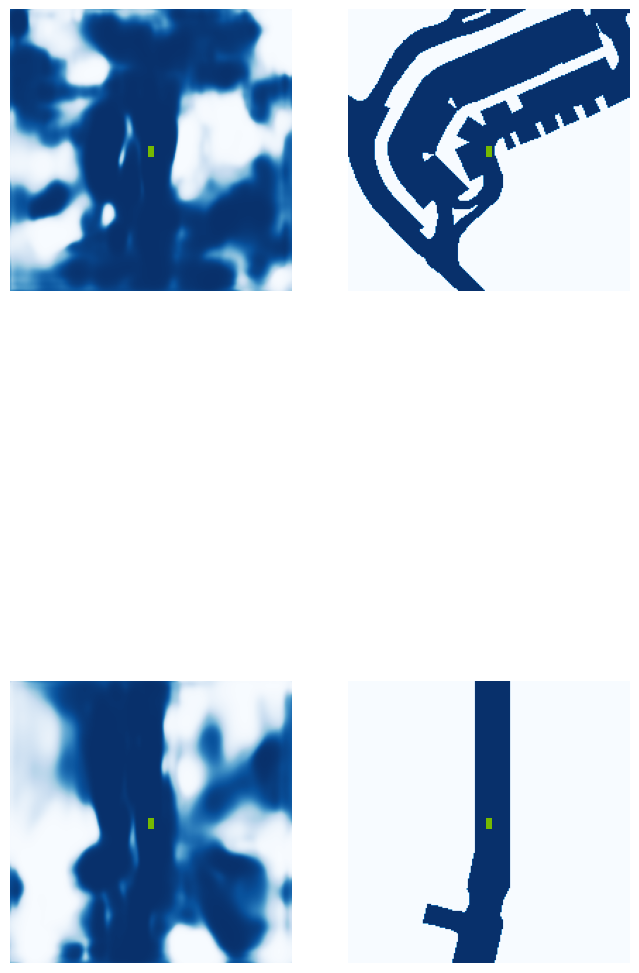

 55%|█████▌    | 22/40 [00:05<00:04,  3.87it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.32.jpg


 62%|██████▎   | 25/40 [00:06<00:02,  6.14it/s]

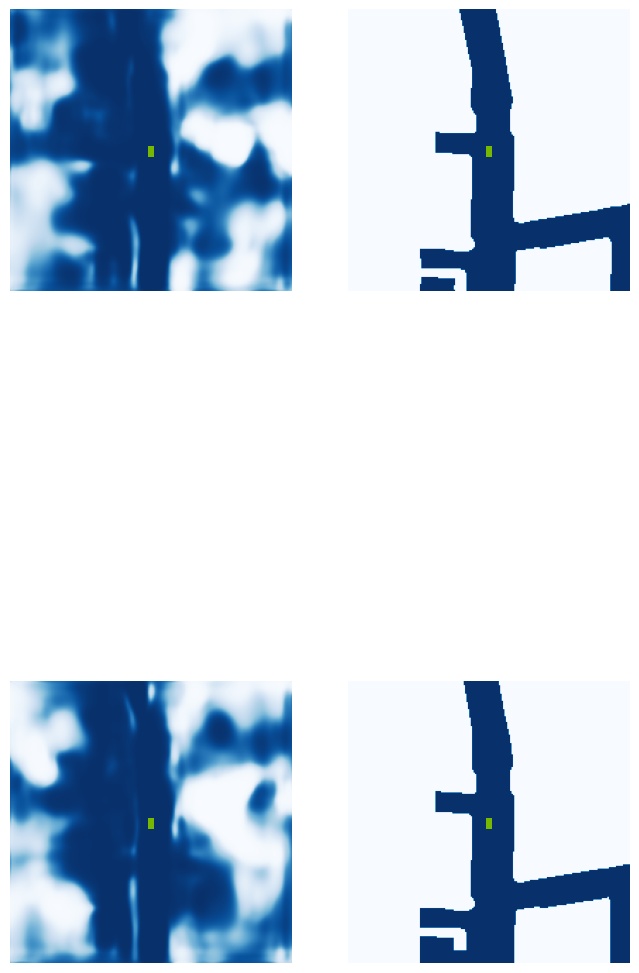

 68%|██████▊   | 27/40 [00:06<00:02,  4.99it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.30.jpg


 75%|███████▌  | 30/40 [00:07<00:01,  7.06it/s]

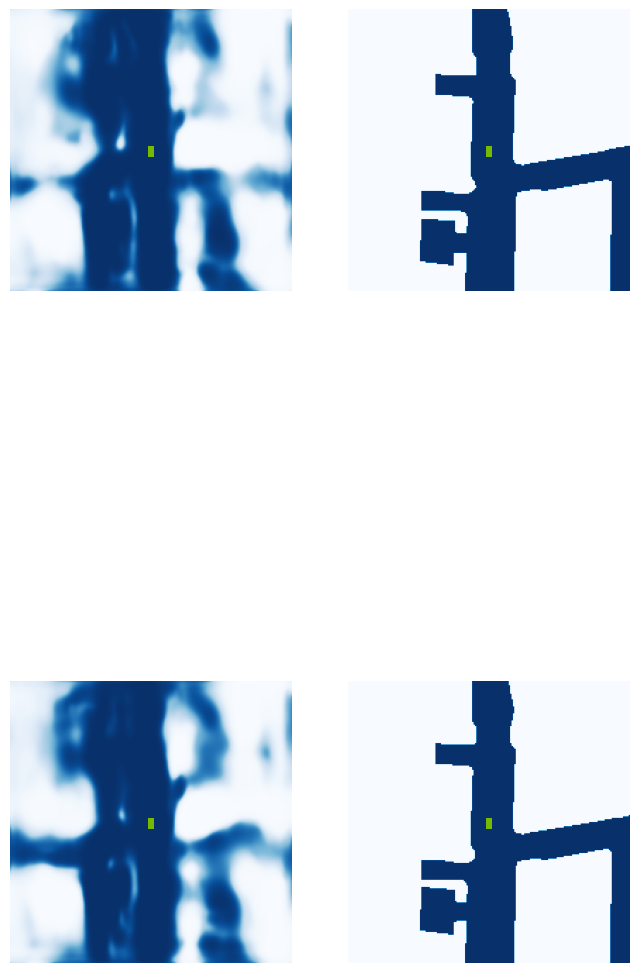

 80%|████████  | 32/40 [00:07<00:01,  4.37it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.40.jpg


 88%|████████▊ | 35/40 [00:08<00:00,  6.85it/s]

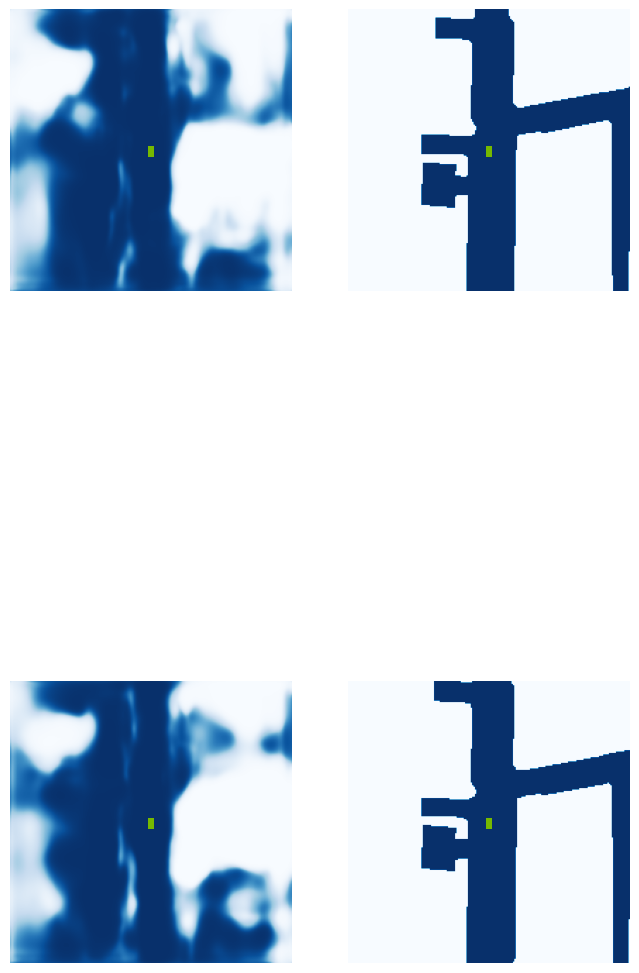

 92%|█████████▎| 37/40 [00:08<00:00,  5.09it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.32.jpg


100%|██████████| 40/40 [00:08<00:00,  4.45it/s]


VAL {'loss': 1.4830623909279153, 'iou': 0.3772292187346206}
saving ...  ./runs/model6000.pt
6010 0.1240687444806099
6020 0.12001246958971024
6030 0.10580339282751083
6040 0.183913454413414
6050 0.09241915494203568
6060 0.07824069261550903
6070 0.15828709304332733
6080 0.1042804941534996
6090 0.21341899037361145
6100 0.21501424908638
6110 0.13555291295051575
Epoch: 39/60
6120 0.1085716038942337
6130 0.10067867487668991
6140 0.22676503658294678
6150 0.1511751115322113
6160 0.1188187450170517
6170 0.14361347258090973
6180 0.21022260189056396
6190 0.08947494626045227
6200 0.15015468001365662
6210 0.10379599034786224
6220 0.12841810286045074
6230 0.09707343578338623
6240 0.20384451746940613
6250 0.09808143973350525
6260 0.1320677101612091
6270 0.11659655719995499
Epoch: 40/60
6280 0.1324792504310608
6290 0.17354132235050201
6300 0.09626265615224838
6310 0.17709088325500488
6320 0.1392020285129547
6330 0.13906405866146088
6340 0.09686414897441864
6350 0.08758992701768875
6360 0.1603181213140

  0%|          | 0/40 [00:00<?, ?it/s]

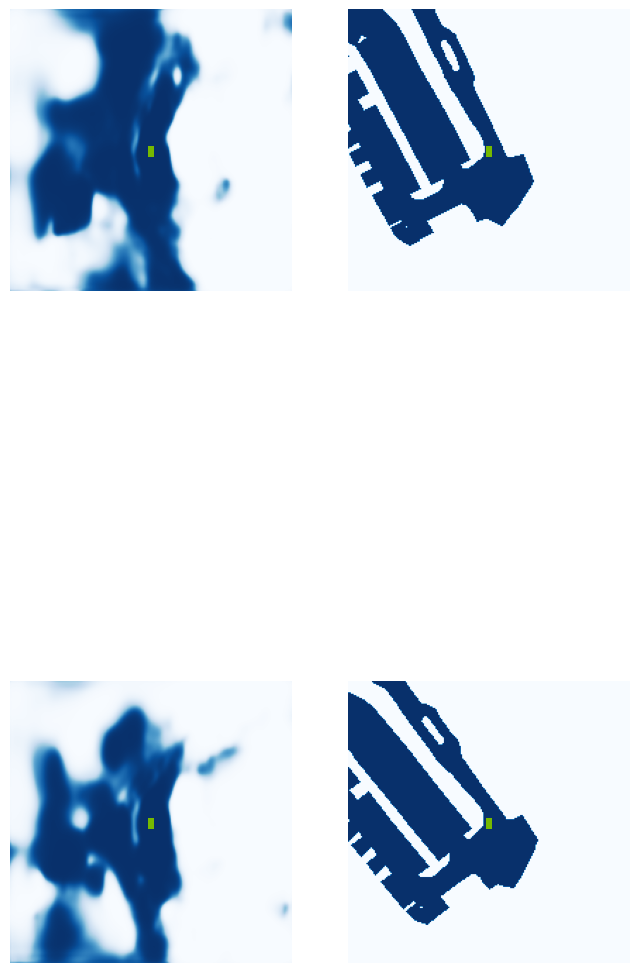

  2%|▎         | 1/40 [00:01<01:00,  1.56s/it]

Image saved! ... ./runs/get_val_info/0-iou-0.38.jpg


 12%|█▎        | 5/40 [00:01<00:09,  3.64it/s]

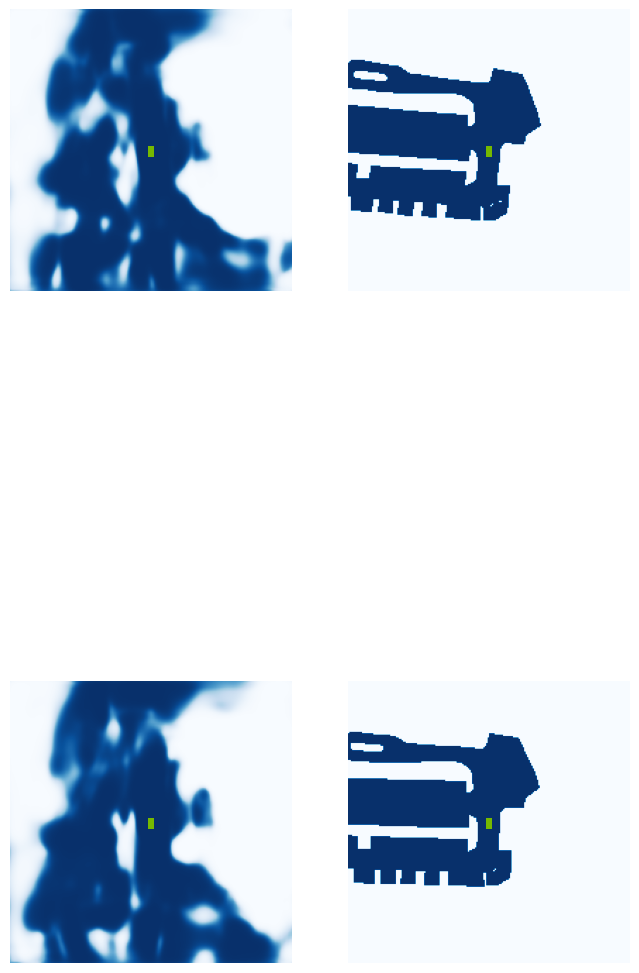

 18%|█▊        | 7/40 [00:02<00:08,  3.81it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.27.jpg


 25%|██▌       | 10/40 [00:03<00:06,  4.97it/s]

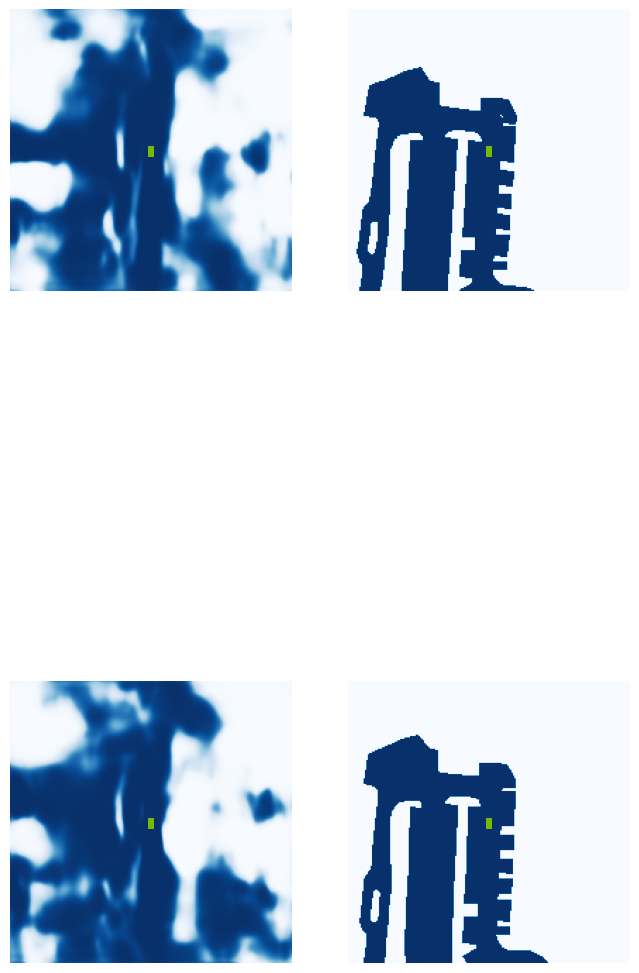

 32%|███▎      | 13/40 [00:03<00:05,  5.32it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.41.jpg


 38%|███▊      | 15/40 [00:04<00:05,  4.76it/s]

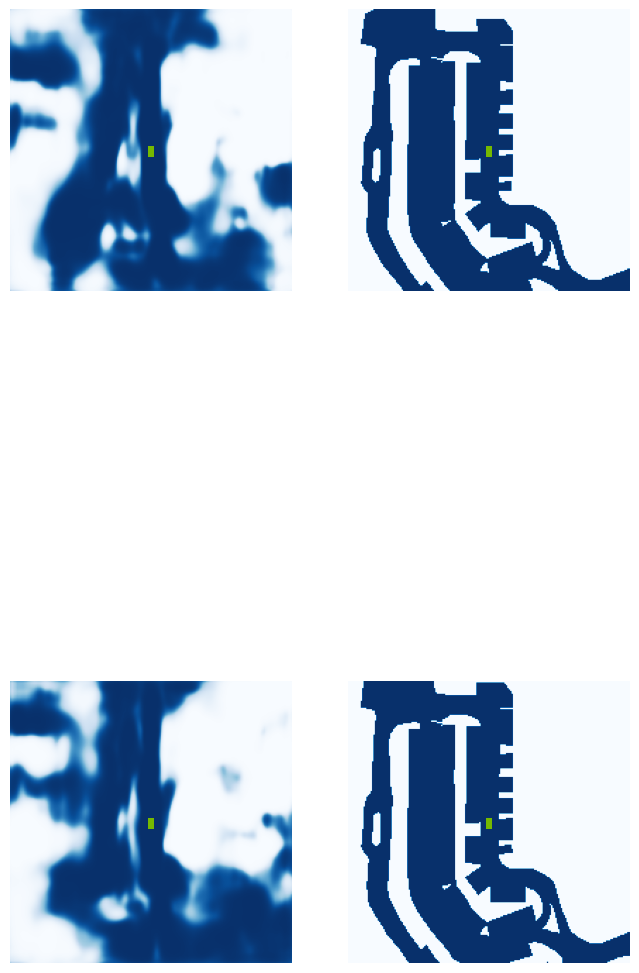

 42%|████▎     | 17/40 [00:04<00:05,  4.09it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.51.jpg


 50%|█████     | 20/40 [00:05<00:04,  4.76it/s]

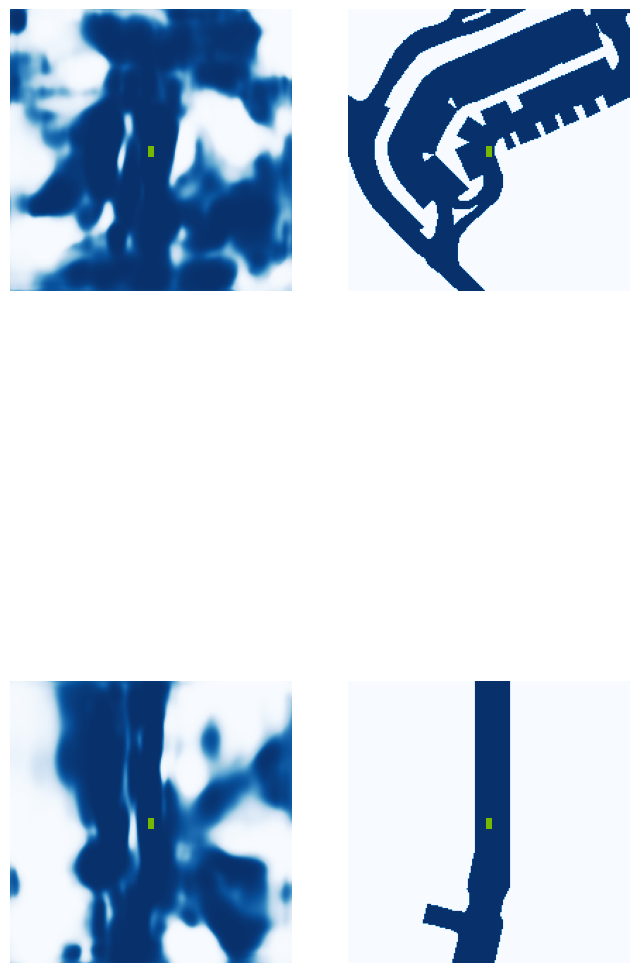

 55%|█████▌    | 22/40 [00:05<00:04,  4.22it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.32.jpg


 62%|██████▎   | 25/40 [00:06<00:02,  6.12it/s]

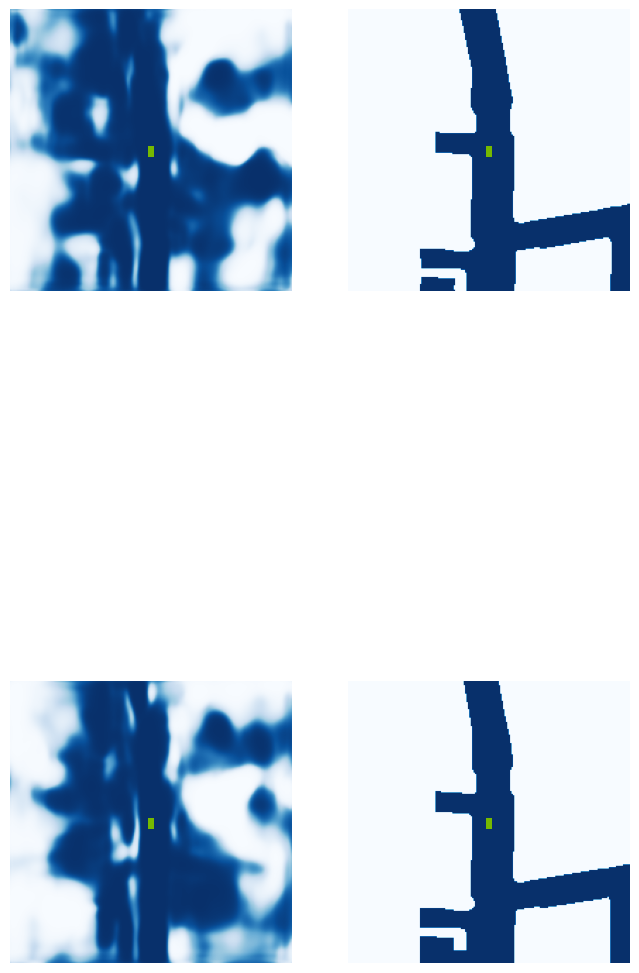

 68%|██████▊   | 27/40 [00:06<00:03,  4.21it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.32.jpg


 75%|███████▌  | 30/40 [00:07<00:01,  5.49it/s]

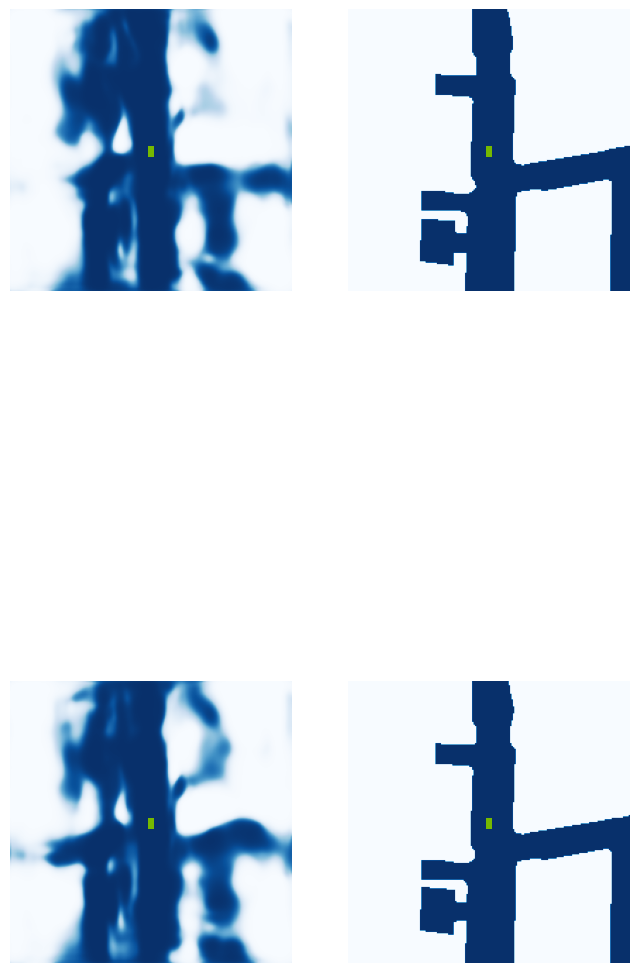

 80%|████████  | 32/40 [00:07<00:01,  4.79it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.45.jpg


 88%|████████▊ | 35/40 [00:08<00:00,  6.26it/s]

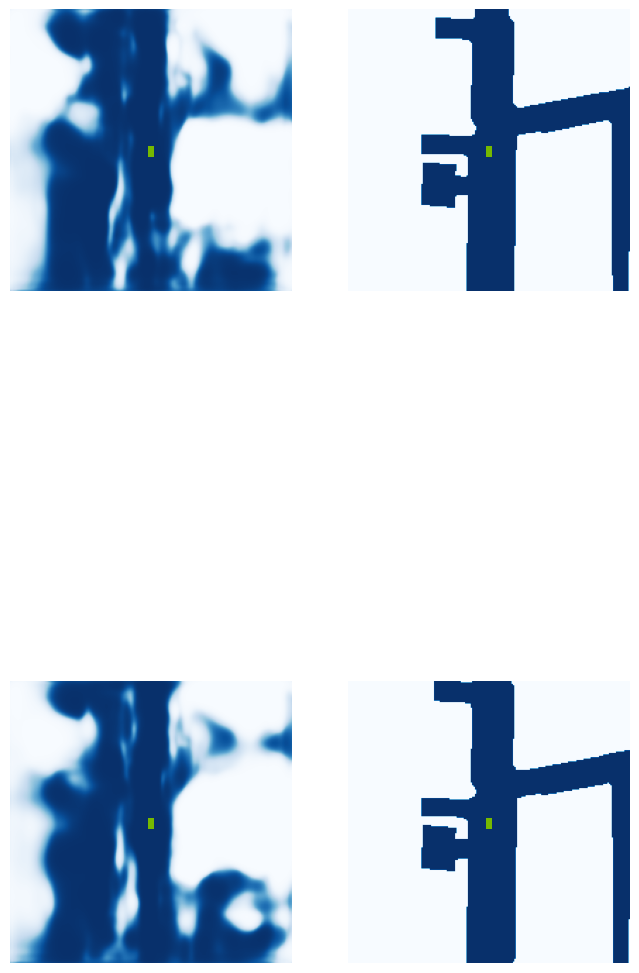

 95%|█████████▌| 38/40 [00:09<00:00,  5.05it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.33.jpg


100%|██████████| 40/40 [00:09<00:00,  4.27it/s]


VAL {'loss': 1.475601013795829, 'iou': 0.3837911472055676}
saving ...  ./runs/model6500.pt
6510 0.08509980887174606
6520 0.10271356999874115
6530 0.14782211184501648
6540 0.11490285396575928
6550 0.11775065958499908
6560 0.08931826055049896
6570 0.1078319177031517
6580 0.12183564156293869
6590 0.14144015312194824
6600 0.10039224475622177
Epoch: 42/60
6610 0.13419011235237122
6620 0.105568066239357
6630 0.11169107258319855
6640 0.20690466463565826
6650 0.18161660432815552
6660 0.1777607798576355
6670 0.09091249853372574
6680 0.16198885440826416
6690 0.12071123719215393
6700 0.12058744579553604
6710 0.17290888726711273
6720 0.07974656671285629
6730 0.09256419539451599
6740 0.10909457504749298
6750 0.0931122750043869
6760 0.10999805480241776
Epoch: 43/60
6770 0.13464325666427612
6780 0.08362186700105667
6790 0.16282106935977936
6800 0.12380397319793701
6810 0.13232092559337616
6820 0.19519659876823425
6830 0.08743327111005783
6840 0.09101124852895737
6850 0.13584227859973907
6860 0.220513

  0%|          | 0/40 [00:00<?, ?it/s]

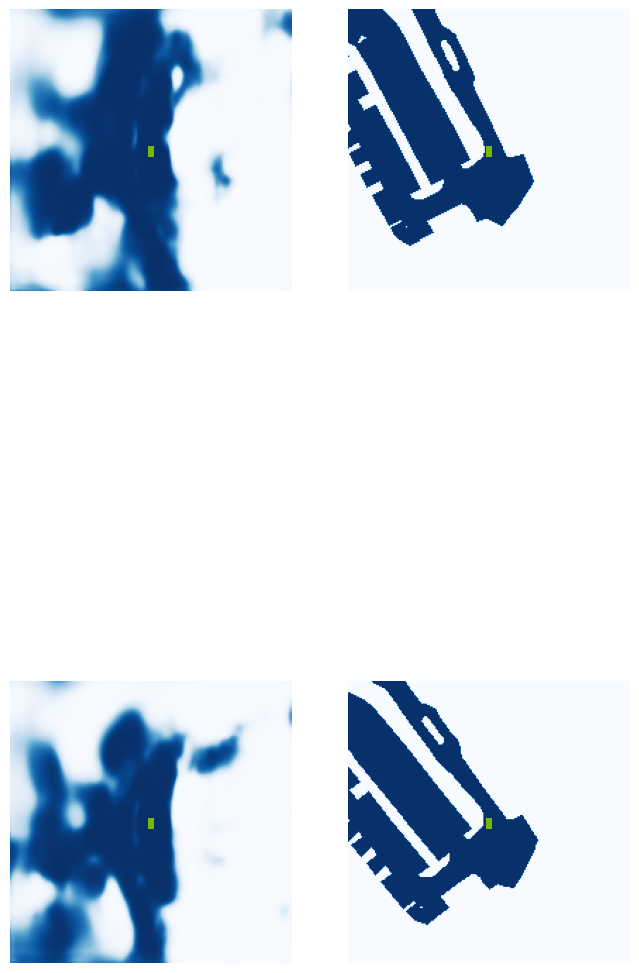

  5%|▌         | 2/40 [00:01<00:20,  1.82it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.37.jpg


 12%|█▎        | 5/40 [00:01<00:07,  4.55it/s]

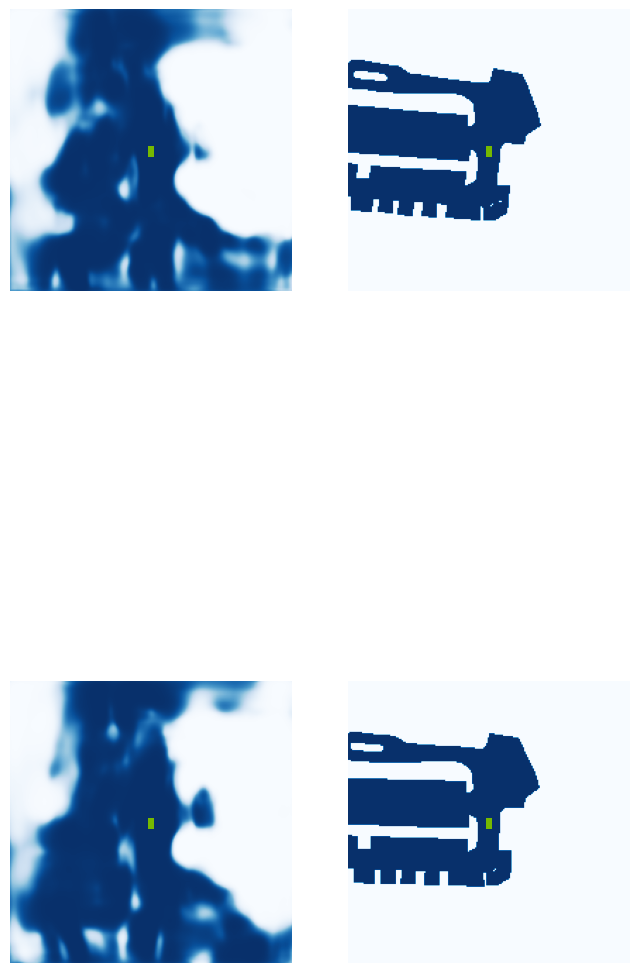

 18%|█▊        | 7/40 [00:02<00:07,  4.35it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.27.jpg


 25%|██▌       | 10/40 [00:02<00:05,  5.50it/s]

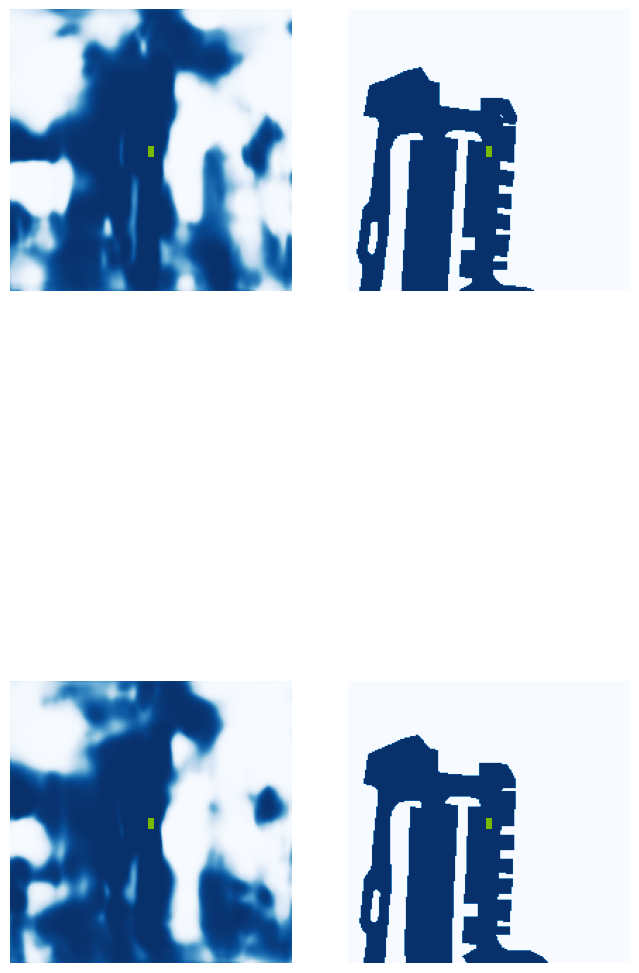

 30%|███       | 12/40 [00:03<00:07,  3.82it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.39.jpg


 38%|███▊      | 15/40 [00:03<00:04,  5.03it/s]

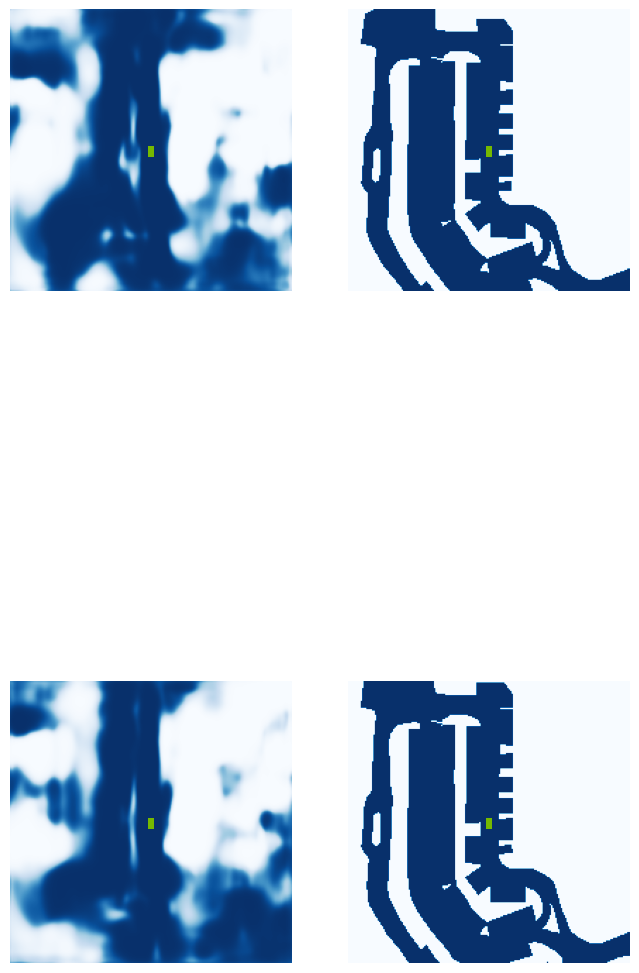

 42%|████▎     | 17/40 [00:04<00:06,  3.43it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.50.jpg


 48%|████▊     | 19/40 [00:05<00:04,  4.95it/s]

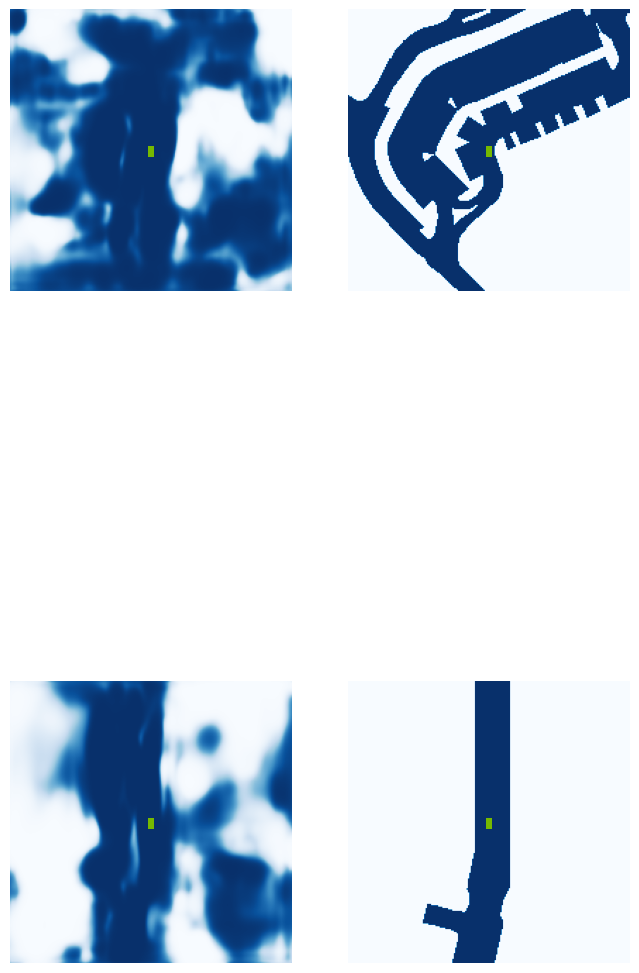

 55%|█████▌    | 22/40 [00:05<00:03,  4.92it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.34.jpg


 62%|██████▎   | 25/40 [00:06<00:02,  6.70it/s]

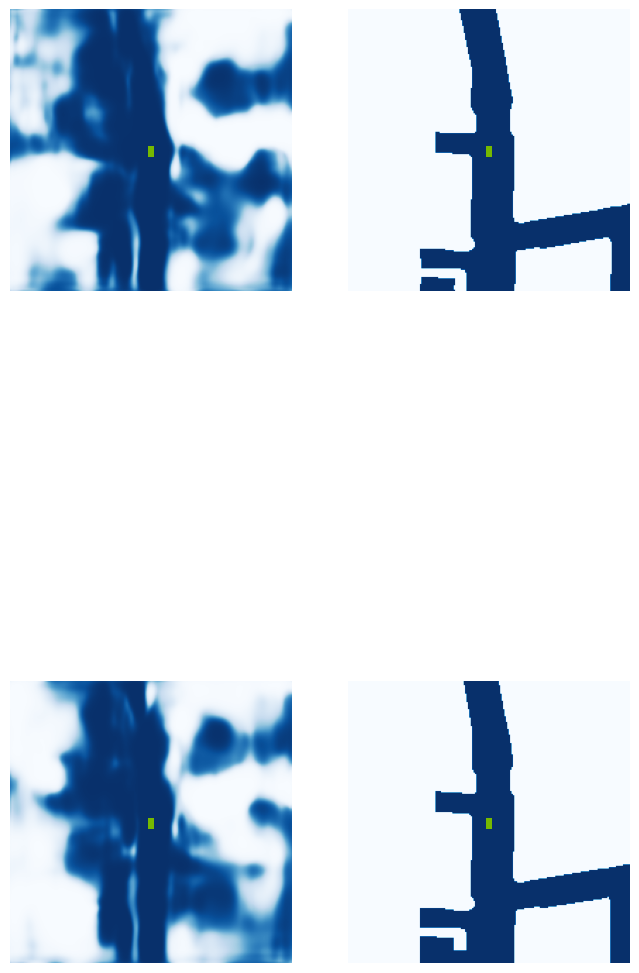

 68%|██████▊   | 27/40 [00:06<00:02,  5.04it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.33.jpg


 75%|███████▌  | 30/40 [00:07<00:01,  6.19it/s]

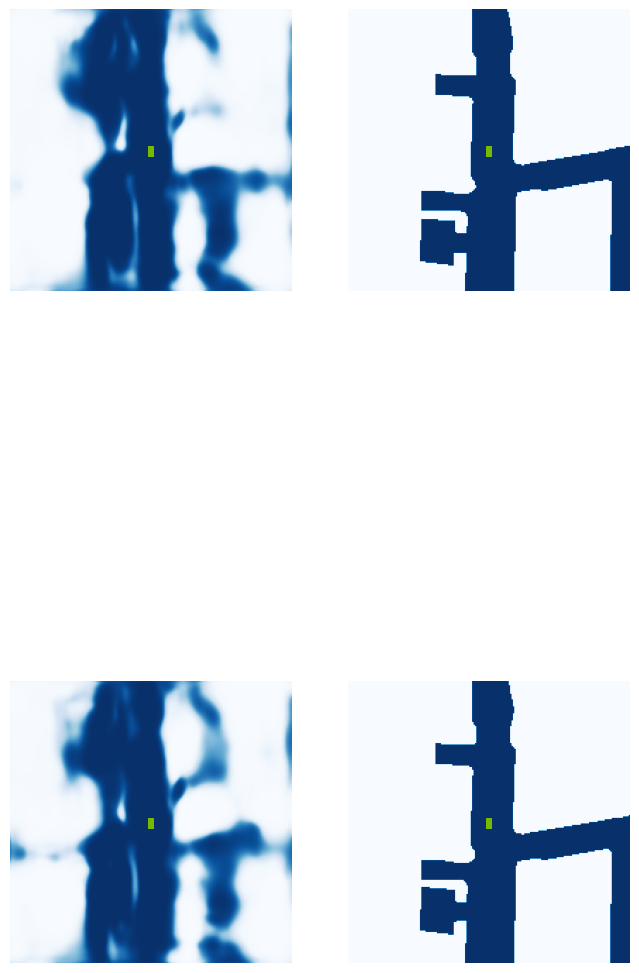

 80%|████████  | 32/40 [00:07<00:01,  4.65it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.44.jpg


 88%|████████▊ | 35/40 [00:08<00:00,  6.22it/s]

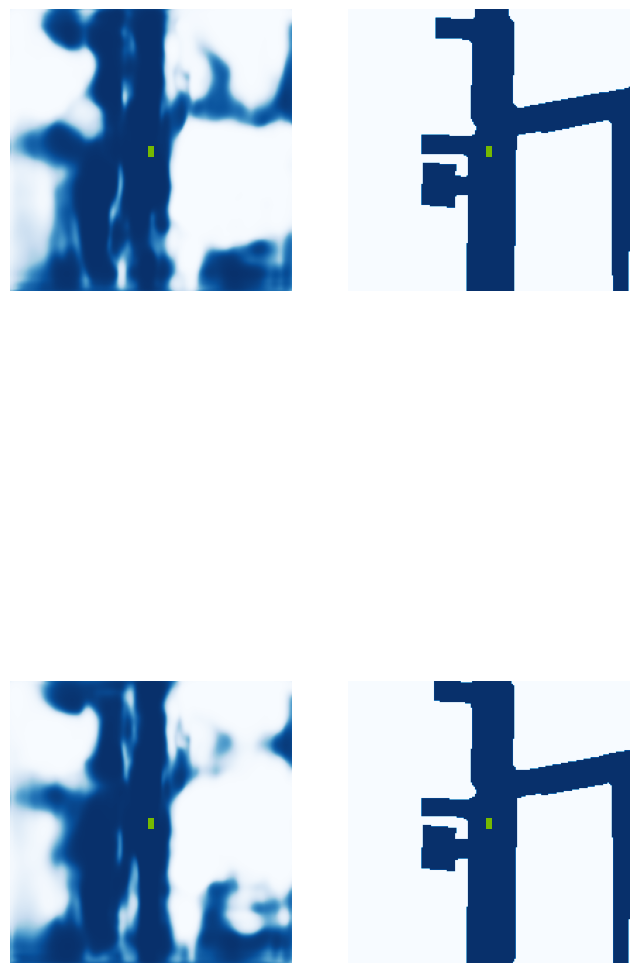

 92%|█████████▎| 37/40 [00:08<00:00,  4.88it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.36.jpg


100%|██████████| 40/40 [00:09<00:00,  4.42it/s]


VAL {'loss': 1.4557443577566265, 'iou': 0.3821789567318772}
saving ...  ./runs/model7000.pt
7010 0.17005321383476257
7020 0.16257785260677338
7030 0.08484142273664474
7040 0.07627784460783005
7050 0.23989780247211456
7060 0.20245754718780518
7070 0.06072547286748886
7080 0.11527657508850098
Epoch: 45/60
7090 0.06492696702480316
7100 0.12538889050483704
7110 0.10363823175430298
7120 0.16734546422958374
7130 0.13261139392852783
7140 0.06796123832464218
7150 0.11091774702072144
7160 0.0895228162407875
7170 0.12382838875055313
7180 0.15481245517730713
7190 0.18455947935581207
7200 0.1232706606388092
7210 0.10507643967866898
7220 0.17638659477233887
7230 0.07638081163167953
7240 0.0977846011519432
Epoch: 46/60
7250 0.05591714382171631
7260 0.1216237023472786
7270 0.1337646096944809
7280 0.09615550190210342
7290 0.11700860410928726
7300 0.08942168951034546
7310 0.07461611181497574
7320 0.18801474571228027
7330 0.07881512492895126
7340 0.08138485997915268
7350 0.12588994204998016
7360 0.14624

  0%|          | 0/40 [00:00<?, ?it/s]

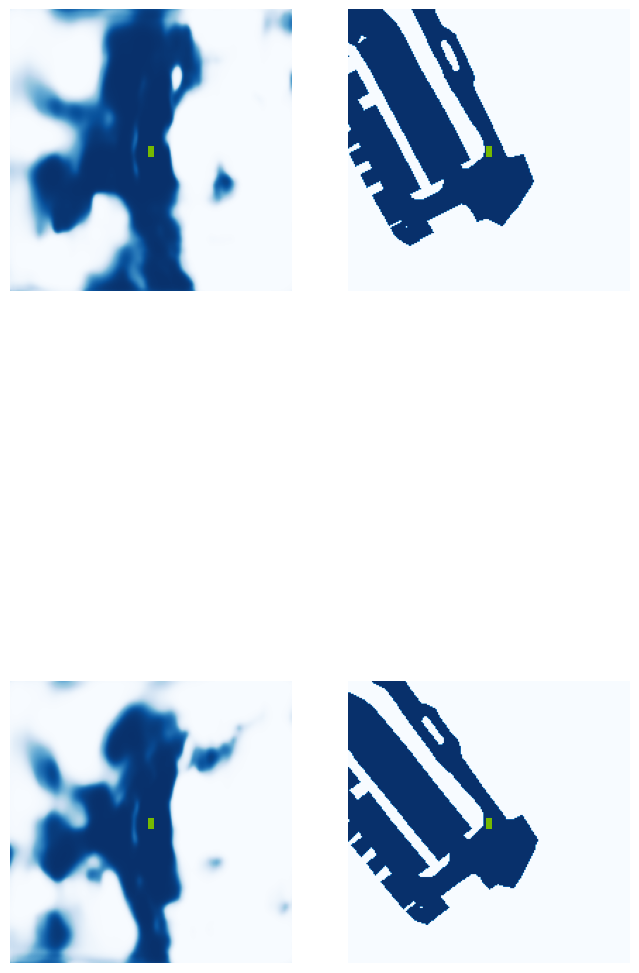

  5%|▌         | 2/40 [00:01<00:20,  1.88it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.32.jpg


 12%|█▎        | 5/40 [00:01<00:08,  4.25it/s]

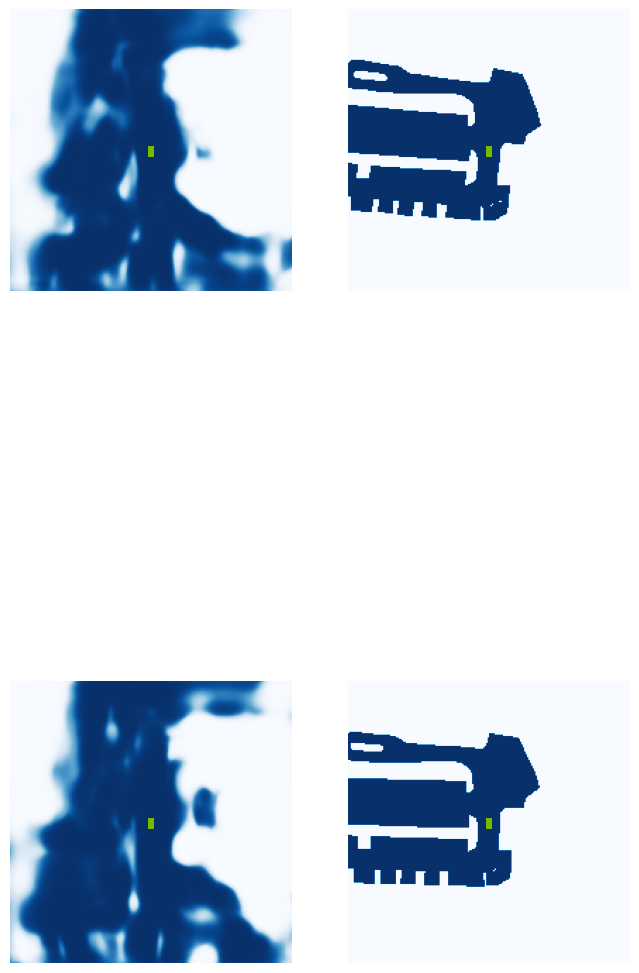

 18%|█▊        | 7/40 [00:02<00:07,  4.18it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.27.jpg


 25%|██▌       | 10/40 [00:02<00:05,  5.21it/s]

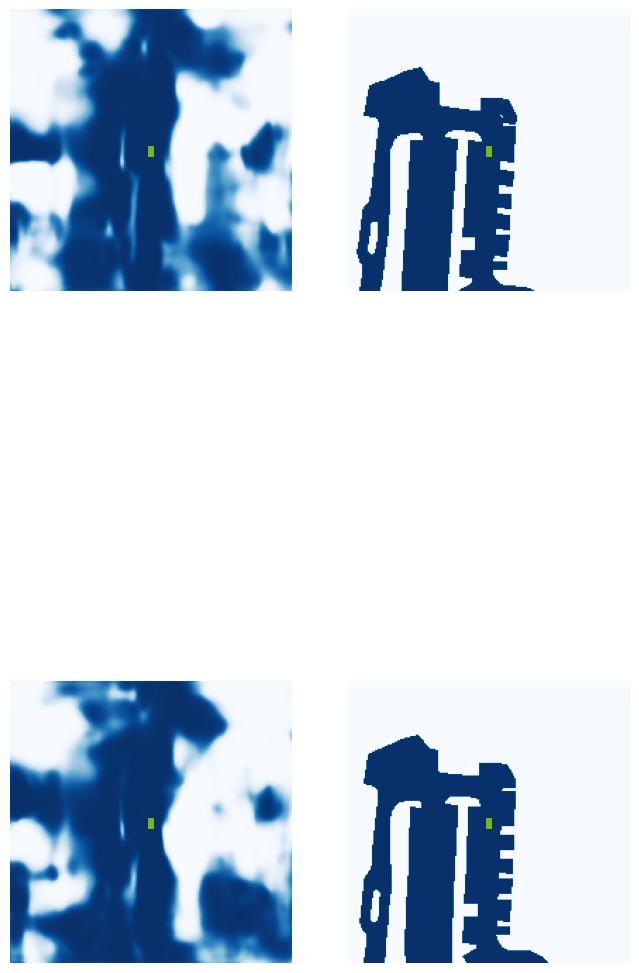

 30%|███       | 12/40 [00:03<00:07,  3.70it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.37.jpg


 38%|███▊      | 15/40 [00:04<00:05,  4.60it/s]

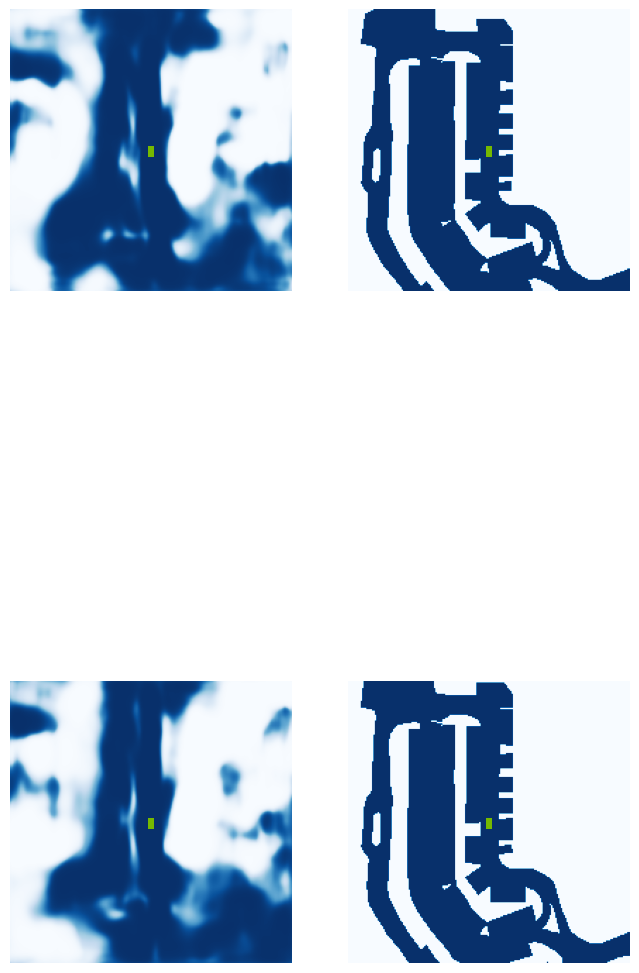

 42%|████▎     | 17/40 [00:04<00:05,  4.45it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.46.jpg


 48%|████▊     | 19/40 [00:04<00:04,  4.30it/s]

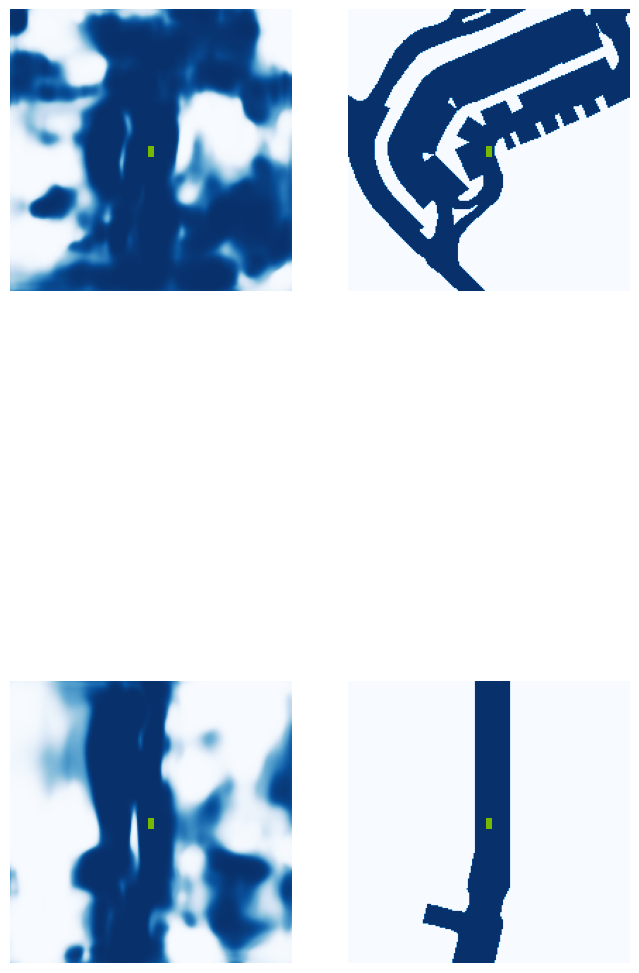

 52%|█████▎    | 21/40 [00:05<00:05,  3.41it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.34.jpg


 62%|██████▎   | 25/40 [00:06<00:02,  5.65it/s]

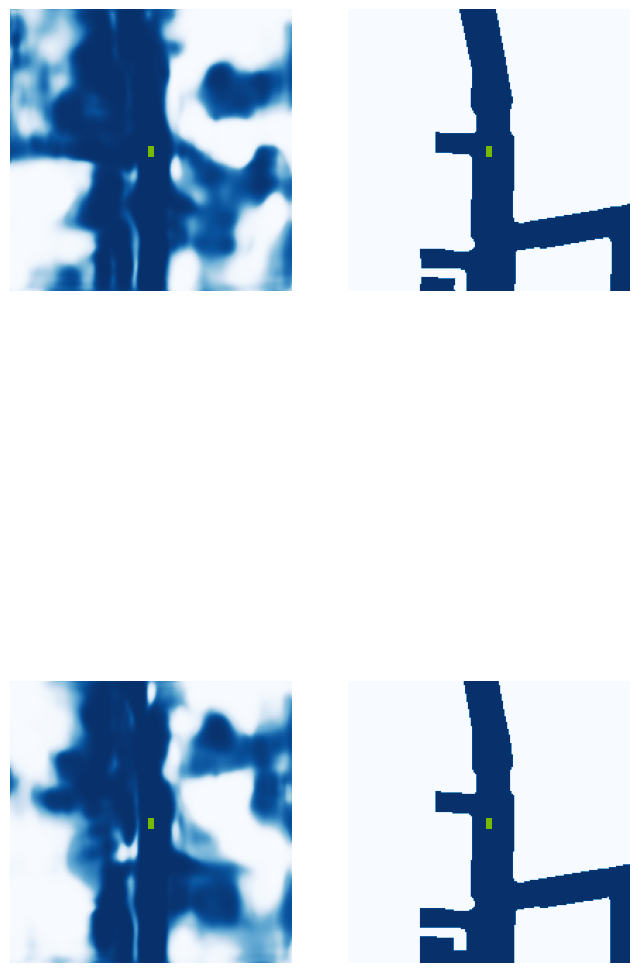

 68%|██████▊   | 27/40 [00:06<00:02,  4.83it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.33.jpg


 75%|███████▌  | 30/40 [00:07<00:01,  6.81it/s]

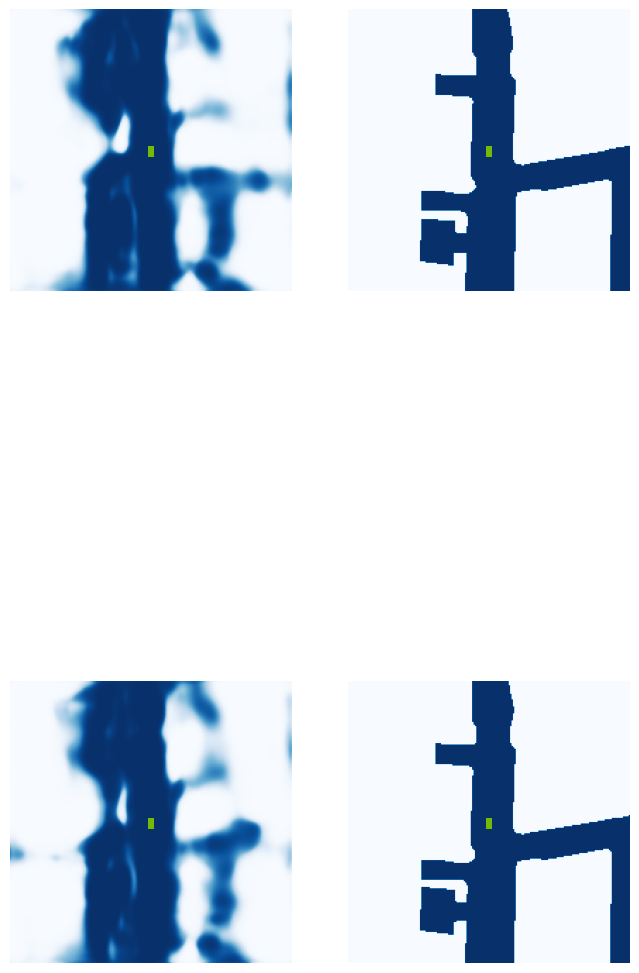

 78%|███████▊  | 31/40 [00:08<00:03,  2.55it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.46.jpg


 85%|████████▌ | 34/40 [00:08<00:01,  4.53it/s]

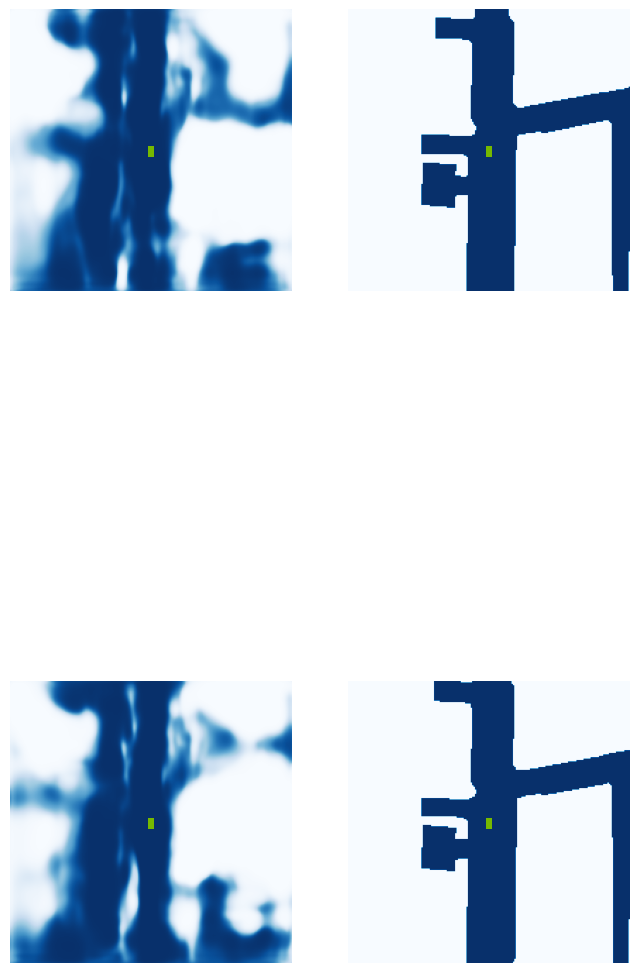

 92%|█████████▎| 37/40 [00:09<00:00,  4.52it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.36.jpg


100%|██████████| 40/40 [00:09<00:00,  4.26it/s]


VAL {'loss': 1.5328415853005868, 'iou': 0.38177384215794674}
saving ...  ./runs/model7500.pt
7510 0.1100057065486908
7520 0.06615595519542694
7530 0.06906569749116898
7540 0.14193986356258392
7550 0.1475498080253601
7560 0.1082741916179657
Epoch: 48/60
7570 0.058759190142154694
7580 0.16198691725730896
7590 0.09989118576049805
7600 0.057485245168209076
7610 0.06059445068240166
7620 0.09122010320425034
7630 0.08330867439508438
7640 0.07791663706302643
7650 0.1886429339647293
7660 0.08059000223875046
7670 0.1731216311454773
7680 0.22175951302051544
7690 0.05173909291625023
7700 0.15288828313350677
7710 0.11518669128417969
7720 0.14370809495449066
Epoch: 49/60
7730 0.1211724802851677
7740 0.21574223041534424
7750 0.157289519906044
7760 0.1844659447669983
7770 0.08484520018100739
7780 0.1305299550294876
7790 0.08357350528240204
7800 0.07251713424921036
7810 0.08613516390323639
7820 0.06455273181200027
7830 0.13890331983566284
7840 0.0555143840610981
7850 0.1907961368560791
7860 0.170164942

  0%|          | 0/40 [00:00<?, ?it/s]

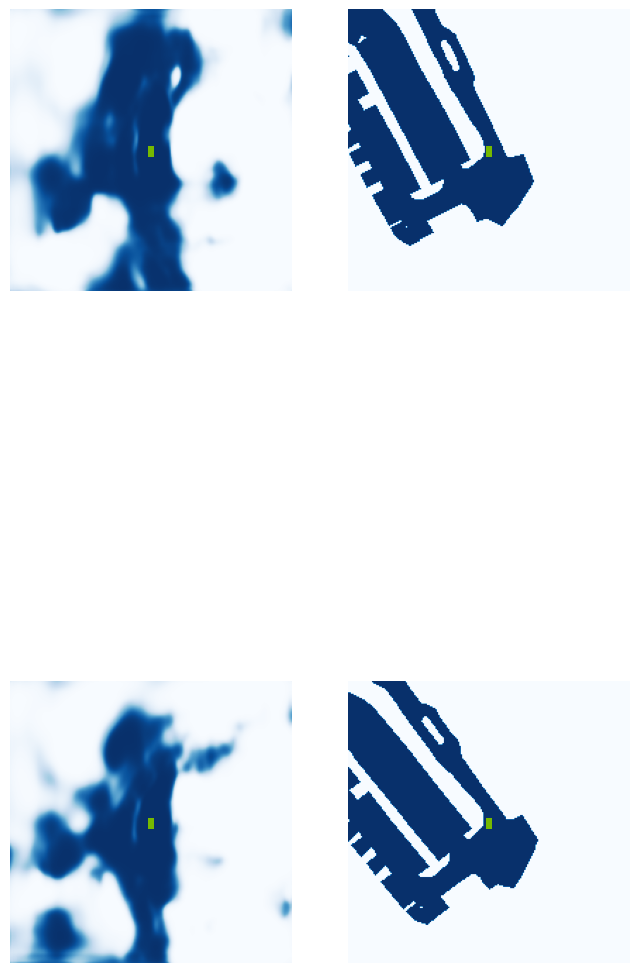

  5%|▌         | 2/40 [00:01<00:20,  1.90it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.30.jpg


 12%|█▎        | 5/40 [00:01<00:08,  4.21it/s]

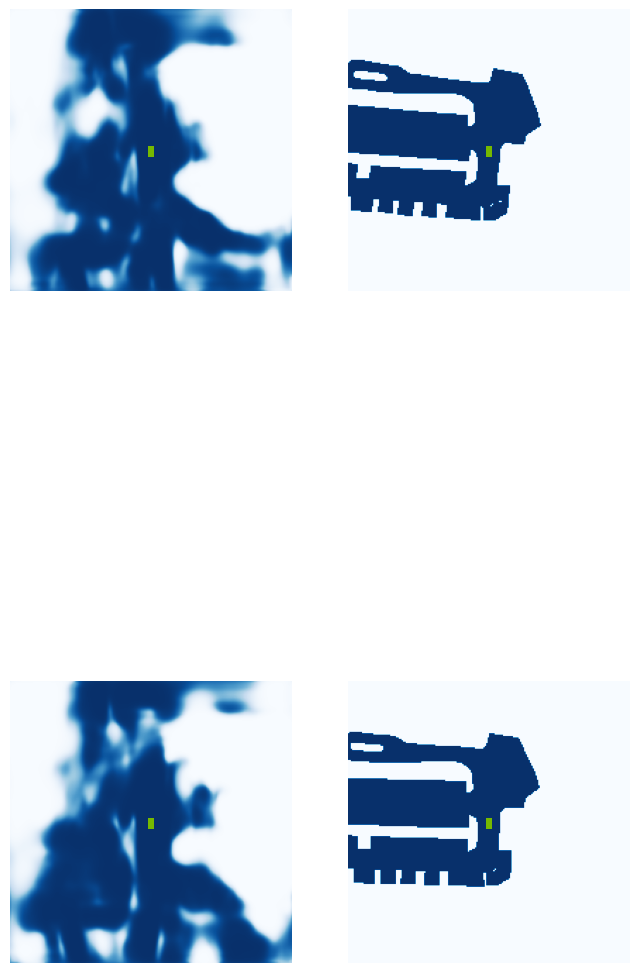

 18%|█▊        | 7/40 [00:02<00:07,  4.31it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.26.jpg


 22%|██▎       | 9/40 [00:02<00:07,  4.32it/s]

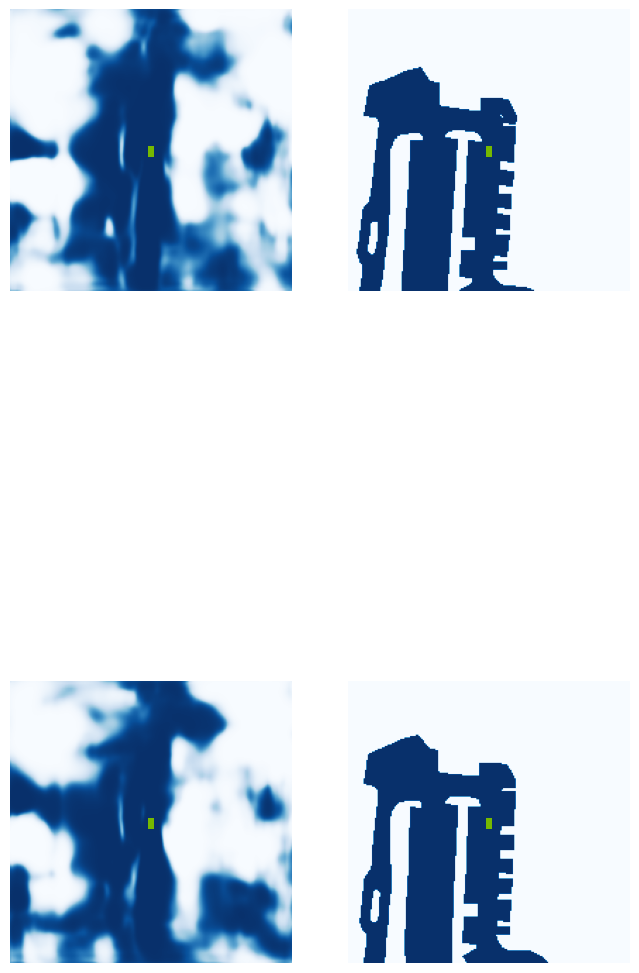

 30%|███       | 12/40 [00:03<00:06,  4.04it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.37.jpg


 38%|███▊      | 15/40 [00:03<00:05,  4.84it/s]

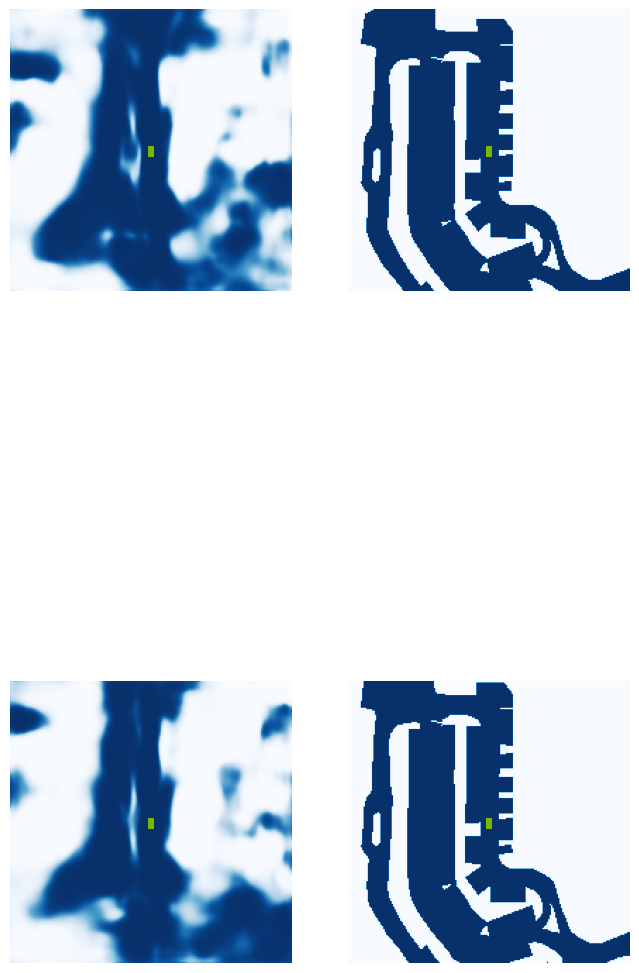

 42%|████▎     | 17/40 [00:04<00:05,  4.21it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.44.jpg


 48%|████▊     | 19/40 [00:04<00:04,  5.01it/s]

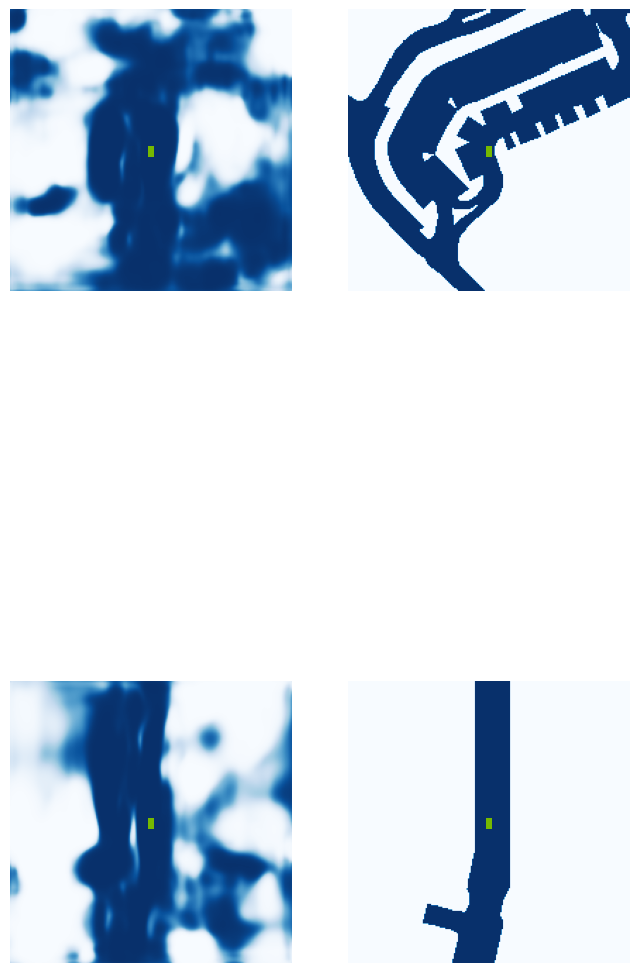

 52%|█████▎    | 21/40 [00:05<00:04,  3.85it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.31.jpg


 62%|██████▎   | 25/40 [00:06<00:02,  5.72it/s]

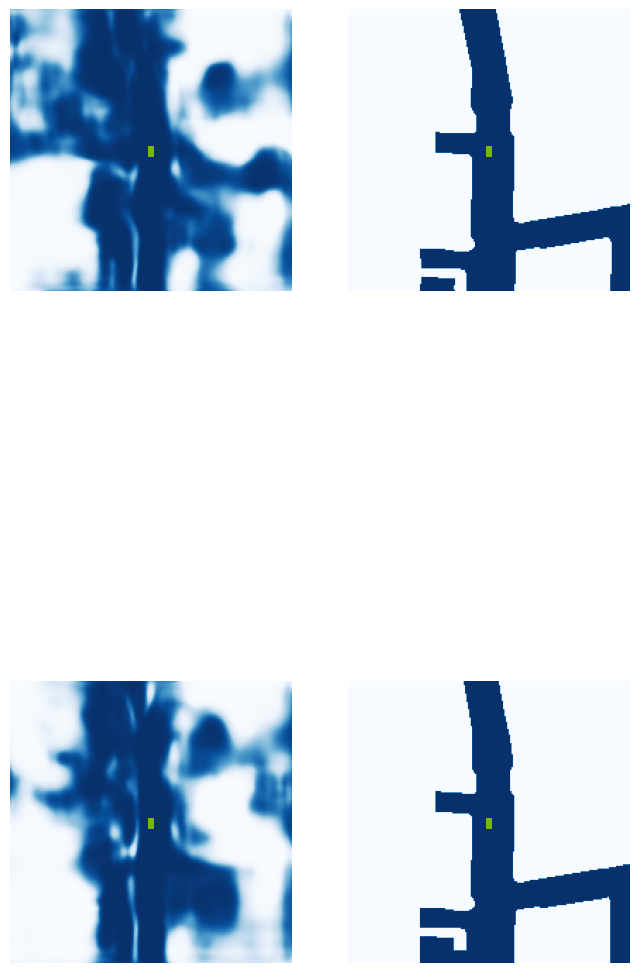

 68%|██████▊   | 27/40 [00:06<00:02,  5.15it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.34.jpg


 75%|███████▌  | 30/40 [00:06<00:01,  6.43it/s]

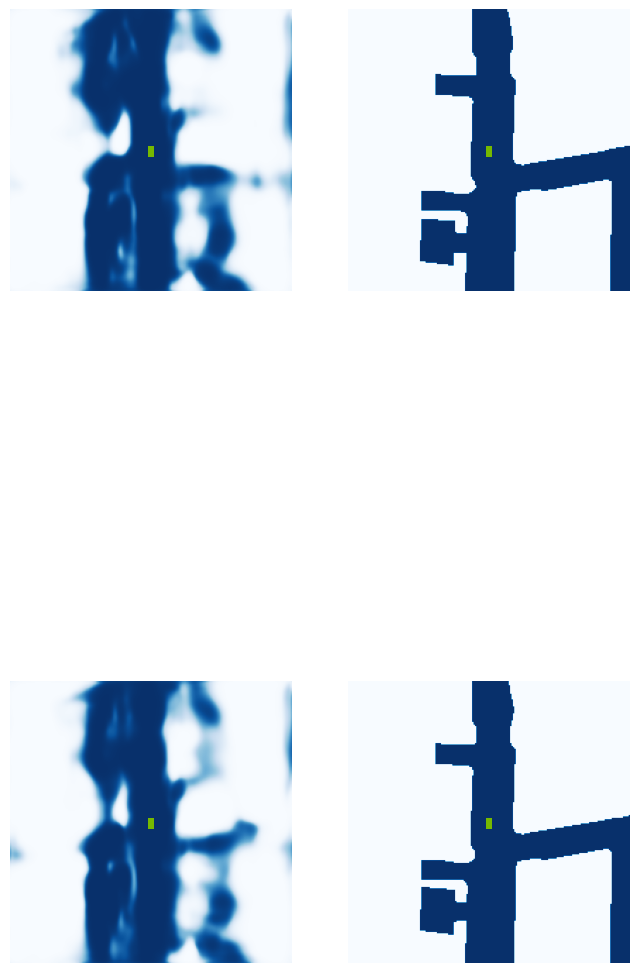

 80%|████████  | 32/40 [00:07<00:01,  4.46it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.46.jpg


 88%|████████▊ | 35/40 [00:07<00:00,  5.77it/s]

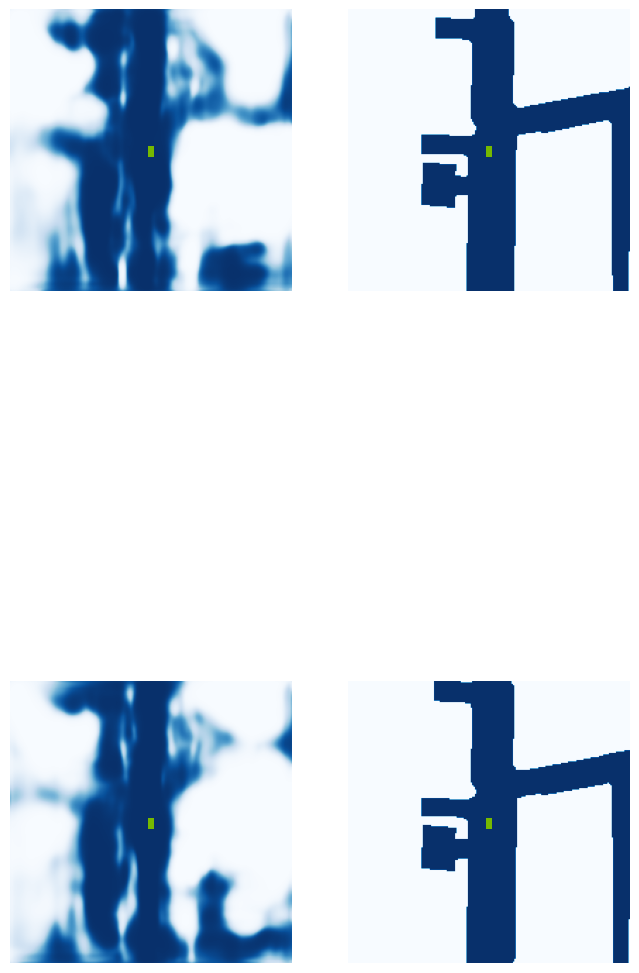

 92%|█████████▎| 37/40 [00:08<00:00,  4.64it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.41.jpg


100%|██████████| 40/40 [00:08<00:00,  4.47it/s]


VAL {'loss': 1.4948451033344976, 'iou': 0.38000591923937777}
saving ...  ./runs/model8000.pt
8010 0.17133590579032898
8020 0.05608859658241272
8030 0.142012819647789
8040 0.11261746287345886
8050 0.06507651507854462
Epoch: 51/60
8060 0.13146696984767914
8070 0.08970960229635239
8080 0.14100982248783112
8090 0.056408971548080444
8100 0.08741435408592224
8110 0.09454941004514694
8120 0.09006725251674652
8130 0.07312784343957901
8140 0.12850160896778107
8150 0.14145292341709137
8160 0.10858836024999619
8170 0.08449061214923859
8180 0.07806874811649323
8190 0.20117387175559998
8200 0.1319248229265213
8210 0.0715932846069336
Epoch: 52/60
8220 0.08307188749313354
8230 0.11698587238788605
8240 0.12253997474908829
8250 0.1119401678442955
8260 0.061802804470062256
8270 0.17489559948444366
8280 0.07418857514858246
8290 0.10592697560787201
8300 0.09292680770158768
8310 0.08395545184612274
8320 0.05879490077495575
8330 0.06593615561723709
8340 0.09427886456251144
8350 0.12949523329734802
8360 0.06

  0%|          | 0/40 [00:00<?, ?it/s]

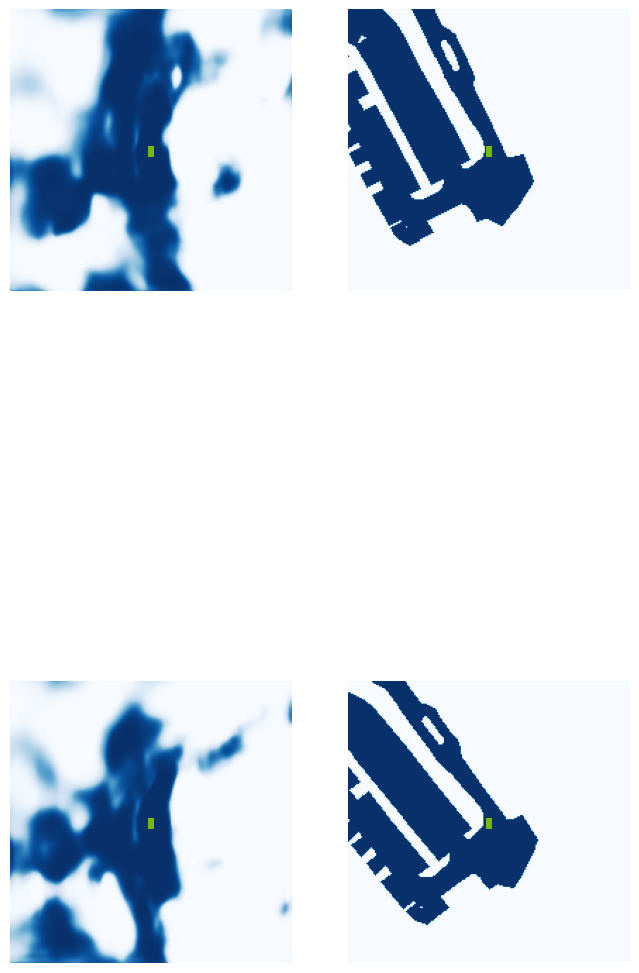

  5%|▌         | 2/40 [00:01<00:20,  1.88it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.31.jpg


 12%|█▎        | 5/40 [00:01<00:07,  4.68it/s]

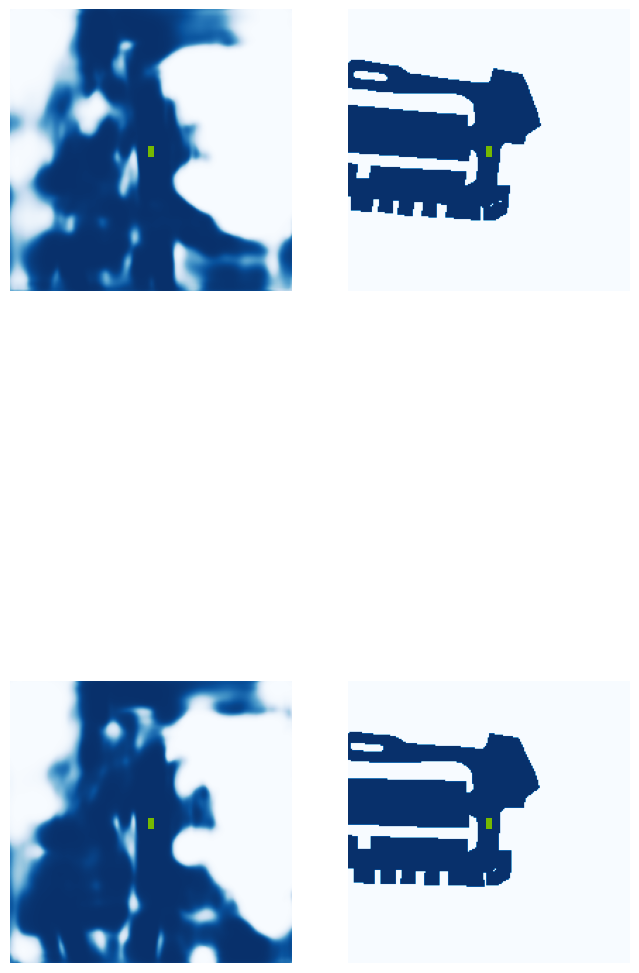

 18%|█▊        | 7/40 [00:02<00:07,  4.54it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.28.jpg


 25%|██▌       | 10/40 [00:02<00:05,  5.46it/s]

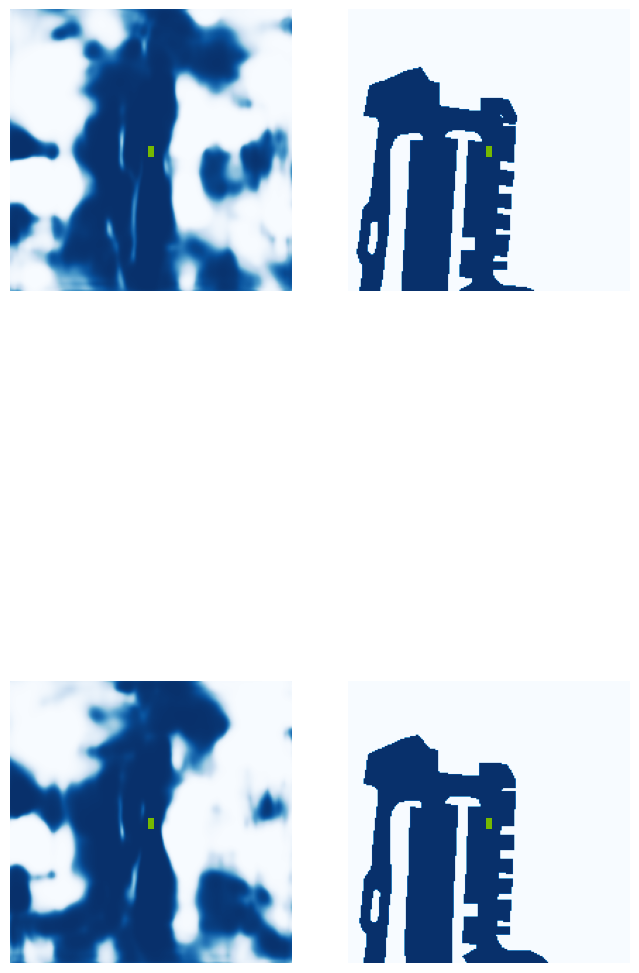

 30%|███       | 12/40 [00:03<00:07,  3.90it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.37.jpg


 38%|███▊      | 15/40 [00:03<00:05,  4.60it/s]

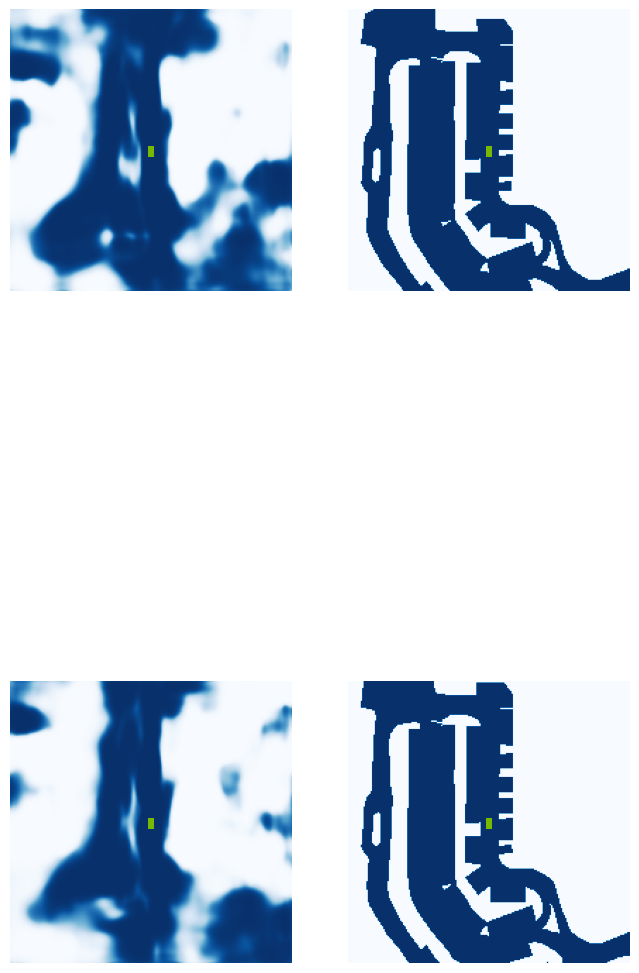

 42%|████▎     | 17/40 [00:04<00:05,  3.91it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.45.jpg


 50%|█████     | 20/40 [00:04<00:03,  5.81it/s]

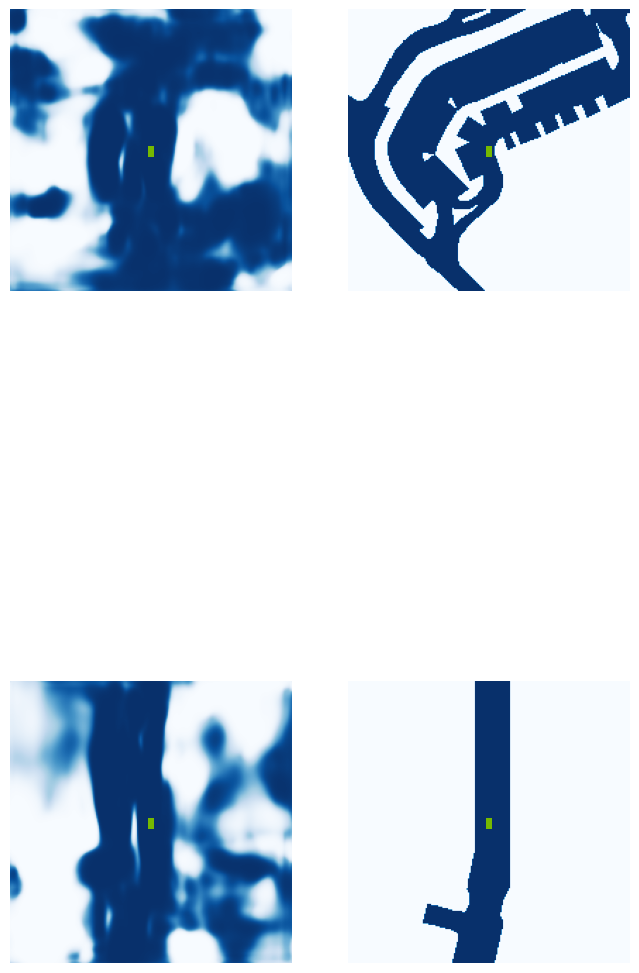

 55%|█████▌    | 22/40 [00:05<00:04,  3.72it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.31.jpg


 62%|██████▎   | 25/40 [00:06<00:02,  5.92it/s]

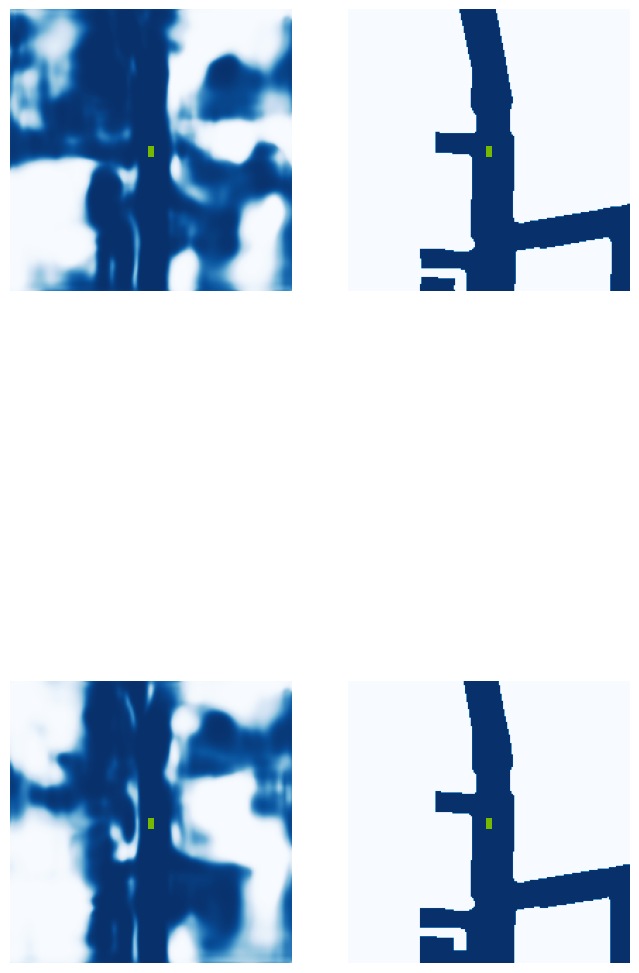

 68%|██████▊   | 27/40 [00:06<00:02,  4.70it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.33.jpg


 75%|███████▌  | 30/40 [00:07<00:01,  5.49it/s]

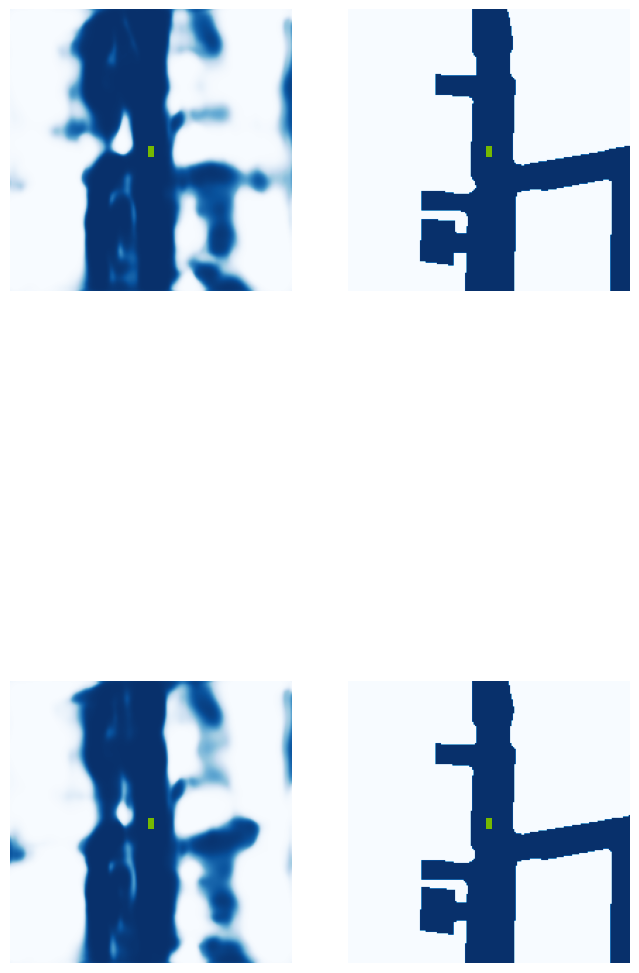

 80%|████████  | 32/40 [00:07<00:01,  4.83it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.45.jpg


 88%|████████▊ | 35/40 [00:08<00:00,  5.55it/s]

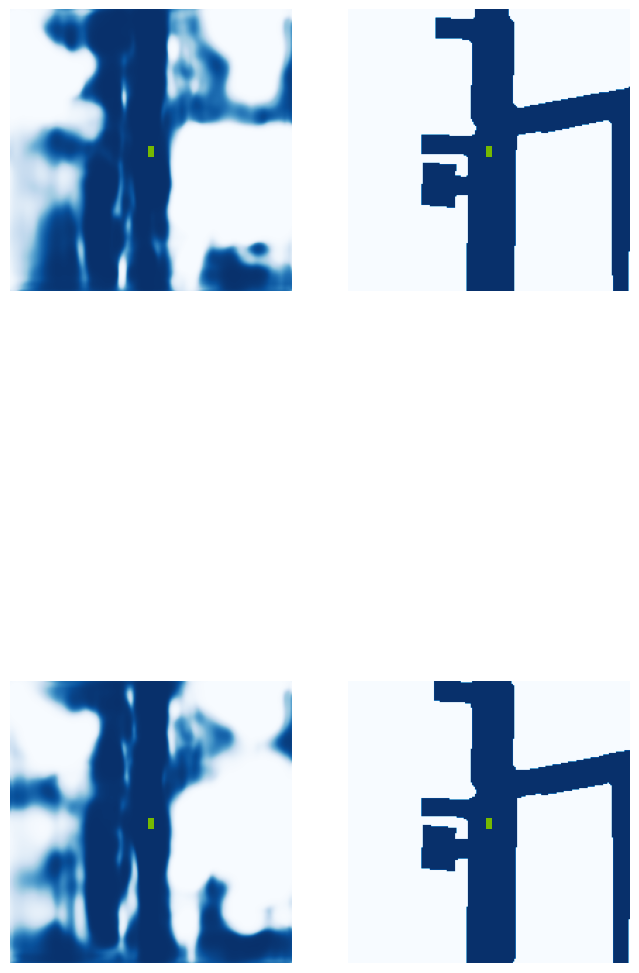

 92%|█████████▎| 37/40 [00:08<00:00,  4.25it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.36.jpg


100%|██████████| 40/40 [00:09<00:00,  4.36it/s]


VAL {'loss': 1.6187823878394232, 'iou': 0.37395612668289013}
saving ...  ./runs/model8500.pt
8510 0.06287717819213867
8520 0.1006125956773758
8530 0.08537424355745316
Epoch: 54/60
8540 0.12164460122585297
8550 0.07778868079185486
8560 0.09702453017234802
8570 0.10799955576658249
8580 0.10098712891340256
8590 0.13983142375946045
8600 0.06501827389001846
8610 0.09095883369445801
8620 0.1261882483959198
8630 0.09910601377487183
8640 0.24179717898368835
8650 0.1776190996170044
8660 0.05296599119901657
8670 0.08738605678081512
8680 0.14424435794353485
8690 0.13392283022403717
Epoch: 55/60
8700 0.05414313077926636
8710 0.20075556635856628
8720 0.13997840881347656
8730 0.05968181788921356
8740 0.216831237077713
8750 0.06793579459190369
8760 0.05893312767148018
8770 0.08527928590774536
8780 0.10290307551622391
8790 0.07491279393434525
8800 0.154411181807518
8810 0.15179023146629333
8820 0.09019295126199722
8830 0.1078544408082962
8840 0.10035287588834763
8850 0.12865743041038513
Epoch: 56/60
8

  0%|          | 0/40 [00:00<?, ?it/s]

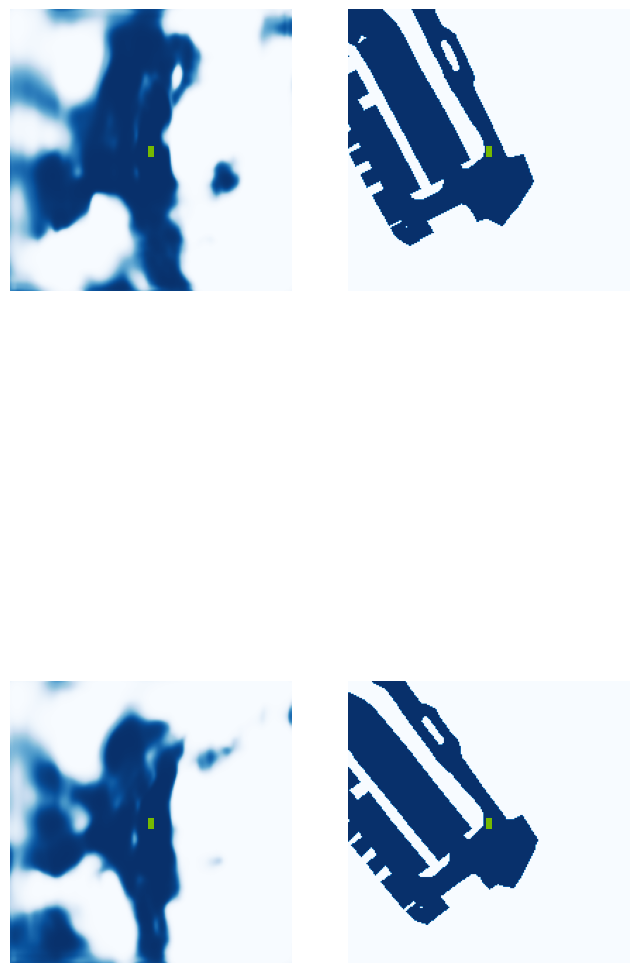

  2%|▎         | 1/40 [00:01<00:46,  1.18s/it]

Image saved! ... ./runs/get_val_info/0-iou-0.34.jpg


 12%|█▎        | 5/40 [00:01<00:08,  4.02it/s]

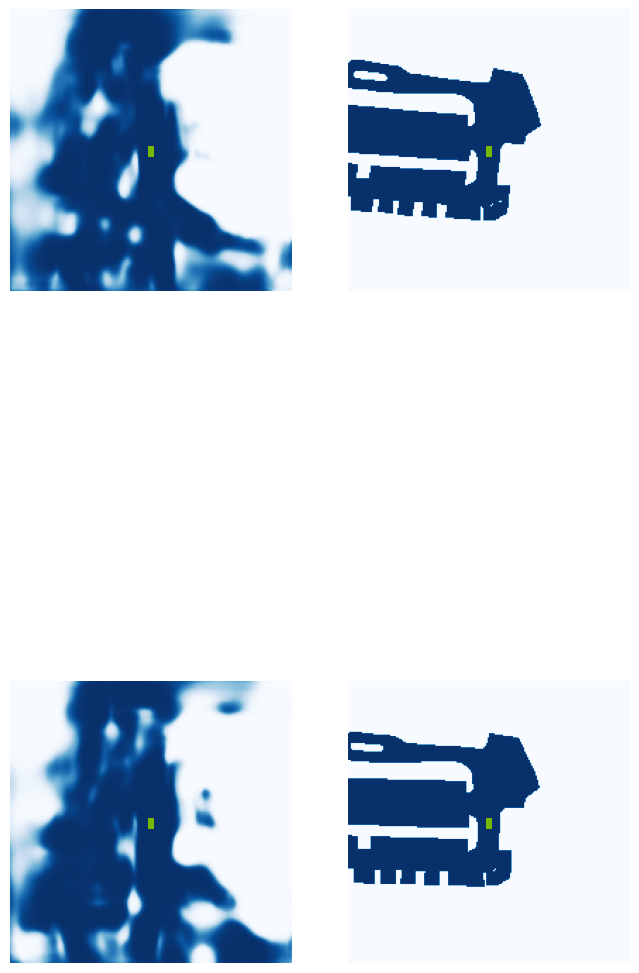

 18%|█▊        | 7/40 [00:02<00:08,  4.08it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.29.jpg


 25%|██▌       | 10/40 [00:02<00:05,  5.67it/s]

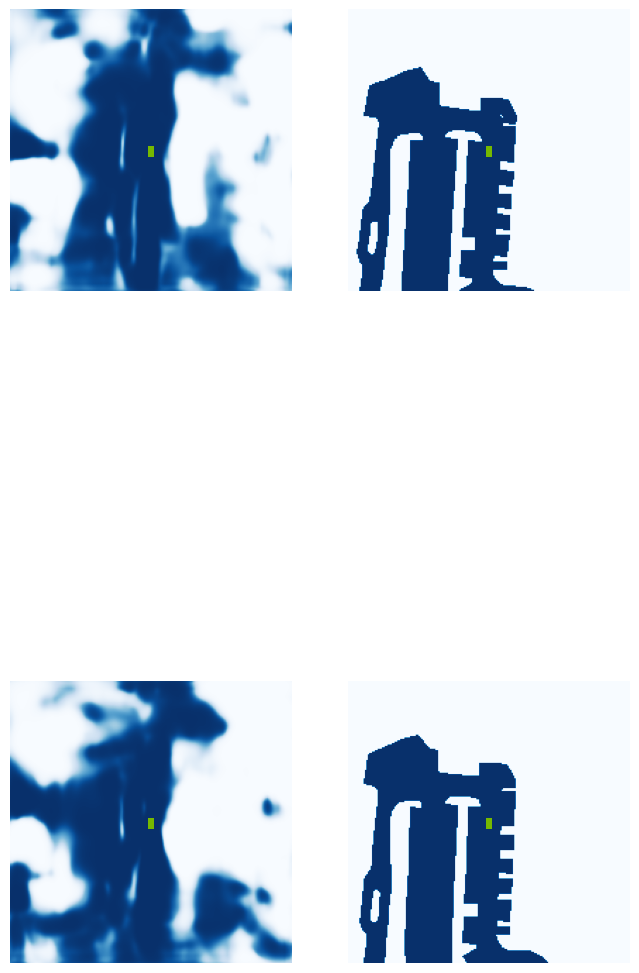

 30%|███       | 12/40 [00:03<00:07,  4.00it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.40.jpg


 38%|███▊      | 15/40 [00:03<00:05,  4.74it/s]

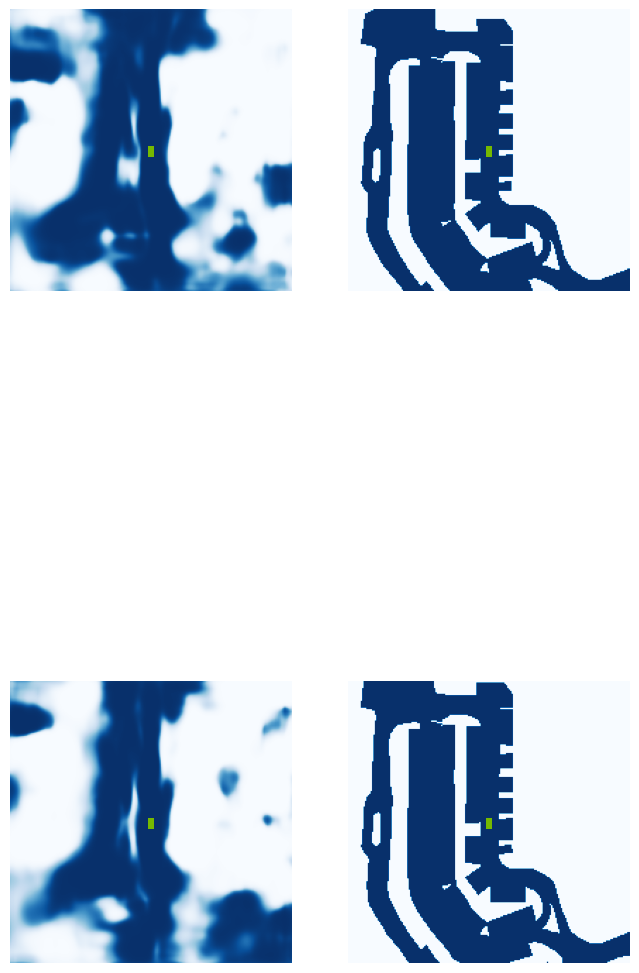

 42%|████▎     | 17/40 [00:04<00:05,  4.57it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.47.jpg


 50%|█████     | 20/40 [00:04<00:03,  5.16it/s]

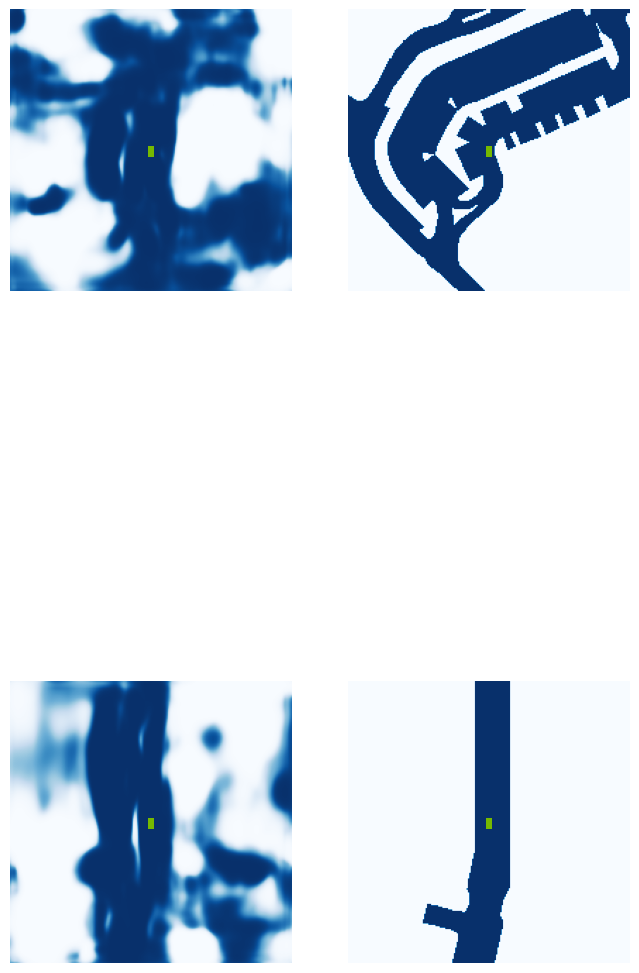

 55%|█████▌    | 22/40 [00:05<00:05,  3.53it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.32.jpg


 62%|██████▎   | 25/40 [00:06<00:02,  5.90it/s]

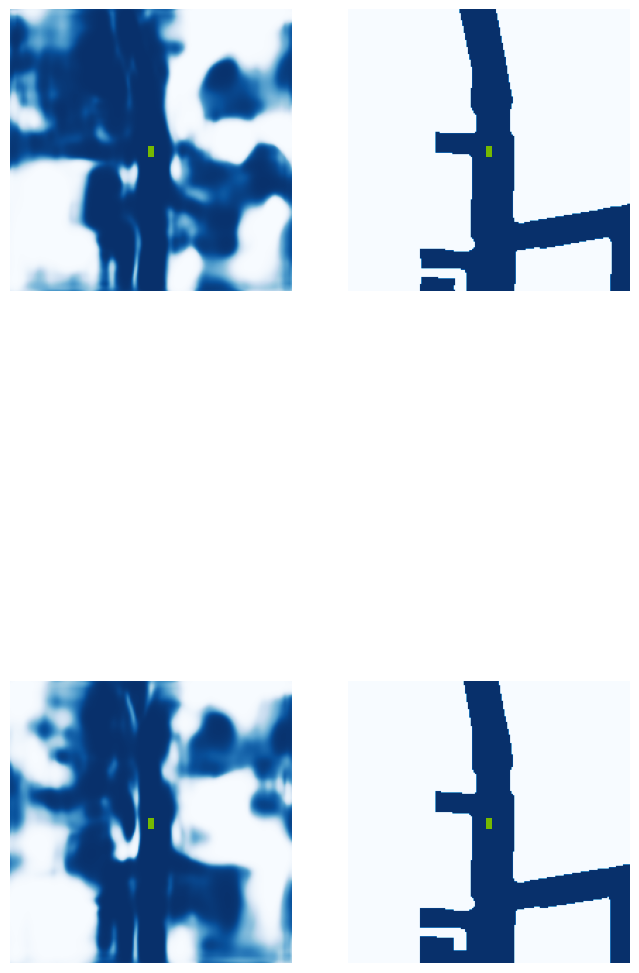

 68%|██████▊   | 27/40 [00:06<00:02,  4.78it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.30.jpg


 75%|███████▌  | 30/40 [00:07<00:01,  5.48it/s]

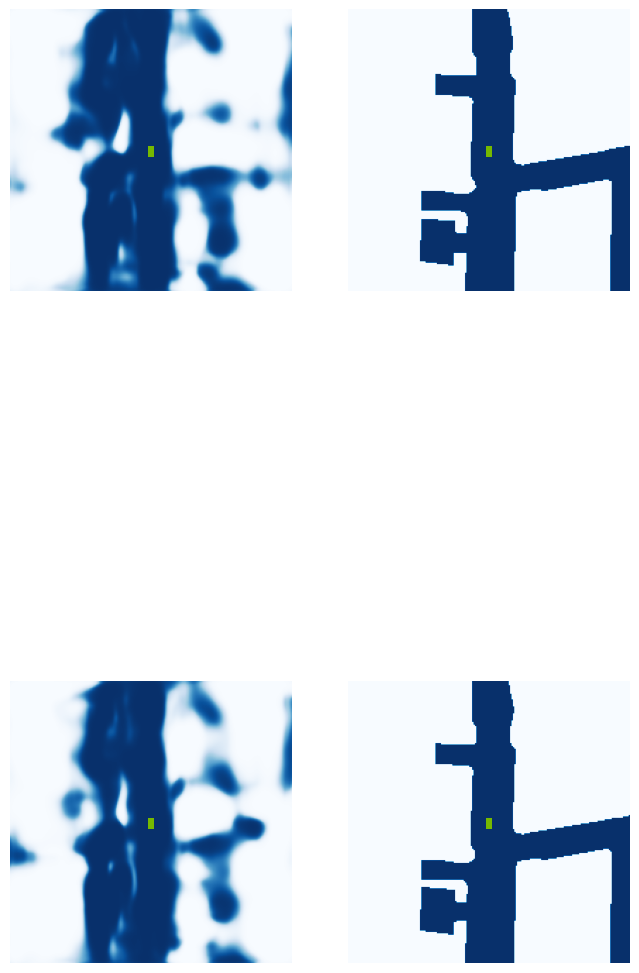

 80%|████████  | 32/40 [00:07<00:01,  4.25it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.43.jpg


 88%|████████▊ | 35/40 [00:08<00:01,  4.70it/s]

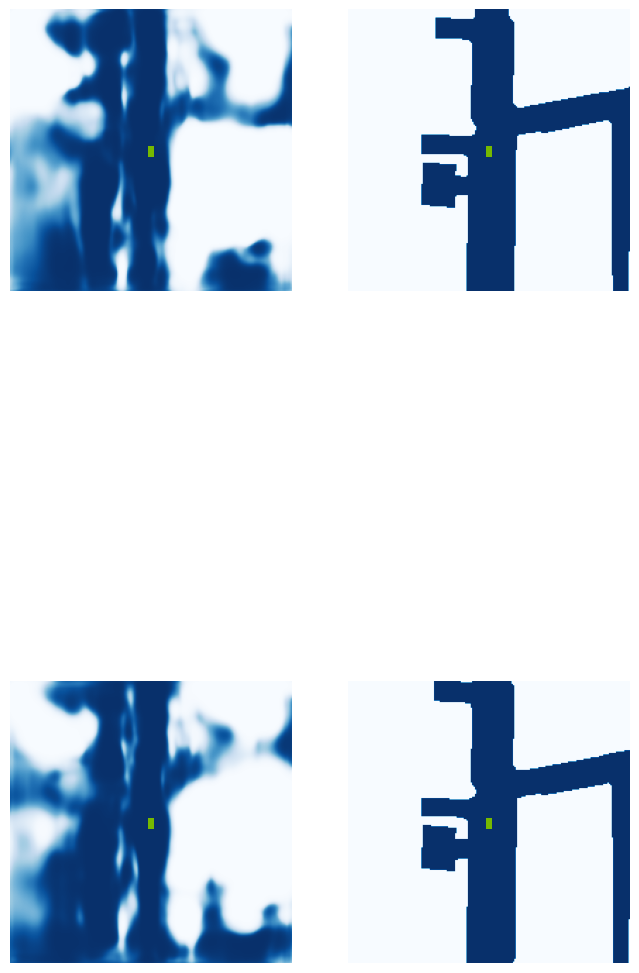

 92%|█████████▎| 37/40 [00:08<00:00,  4.38it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.33.jpg


100%|██████████| 40/40 [00:09<00:00,  4.33it/s]


VAL {'loss': 1.6499751114550931, 'iou': 0.3747222851709168}
saving ...  ./runs/model9000.pt
9010 0.10000188648700714
Epoch: 57/60
9020 0.14321137964725494
9030 0.05950506404042244
9040 0.043193213641643524
9050 0.09763526171445847
9060 0.08691802620887756
9070 0.07675627619028091
9080 0.10172803699970245
9090 0.08004626631736755
9100 0.21400238573551178
9110 0.09687159210443497
9120 0.03889240324497223
9130 0.07116976380348206
9140 0.057536814361810684
9150 0.07044999301433563
9160 0.2628771662712097
9170 0.11526869982481003
Epoch: 58/60
9180 0.12534703314304352
9190 0.09557805210351944
9200 0.10688026994466782
9210 0.08977914601564407
9220 0.049409765750169754
9230 0.06651747971773148
9240 0.1435435712337494
9250 0.11620185524225235
9260 0.0761382132768631
9270 0.10926853120326996
9280 0.12701959908008575
9290 0.149396151304245
9300 0.09282463788986206
9310 0.12323948740959167
9320 0.11352947354316711
9330 0.05508587509393692
Epoch: 59/60
9340 0.08286145329475403
9350 0.08603026717901

  0%|          | 0/40 [00:00<?, ?it/s]

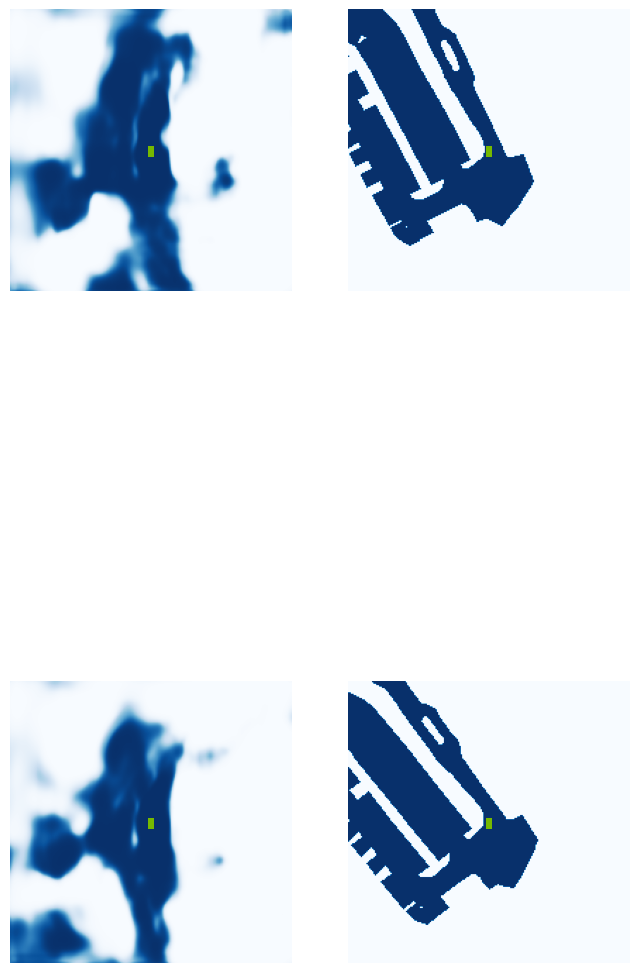

  5%|▌         | 2/40 [00:01<00:20,  1.82it/s]

Image saved! ... ./runs/get_val_info/0-iou-0.30.jpg


 12%|█▎        | 5/40 [00:01<00:07,  4.46it/s]

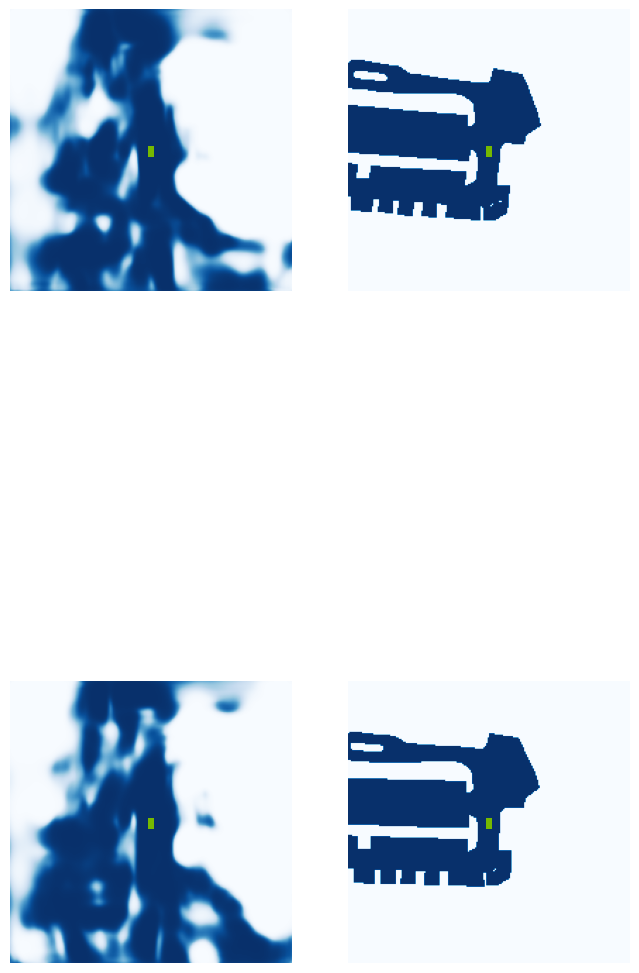

 18%|█▊        | 7/40 [00:02<00:07,  4.39it/s]

Image saved! ... ./runs/get_val_info/5-iou-0.27.jpg


 25%|██▌       | 10/40 [00:02<00:05,  5.45it/s]

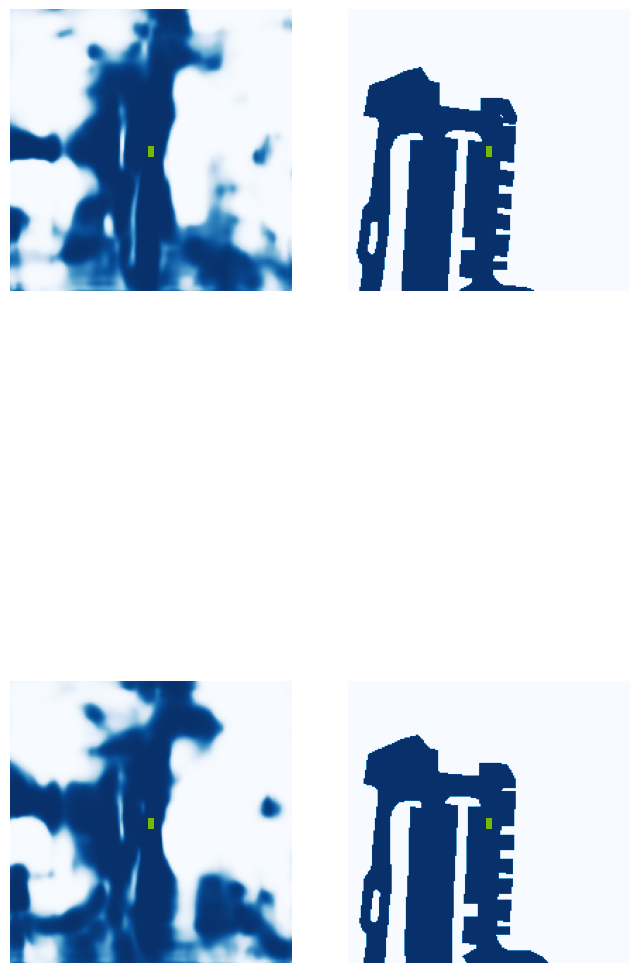

 30%|███       | 12/40 [00:03<00:07,  3.79it/s]

Image saved! ... ./runs/get_val_info/10-iou-0.39.jpg


 38%|███▊      | 15/40 [00:04<00:05,  4.28it/s]

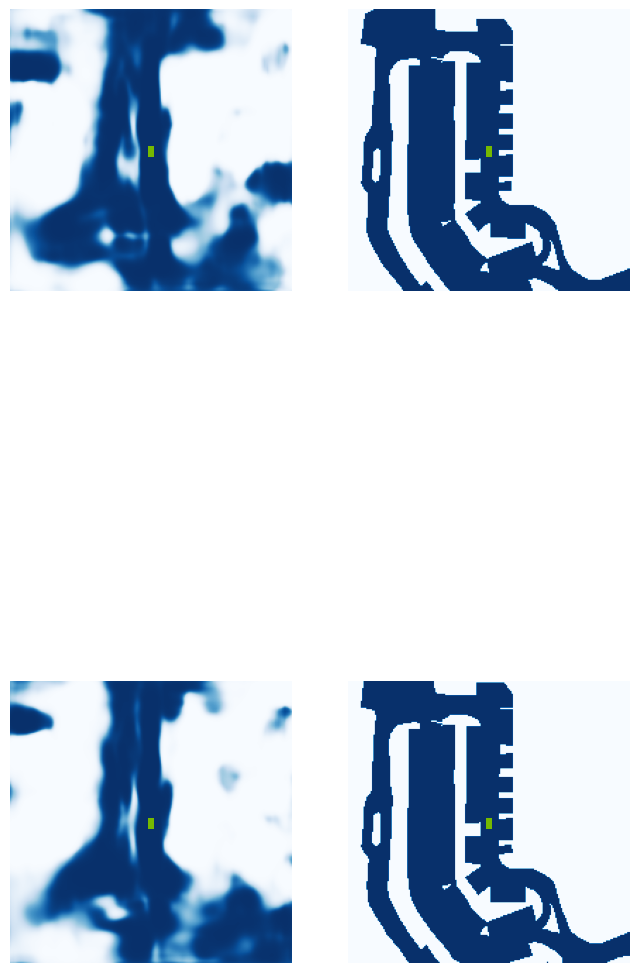

 42%|████▎     | 17/40 [00:04<00:05,  4.04it/s]

Image saved! ... ./runs/get_val_info/15-iou-0.45.jpg


 50%|█████     | 20/40 [00:05<00:04,  4.93it/s]

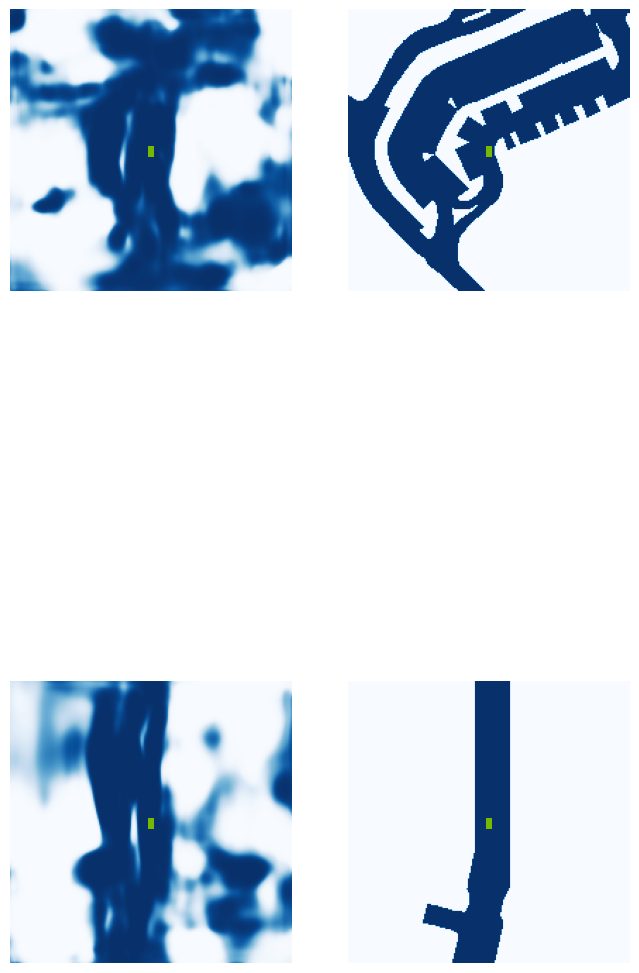

 52%|█████▎    | 21/40 [00:05<00:06,  2.96it/s]

Image saved! ... ./runs/get_val_info/20-iou-0.32.jpg


 62%|██████▎   | 25/40 [00:06<00:03,  4.64it/s]

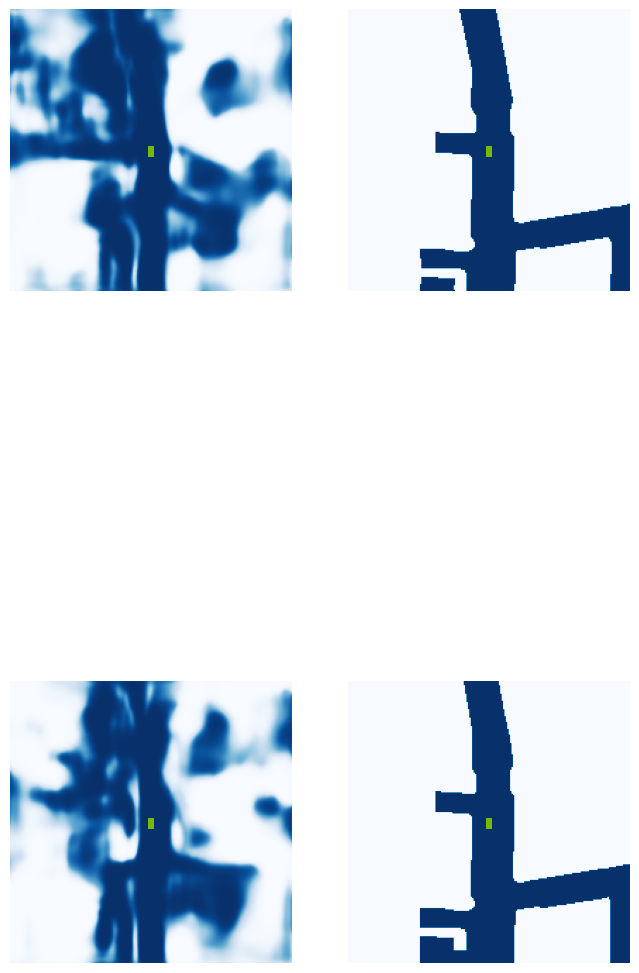

 68%|██████▊   | 27/40 [00:06<00:02,  4.50it/s]

Image saved! ... ./runs/get_val_info/25-iou-0.34.jpg


 72%|███████▎  | 29/40 [00:07<00:02,  5.05it/s]

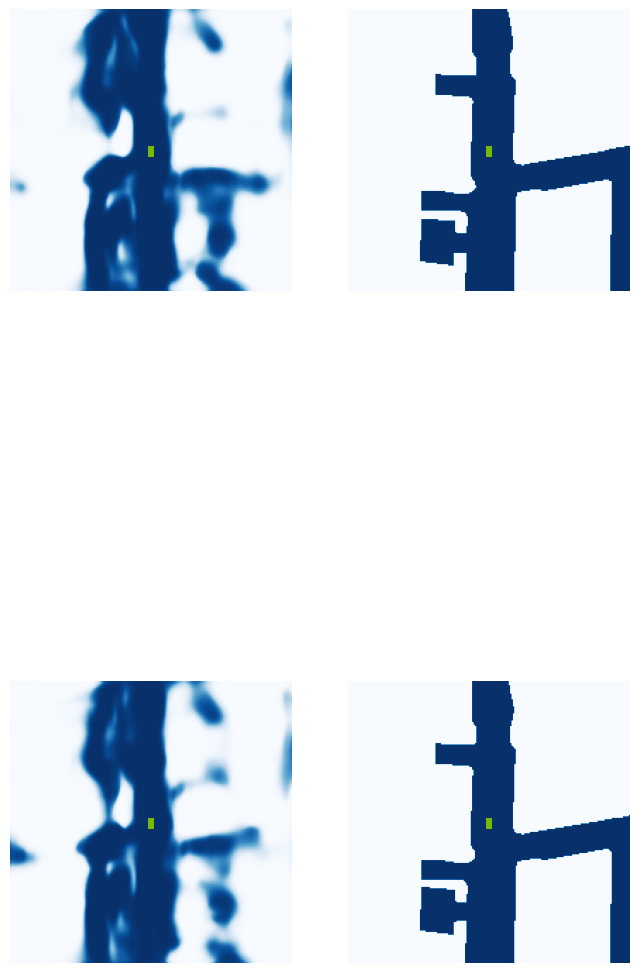

 80%|████████  | 32/40 [00:08<00:01,  4.54it/s]

Image saved! ... ./runs/get_val_info/30-iou-0.47.jpg


 88%|████████▊ | 35/40 [00:08<00:00,  5.93it/s]

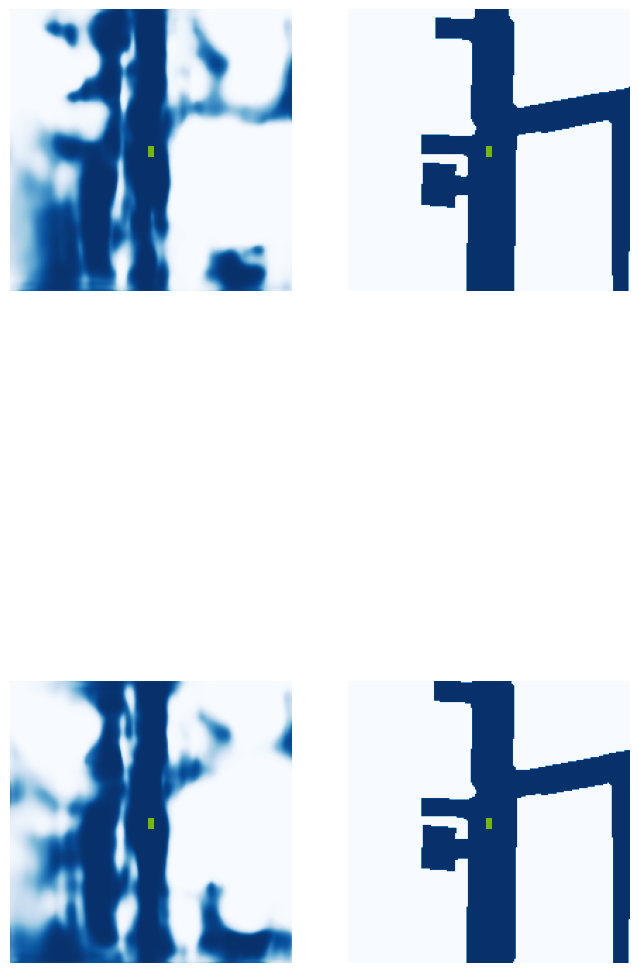

 95%|█████████▌| 38/40 [00:08<00:00,  5.81it/s]

Image saved! ... ./runs/get_val_info/35-iou-0.35.jpg


100%|██████████| 40/40 [00:09<00:00,  4.29it/s]


VAL {'loss': 1.6187761771826097, 'iou': 0.3755486568471352}
saving ...  ./runs/model9500.pt
9510 0.1882353276014328
9520 0.053684741258621216
9530 0.1215231865644455
9540 0.06821092218160629
9550 0.07385531812906265
9560 0.12952400743961334
9570 0.1381971836090088
9580 0.1557062268257141
9590 0.05085207521915436
9600 0.09384854882955551
9610 0.11099700629711151
9620 0.0718979686498642
9630 0.10043001174926758
9640 0.1296907663345337
9650 0.129131019115448
9660 0.16748473048210144


In [ ]:

#Now we want to actually call this function
train(train_label=train_label,
  version = version,
  dataroot= dataroot,
  nepochs = nepochs, #60 for full runs
  gpuid = gpuid, #since only one GPU is available and we start counting from 0
  H = H,
  W = W,
  resize_lim = resize_lim,
  final_dim = final_dim,
  bot_pct_lim = bot_pct_lim,
  rot_lim = rot_lim,
  rand_flip = rand_flip,
  ncams = ncams,
  max_grad_norm = max_grad_norm,
  pos_weight = pos_weight,
  logdir = logdir,
  xbound = xbound,
  ybound = ybound,
  zbound = zbound,
  dbound = dbound,
  decoder_mode = decoder_mode,

  bsz = bsz,
  nworkers = nworkers,
  lr = lr,
  weight_decay = weight_decay,
  num_points = num_points,
  n_points = n_points,

  max_points_voxel = max_points_voxel,
  max_voxels = max_voxels,
  input_features = input_features,
  use_norm = use_norm,
  vfe_filters = vfe_filters,
  with_distance = with_distance
      )

###Show loss and IOU statistics for train and val inline through Tensorboard

In [ ]:
%load_ext tensorboard
%tensorboard --logdir=runs

<IPython.core.display.Javascript object>

###Define helper functions for visualisations (as per "explore.py" in TF Grid)

In [ ]:
#All of the below is effectively taken from the explore.py file - want to run tests to make sure this works

import torch
import matplotlib as mpl
mpl.use('Agg')
import matplotlib.pyplot as plt
from PIL import Image
import matplotlib.patches as mpatches

#fixing relative imports - due to change made in __init__.py
from data import compile_data
from tools import (ego_to_cam, get_only_in_img_mask, denormalize_img,
                    SimpleLoss, get_val_info, add_ego, gen_dx_bx,
                    get_nusc_maps, plot_nusc_map, points_to_voxel_loop) #NB CHANGE FROM LSS CODE - NEED points_to_voxel_loop to be able to assign
                                                                        #voxels, coors, num_points to be able to pass this in forward pass of model
                                                                        #same as in train.py
from models_Dropout_resnet_pretrained import compile_model

#This is a visual check on input/output data - see Lift Splat Shoot GitHub home page
#We want to check that inputs/outputs are being parsed correctly
#passing viz_train = True allows us to see data augmentation
def lidar_check(train_label = train_label,
                version = version,
                dataroot = dataroot,
                show_lidar = show_lidar, #want to see lidar scans
                viz_train = viz_train, #set this to True to see data augmentation and visualise train data rather than val data
                nepochs=1, #SET THIS EXPLICITLY IN FUNCTION DEF - only want to train for a single epoch - just to visualise

                H = H, W = W,
                resize_lim = resize_lim,
                final_dim = final_dim,
                bot_pct_lim = bot_pct_lim,
                rot_lim = rot_lim,
                rand_flip = rand_flip,

                xbound = xbound,
                ybound = ybound,
                zbound = zbound,
                dbound = dbound,
                decoder_mode = decoder_mode, #new param to control encoder setup

                bsz = bsz,
                nworkers = nworkers,
                num_classes = num_classes,
                num_points = num_points,
                n_points = n_points,

                max_points_voxel = max_points_voxel,
                max_voxels = max_voxels,
                input_features = input_features,
                use_norm = use_norm,
                vfe_filters = vfe_filters,
                with_distance = with_distance
                ):
  #set up param dicts based on passed params
    grid_conf = {
        'xbound': xbound,
        'ybound': ybound,
        'zbound': zbound,
        'dbound': dbound,
        'decoder_mode':decoder_mode #new parameter for decoder_mode to be passed as part of grid_conf
    } #set grid_conf
    cams = ['CAM_FRONT_LEFT', 'CAM_FRONT', 'CAM_FRONT_RIGHT',
                             'CAM_BACK_LEFT', 'CAM_BACK', 'CAM_BACK_RIGHT'] #specify names of cams
    data_aug_conf = {
                    'resize_lim': resize_lim,
                    'final_dim': final_dim,
                    'rot_lim': rot_lim,
                    'H': H, 'W': W,
                    'rand_flip': rand_flip,
                    'bot_pct_lim': bot_pct_lim,
                    'cams': cams,
                    'Ncams': 5, #HERE THIS IS BASED ON LSS AND IS PASSED EXPLICITLY
                } #set up data_aug_conf - NB THE REASON FOR ONLY 5 CAMS IS THIS WAS SHOWN TO INCREASE ROBUSTNESS IN TRAINING WHEN
                  #ONE CAMERA WAS RANDONLY DROPPED

    #NB - NEED TO FIX THIS IN MY OWN EXPLORE.PY FILE - Crucial difference with LSS is we also need cfg_pp to be defined, to be passed to compile_model
    cfg_pp = {
    'num_classes':num_classes,
    'num_points': num_points,
    'pc_range': [xbound[0],ybound[0],-4,xbound[1],ybound[1],4],
    'voxel_size' : [xbound[2],ybound[2],8],
    'max_points_voxel' : max_points_voxel,
    'max_voxels': max_voxels,
    'input_features': input_features,
    'batch_size': bsz,
    'use_norm': use_norm,
    'vfe_filters': vfe_filters,
    'with_distance': with_distance,
    'n_points': n_points,
  }

    #compile the data to set up data loaders
    trainloader, valloader = compile_data(version, dataroot, data_aug_conf=data_aug_conf,
                                          grid_conf=grid_conf, bsz=bsz, nworkers=nworkers,
                                          parser_name='vizdata', cfg_pp = cfg_pp, train_label=train_label) #Note: parser can be 'vizdata' or 'segmentationdata'
                                                                 #the difference being in (see data.py) whether
                                                                 #get_lidar_data or get_point_cloud is used for the
                                                                 #lidar information - see commented data.py file for the difference
                                                                 #NB DON'T FORGET TO INCLUDE TRAIN_LABEL AND CFG_PP - THESE ARE NOT IN LSS

    loader = trainloader if viz_train else valloader #viz_train effectively selects which data loader to use

    model = compile_model(grid_conf, data_aug_conf, outC=1, cfg_pp=cfg_pp) #compile the model - need cfg_pp here - unlike LSS

    rat = H / W #set up parameters for outputting visualisations
    val = 10.1
    fig = plt.figure(figsize=(val + val/3*2*rat*3, val/3*2*rat))
    gs = mpl.gridspec.GridSpec(2, 6, width_ratios=(1, 1, 1, 2*rat, 2*rat, 2*rat))
    gs.update(wspace=0.0, hspace=0.0, left=0.0, right=1.0, top=1.0, bottom=0.0)

    for epoch in range(nepochs): #want to just run the model for a small number of epochs - nepochs = 1 above
        for batchi, (imgs, rots, trans, intrins, post_rots, post_trans, pts, binimgs) in enumerate(loader):

            img_pts = model.get_geometry(rots, trans, intrins, post_rots, post_trans)
            #for every batch we want to get the image points and plot them
            for si in range(imgs.shape[0]):
                plt.clf()
                final_ax = plt.subplot(gs[:, 5:6])
                for imgi, img in enumerate(imgs[si]):
                    ego_pts = ego_to_cam(pts[si], rots[si, imgi], trans[si, imgi], intrins[si, imgi])
                    mask = get_only_in_img_mask(ego_pts, H, W)
                    plot_pts = post_rots[si, imgi].matmul(ego_pts) + post_trans[si, imgi].unsqueeze(1)

                    ax = plt.subplot(gs[imgi // 3, imgi % 3])
                    showimg = denormalize_img(img)
                    plt.imshow(showimg)
                    if show_lidar: #also gets lidar points
                        plt.scatter(plot_pts[0, mask], plot_pts[1, mask], c=ego_pts[2, mask],
                                s=5, alpha=0.1, cmap='jet')
                    # plot_pts = post_rots[si, imgi].matmul(img_pts[si, imgi].view(-1, 3).t()) + post_trans[si, imgi].unsqueeze(1)
                    # plt.scatter(img_pts[:, :, :, 0].view(-1), img_pts[:, :, :, 1].view(-1), s=1)
                    plt.axis('off')

                    plt.sca(final_ax)
                    plt.plot(img_pts[si, imgi, :, :, :, 0].view(-1), img_pts[si, imgi, :, :, :, 1].view(-1), '.', label=cams[imgi].replace('_', ' '))

                plt.legend(loc='upper right')
                final_ax.set_aspect('equal')
                plt.xlim((-50, 50))
                plt.ylim((-50, 50))

                ax = plt.subplot(gs[:, 3:4])
                plt.scatter(pts[si, 0], pts[si, 1], c=pts[si, 2], vmin=-5, vmax=5, s=5)
                plt.xlim((-50, 50))
                plt.ylim((-50, 50))
                ax.set_aspect('equal')

                ax = plt.subplot(gs[:, 4:5])
                plt.imshow(binimgs[si].squeeze(0).T, origin='lower', cmap='Greys', vmin=0, vmax=1) #displays output

                imname = f'lcheck{epoch:03}_{batchi:05}_{si:02}.jpg'
                print('saving', imname)
                plt.savefig(imname) #saves output display to a file for that particular epoch and batch

#As far as I understand this is just a check to make sure that the result of autograd with and without
#the cumulative sum trick, match so that we can check that the cumsum trick is working properly
def cumsum_check(train_label = train_label,
                version = version,
                dataroot = dataroot,
                gpuid = gpuid,

                H = H, W = W,
                resize_lim = resize_lim,
                final_dim = final_dim,
                bot_pct_lim = bot_pct_lim,
                rot_lim = rot_lim,
                rand_flip = rand_flip,

                xbound = xbound,
                ybound = ybound,
                zbound = zbound,
                dbound = dbound,
                decoder_mode = decoder_mode,

                bsz = bsz,
                nworkers = nworkers,

                num_classes = num_classes,
                num_points = num_points,
                n_points = n_points,

                max_points_voxel = max_points_voxel,
                max_voxels = max_voxels,
                input_features = input_features,
                use_norm = use_norm,
                vfe_filters = vfe_filters,
                with_distance = with_distance
                ):
    #set up dicts based on above param values
    grid_conf = {
        'xbound': xbound,
        'ybound': ybound,
        'zbound': zbound,
        'dbound': dbound,
        'decoder_mode':decoder_mode #new parameter for decoder_mode to be passed as part of grid_conf
    }
    data_aug_conf = {
                    'resize_lim': resize_lim,
                    'final_dim': final_dim,
                    'rot_lim': rot_lim,
                    'H': H, 'W': W,
                    'rand_flip': rand_flip,
                    'bot_pct_lim': bot_pct_lim,
                    'cams': ['CAM_FRONT_LEFT', 'CAM_FRONT', 'CAM_FRONT_RIGHT',
                             'CAM_BACK_LEFT', 'CAM_BACK', 'CAM_BACK_RIGHT'],
                    'Ncams': 5, #THIS IS SET EXPLICITLY HERE BASED ON Lift Splat Shoot
                }
    #need cfg_pp to pass as an argument to compile_data - don't have this in LSS as it doesn't use PointPillars config
    cfg_pp = {
    'num_classes':num_classes,
    'num_points': num_points,
    'pc_range': [xbound[0],ybound[0],-4,xbound[1],ybound[1],4],
    'voxel_size' : [xbound[2],ybound[2],8],
    'max_points_voxel' : max_points_voxel,
    'max_voxels': max_voxels,
    'input_features': input_features,
    'batch_size': bsz,
    'use_norm': use_norm,
    'vfe_filters': vfe_filters,
    'with_distance': with_distance,
    'n_points': n_points,
  }
    #compile the data - with segmentation data
    trainloader, valloader = compile_data(version, dataroot, data_aug_conf=data_aug_conf,
                                          grid_conf=grid_conf, bsz=bsz, nworkers=nworkers,
                                          parser_name='segmentationdata', cfg_pp=cfg_pp, train_label=train_label) #other default arguments defined from data.py - but we need
                                                                                                                  #cfg_pp and train_label

    device = torch.device('cpu') if gpuid < 0 else torch.device(f'cuda:{gpuid}')
    loader = trainloader #want to load training data

    model = compile_model(grid_conf, data_aug_conf, outC=1, cfg_pp=cfg_pp) #compile the model - need cfg_pp here
    model.to(device)

    model.eval()
    #effectively just run for a single epoch - we only want to do a backward pass and check autograd matches
    for batchi, (imgs, rots, trans, intrins, post_rots, post_trans, binimgs, points) in enumerate(loader):

        model.use_quickcumsum = False #this is without using quickcumsum - see model.py for how it handles when use_quickcumsum=False
        model.zero_grad()
        #NB - NOTE - IN ORDER TO ACTUALLY RUN THE FORWARD PASS OF OUR MODEL WE NEED voxels, coors and num_points
        #and these come from points_to_voxel_loop - see train.py - there it calls this to get these assigned before then passing these to actually do a forward pass of the model
        voxels, coors, num_points = points_to_voxel_loop(points, cfg_pp)

        out = model(imgs.to(device),
                rots.to(device),
                trans.to(device),
                intrins.to(device),
                post_rots.to(device),
                post_trans.to(device),
                voxels.to(device), #need voxels, coors and num_points - different to LSS code
                coors.to(device),
                num_points.to(device)
                )
        out.mean().backward()
        print('autograd:    ', out.mean().detach().item(), model.camencode.depthnet.weight.grad.mean().item())

        model.use_quickcumsum = True #this is with using quickcumsum - see model.py for how it handles when use_quickcumsum=True
        model.zero_grad()
        out = model(imgs.to(device),
                rots.to(device),
                trans.to(device),
                intrins.to(device),
                post_rots.to(device),
                post_trans.to(device),
                voxels.to(device), #need voxels, coors and num_points - different to LSS code
                coors.to(device),
                num_points.to(device)
                )
        out.mean().backward()
        print('quick cumsum:', out.mean().detach().item(), model.camencode.depthnet.weight.grad.mean().item())
        print()
        #Ultimately from the print statements we can compare if cumsum trick is working as expected or not

#NB THIS IS WHAT WE WANT TO GET OUT THE ACTUAL IOU PERFORMANCE OF THE MODEL ON VALIDATION DATA USING A FITTED MODEL
def eval_model_iou(modelf, #NB WILL NEED TO SPECIFY A MODEL_LOCATION WHERE THE TRAINED MODEL IS SAVED - THEN USE THIS TO EVALUATE
                        #Note: See the last part of train.py - it will tell your the MODEL_LOCATION based on mname where it saves
                        #a state_dict of the model after the count%val_step == 0 - take the latest model saved and use that when passing
                        #eval_model_iou  - ultimately based on get_val_info
                        #this is the validation info only for the same class as trained on
                        #will also need to edit get_val_info for where the images resulting from plot_bev are being saved version = "mini",
                        #NB Note - non-default arguments need to precede default arguments
                version = version,
                dataroot = dataroot,
                gpuid = gpuid,

                H = H, W = W,
                resize_lim = resize_lim,
                final_dim = final_dim,
                bot_pct_lim = bot_pct_lim,
                rot_lim = rot_lim,
                rand_flip = rand_flip,

                xbound = xbound,
                ybound = ybound,
                zbound = zbound,
                dbound = dbound,
                decoder_mode = decoder_mode, #new param to control decoder setup

                bsz = bsz,
                nworkers = nworkers,

                num_classes = num_classes,
                num_points = num_points,
                n_points = n_points, #trainval avg 34720  , mini avg 34718

                max_points_voxel = max_points_voxel,
                max_voxels = max_voxels,
                input_features = input_features,
                use_norm = use_norm,
                vfe_filters = vfe_filters,
                with_distance = with_distance
                ):
    grid_conf = {
        'xbound': xbound,
        'ybound': ybound,
        'zbound': zbound,
        'dbound': dbound,
        'decoder_mode':decoder_mode #new parameter for decoder_mode to be passed as part of grid_conf
    }
    data_aug_conf = {
                    'resize_lim': resize_lim,
                    'final_dim': final_dim,
                    'rot_lim': rot_lim,
                    'H': H, 'W': W,
                    'rand_flip': rand_flip,
                    'bot_pct_lim': bot_pct_lim,
                    'cams': ['CAM_FRONT_LEFT', 'CAM_FRONT', 'CAM_FRONT_RIGHT',
                             'CAM_BACK_LEFT', 'CAM_BACK', 'CAM_BACK_RIGHT'],
                    'Ncams': 5, #THIS IS PASSED EXPLICITLY HERE
                }
    #need cfg_pp to pass as an argument to compile_data - don't have this in LSS as it doesn't use PointPillars config
    cfg_pp = {
    'num_classes':num_classes,
    'num_points': num_points,
    'pc_range': [xbound[0],ybound[0],-4,xbound[1],ybound[1],4],
    'voxel_size' : [xbound[2],ybound[2],8],
    'max_points_voxel' : max_points_voxel,
    'max_voxels': max_voxels,
    'input_features': input_features,
    'batch_size': bsz,
    'use_norm': use_norm,
    'vfe_filters': vfe_filters,
    'with_distance': with_distance,
    'n_points': n_points,
  }
    trainloader, valloader = compile_data(version, dataroot, data_aug_conf=data_aug_conf,
                                          grid_conf=grid_conf, bsz=bsz, nworkers=nworkers,
                                          parser_name='segmentationdata', cfg_pp=cfg_pp, train_label = train_label) #all other default params passed from data.py but we need cfg_pp and
                                                                                                                    #train_label - unlike LSS code

    device = torch.device('cpu') if gpuid < 0 else torch.device(f'cuda:{gpuid}')

    model = compile_model(grid_conf, data_aug_conf, outC=1, cfg_pp = cfg_pp) #compile model - need cfg_pp unlike LSS
    print('loading', modelf)
    #within modelf there are keys - epoch, model_state_dict, optimizer_state_dict, loss and counter
    #we can't just load the entire state_dict we want to be specific and look at only model_state_dict
    model.load_state_dict(torch.load(modelf)['model_state_dict'])
    model.to(device)

    loss_fn = SimpleLoss(1.0).cuda(gpuid)

    model.eval()
    val_info = get_val_info(model, valloader, loss_fn, device, cfg_pp = cfg_pp, grid_conf=grid_conf) #ultimate output is a dict of loss and iou across all batches
                                                               #plus images stored in a folder (to be set) with the outputs of
                                                               #plot_bev
                                                               #NB - NOTE - the way it is defined in tools.py it requires a cfg argument - really this is cfg_pp - as it gets
                                                               #passed to points_to_voxel_loop to get voxels, coors, num_points etc
    print(val_info)


def viz_model_preds(modelf, #this is to be a file path to a fitted model
                    version = version,
                    dataroot= dataroot,
                    map_folder = map_folder, #sets the folder where maps are to be found
                    img_save = img_save_dir, # Need to pass a directory I actually have access to
                    gpuid = gpuid,#start counting from 0 when using just one GPU
                    viz_train = viz_train,

                    H = H, W = W,
                    resize_lim = resize_lim,
                    final_dim = final_dim,
                    bot_pct_lim = bot_pct_lim,
                    rot_lim = rot_lim,
                    rand_flip = rand_flip,

                    xbound = xbound,
                    ybound = ybound,
                    zbound = zbound,
                    dbound = dbound,
                    decoder_mode = decoder_mode,#new param to control encoder setup

                    bsz = bsz,
                    nworkers = nworkers,

                    num_classes = num_classes, #NEED TO PUT THIS IN HERE AS IT ISN'T COMING FROM THE CONFIG FILE
                    num_points = num_points,
                    n_points = n_points, #trainval avg 34720  , mini avg 34718

                    max_points_voxel = max_points_voxel,
                    max_voxels = max_voxels,
                    input_features = input_features,
                    use_norm = use_norm,
                    vfe_filters = vfe_filters,
                    with_distance = with_distance
                    ):
    #set dicts for passed params
    grid_conf = {
        'xbound': xbound,
        'ybound': ybound,
        'zbound': zbound,
        'dbound': dbound,
        'decoder_mode':decoder_mode #new parameter for decoder_mode to be passed as part of grid_conf
    }
    cams = ['CAM_FRONT_LEFT', 'CAM_FRONT', 'CAM_FRONT_RIGHT',
            'CAM_BACK_LEFT', 'CAM_BACK', 'CAM_BACK_RIGHT']
    data_aug_conf = {
                    'resize_lim': resize_lim,
                    'final_dim': final_dim,
                    'rot_lim': rot_lim,
                    'H': H, 'W': W,
                    'rand_flip': rand_flip,
                    'bot_pct_lim': bot_pct_lim,
                    'cams': cams,
                    'Ncams': 5, #THIS IS PASSED EXPLICITLY - based on Lift Splat Shoot
                }
    #need cfg_pp to pass as an argument to compile_data - don't have this in LSS as it doesn't use PointPillars config
    cfg_pp = {
    'num_classes':num_classes,
    'num_points': num_points,
    'pc_range': [xbound[0],ybound[0],-4,xbound[1],ybound[1],4],
    'voxel_size' : [xbound[2],ybound[2],8],
    'max_points_voxel' : max_points_voxel,
    'max_voxels': max_voxels,
    'input_features': input_features,
    'batch_size': bsz,
    'use_norm': use_norm,
    'vfe_filters': vfe_filters,
    'with_distance': with_distance,
    'n_points': n_points,
  }
    #compile data
    trainloader, valloader = compile_data(version, dataroot, data_aug_conf=data_aug_conf,
                                          grid_conf=grid_conf, bsz=bsz, nworkers=nworkers,
                                          parser_name='segmentationdata', cfg_pp = cfg_pp, train_label=train_label) #need cfg_pp and train_label all rest default from data.py
    loader = trainloader if viz_train else valloader #decide whether visualising train or val data
    nusc_maps = get_nusc_maps(map_folder) #NEED TO DOUBLE CHECK WHAT THIS FUNCTION DOES AND WHAT IT RETURNS - Should generally get the maps

    device = torch.device('cpu') if gpuid < 0 else torch.device(f'cuda:{gpuid}')

    model = compile_model(grid_conf, data_aug_conf, outC=1,cfg_pp = cfg_pp) #compile the model - need cfg_pp here - unlike LSS
    print('loading', modelf)
    print('device: ',device) ###
    #Want to generally load a fitted model
    #within modelf there are keys - epoch, model_state_dict, optimizer_state_dict, loss and counter
    #we can't just load the entire state_dict we want to be specific and look at only model_state_dict
    model.load_state_dict(torch.load(modelf)['model_state_dict'])####,map_location=device
    model.to(device)

    dx, bx, _ = gen_dx_bx(grid_conf['xbound'], grid_conf['ybound'], grid_conf['zbound'])
    dx, bx = dx[:2].numpy(), bx[:2].numpy()

    scene2map = {}
    for rec in loader.dataset.nusc.scene:
        log = loader.dataset.nusc.get('log', rec['log_token'])
        scene2map[rec['name']] = log['location']

    #this is for setting up plotting
    val = 0.01
    fH, fW = final_dim
    fig = plt.figure(figsize=(3*fW*val, (1.5*fW + 2*fH)*val))
    gs = mpl.gridspec.GridSpec(3, 3, height_ratios=(1.5*fW, fH, fH))
    gs.update(wspace=0.0, hspace=0.0, left=0.0, right=1.0, top=1.0, bottom=0.0)

    model.eval() #switch model to eval mode
    counter = 0
    with torch.no_grad():
        for batchi, (imgs, rots, trans, intrins, post_rots, post_trans, binimgs, points) in enumerate(loader): #need points also
            voxels, coors, num_points = points_to_voxel_loop(points, cfg_pp) #need voxels, coors and num_points to run forward pass on model

            out = model(imgs.to(device),
                    rots.to(device),
                    trans.to(device),
                    intrins.to(device),
                    post_rots.to(device),
                    post_trans.to(device),
                    voxels.to(device), #need voxels, coors and num_points - different to LSS code
                    coors.to(device),
                    num_points.to(device)
                    )
            out = out.sigmoid().cpu() #### why applies sigmoid to output???


            for si in range(imgs.shape[0]):
                plt.clf()
                for imgi, img in enumerate(imgs[si]):
                    ax = plt.subplot(gs[1 + imgi // 3, imgi % 3])
                    showimg = denormalize_img(img)
                    # flip the bottom images
                    if imgi > 2:
                        showimg = showimg.transpose(Image.FLIP_LEFT_RIGHT)
                    plt.imshow(showimg)
                    plt.axis('off')
                    plt.annotate(cams[imgi].replace('_', ' '), (0.01, 0.92), xycoords='axes fraction')

                ax = plt.subplot(gs[0, :])
                ax.get_xaxis().set_ticks([])
                ax.get_yaxis().set_ticks([])
                plt.setp(ax.spines.values(), color='b', linewidth=2)
                plt.legend(handles=[
                    mpatches.Patch(color=(0.0, 0.0, 1.0, 1.0), label='Output Vehicle Segmentation'),
                    mpatches.Patch(color='#76b900', label='Ego Vehicle'),
                    mpatches.Patch(color=(1.00, 0.50, 0.31, 0.8), label='Map (for visualization purposes only)')
                ], loc=(0.01, 0.86))
                plt.imshow(out[si].squeeze(0), vmin=0, vmax=1, cmap='Blues')

                # plot static map (improves visualization)
                rec = loader.dataset.ixes[counter]
                plot_nusc_map(rec, nusc_maps, loader.dataset.nusc, scene2map, dx, bx)
                plt.xlim((out.shape[3], 0))
                plt.ylim((0, out.shape[3]))
                add_ego(bx, dx)

                imname = f'eval{batchi:06}_{si:03}.jpg'
                print('saving', imname)
                plt.savefig(img_save + imname) #saves all these figures named based on batch number and enumerated image number
                counter += 1


###Call eval_model_iou() to get IOU and loss

In [ ]:
eval_model_iou(modelf = os.path.join(logdir, "model9500.pt"),
                version = version,
                dataroot = dataroot,
                gpuid = gpuid, #only 1 gpu on Colab

                H = H, W = W,
                resize_lim = resize_lim,
                final_dim = final_dim,
                bot_pct_lim = bot_pct_lim,
                rot_lim = rot_lim,
                rand_flip = rand_flip,

                xbound = xbound,
                ybound = ybound,
                zbound = zbound,
                dbound = dbound,
                decoder_mode = decoder_mode, #new param to control encoder setup

                bsz = bsz,
                nworkers = nworkers,

                num_classes = num_classes,
                num_points = num_points,

                n_points = n_points, #trainval avg 34720  , mini avg 34718
                max_points_voxel = max_points_voxel,
                max_voxels = max_voxels,
                input_features = input_features,
                use_norm = use_norm,
                vfe_filters = vfe_filters,
                with_distance = with_distance
                )


Getting all samples
Getting all samples
xs shape:  torch.Size([41, 8, 22])
ys shape:  torch.Size([41, 8, 22])
Loaded pretrained weights for efficientnet-b0


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weig

loading ./runs/model9500.pt
running eval...
Image saved! ... ./runs/get_val_info/0-iou-0.30.jpg
Image saved! ... ./runs/get_val_info/5-iou-0.27.jpg
Image saved! ... ./runs/get_val_info/10-iou-0.39.jpg
Image saved! ... ./runs/get_val_info/15-iou-0.45.jpg
Image saved! ... ./runs/get_val_info/20-iou-0.32.jpg
Image saved! ... ./runs/get_val_info/25-iou-0.34.jpg
Image saved! ... ./runs/get_val_info/30-iou-0.47.jpg
Image saved! ... ./runs/get_val_info/35-iou-0.35.jpg
{'loss': 1.1602319523140237, 'iou': 0.3755486568471352}


###Call viz_model_preds() to visualise output predictions

In [ ]:
#call viz_model_preds - to actually try to visualise outputs of model as a BEV map
viz_model_preds(modelf = os.path.join(logdir, "model9500.pt"), #file path to a fitted model - to get the actual model state_dict will need to access ['model_state_dict'] of this
                    version = version,
                    dataroot = dataroot,
                    map_folder = map_folder, #sets the folder where maps are to be found - NB get_nusc_maps will append maps/expansions/... to get relevant file
                    img_save = img_save_dir, #Chnaged this to a directory I have access to - save output in same place as all other run related output
                    gpuid = gpuid,
                    viz_train = viz_train,

                    H = H, W = W,
                    resize_lim = resize_lim,
                    final_dim = final_dim,
                    bot_pct_lim = bot_pct_lim,
                    rot_lim = rot_lim,
                    rand_flip = rand_flip,

                    xbound = xbound,
                    ybound = ybound,
                    zbound = zbound,
                    dbound = dbound,
                    decoder_mode = decoder_mode, #new param to control encoder setup

                    bsz = bsz,
                    nworkers = nworkers,

                    num_classes = num_classes,
                    num_points = num_points,

                    n_points = n_points, #trainval avg 34720  , mini avg 34718
                    max_points_voxel = max_points_voxel,
                    max_voxels = max_voxels,
                    input_features = input_features,
                    use_norm = use_norm,
                    vfe_filters = vfe_filters,
                    with_distance = with_distance
)

Getting all samples
Getting all samples
xs shape:  torch.Size([41, 8, 22])
ys shape:  torch.Size([41, 8, 22])
Loaded pretrained weights for efficientnet-b0
loading ./runs/model9500.pt
device:  cuda:0
saving eval000000_000.jpg
saving eval000000_001.jpg
saving eval000001_000.jpg
saving eval000001_001.jpg
saving eval000002_000.jpg
saving eval000002_001.jpg
saving eval000003_000.jpg
saving eval000003_001.jpg
saving eval000004_000.jpg
saving eval000004_001.jpg
saving eval000005_000.jpg
saving eval000005_001.jpg
saving eval000006_000.jpg
saving eval000006_001.jpg
saving eval000007_000.jpg
saving eval000007_001.jpg
saving eval000008_000.jpg
saving eval000008_001.jpg
saving eval000009_000.jpg
saving eval000009_001.jpg
saving eval000010_000.jpg
saving eval000010_001.jpg
saving eval000011_000.jpg
saving eval000011_001.jpg
saving eval000012_000.jpg
saving eval000012_001.jpg
saving eval000013_000.jpg
saving eval000013_001.jpg
saving eval000014_000.jpg
saving eval000014_001.jpg
saving eval000015_00

###Make a gif out of images produced by viz_model_preds()

In [ ]:
import glob
from PIL import Image
def make_gif(frame_folder, train_label, decoder_mode):
    frames = [Image.open(image) for image in glob.glob(f"{frame_folder}/*.jpg")]
    frame_one = frames[0]
    frame_one.save(f"model_preds_visualisation_{train_label}_DM:{decoder_mode}.gif", format="GIF", append_images=frames,
               save_all=True, duration=100, loop=0)

#Call function
make_gif(frame_folder = img_save_dir, train_label = train_label, decoder_mode = decoder_mode)